# HW5 GAMENet

In this question, we will implement GAMENet proposed by Junyuan Shang et al. in the paper [GAMENet: Graph Augmented MEmory Networks for Recommending Medication Combination](https://ojs.aaai.org//index.php/AAAI/article/view/3905).

---

In [1]:
import os
import dill
import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import math

In [2]:
# set seed
seed = 1234
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
os.environ["PYTHONHASHSEED"] = str(seed)

In [3]:
DATA_PATH = "../HW5-GAMENet-lib/data/"

assert os.path.isdir(DATA_PATH)

----

GAMENet is a memory network, which uses external memory components to assist the deep neural networks in remembering and storing information.

At a high level, a memory network consists of the following four steps:

- **Input feature map (I)** converts the incoming input to the internal feature representation.
- **Generalization (G)** component updates old memories given new input.
- **Output feature map (O)** produces a new output in the feature representation space, given the new input and the current memory state.
- **Response component (R)** converts the output into the response format desired.

We will decompose and implement module by module

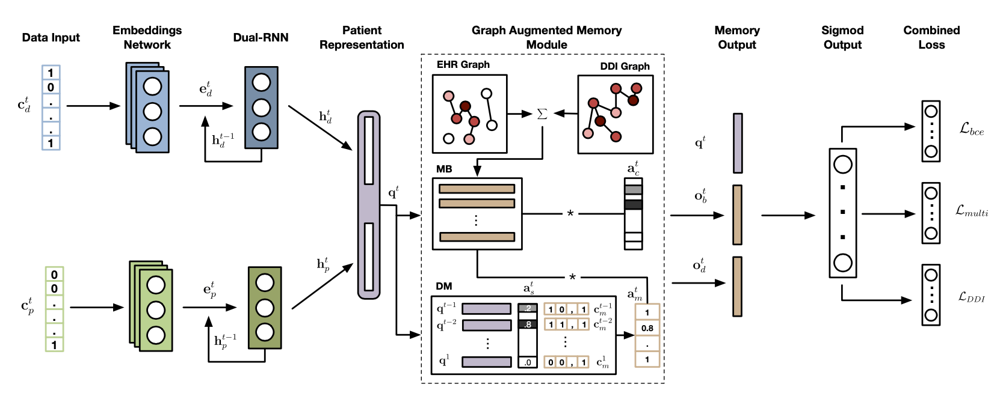

**Step1:** Data Loader. The input of the model is the multi-hot diagnosis and procedure codes. Before running the model, we should prepare the well-formatted diagnosis, procedure and medication data

**Step2:** The diagnosis and procedure data pass through two RNN networks separately. The outputs of two RNNs are then concatenated as the patient representation.

**Step3 (I):** The input of the memory network is transformed from the patient representation (by a fully connected neural network)

**Step4 (G):** Generate/update the graph memory bank (MB) and the dynamic memory table (DM)

**Step5 (O):** Read from the graph memory bank (MB) and the dynamic memory table (DM), and generate the output of the memory network

**Step6 (R):** Convert the output and predict the final results

## Step1: Data Loader [5 points]

In [4]:
data = dill.load(open(f'{DATA_PATH}/records_final.pkl', 'rb'))

##### The loaded Data Format 

The variable "data" is a list object, each entry is the information of one single patient
- data = [patient1, patient2, patient3, ...]

Each patient object is itself a list, enumerating each clinical visit. The length of a patient object is equal to the number of visits. Thus, each patient will have different lengths.
- patienti = [visit1, visit2, visit3, ...]

Each visit object is itself a list with three entries: diagnosis codes, procedure codes and medication codes.
- visiti = [diag_code, prod_code, med_code]

Three entries are themselves lists, enumerating the corresponding code indices in order. For example, for the first visit of the first patient, we have
- diagnosis: data[0][0][0] = [0, 1, 2, 3, 4, 5, 6, 7]
- procedure: data[0][0][1] = [0, 1, 2]
- medication: data[0][0][2] = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

In [5]:
"""
TODO: count the vocabulary size (total types) of diag / prod / med code
"""

vocab_diag = None
vocab_prod = None
vocab_med = None


# your code here
vocab_diag_set = set()
vocab_prod_set = set()
vocab_med_set = set()

for i in data:
    for j in i:
        for k in j[0]:
            vocab_diag_set.add(k)
        for p in j[1]:
            vocab_prod_set.add(p)
        for m in j[2]:
            vocab_med_set.add(m)

vocab_diag = len(vocab_diag_set)
vocab_prod = len(vocab_prod_set)
vocab_med = len(vocab_med_set)

print(vocab_diag)
print(vocab_prod)
print(vocab_med)
# raise NotImplementedError

1958
1430
131


In [6]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''

assert vocab_diag == 1958, "vocabulary size of diag is wrong!"



## Step2: Recurrent Neural Networks (RNN) [10 points]

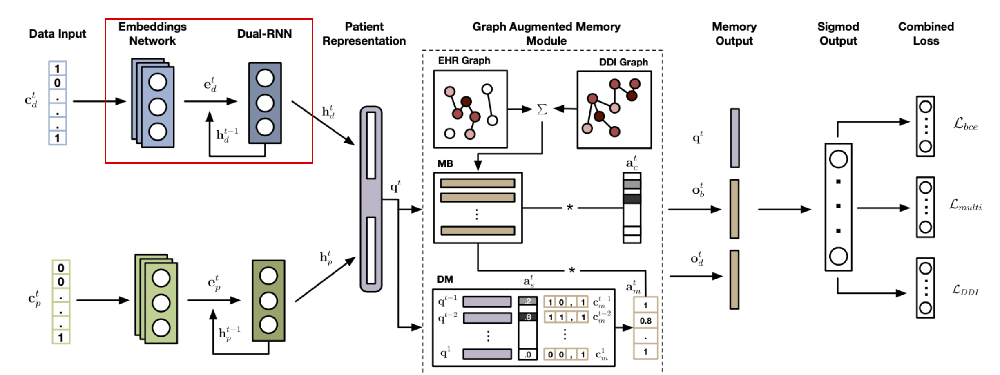

In [31]:
class RNN(nn.Module):
    def __init__(self, vocab_size, emb_dim=16):
        super(RNN, self).__init__()
        """
        FUNCTIONALITY:
            1. embed the input medical code
            2. take the average for one visit
            3. pass to the RNN visit by visit
            4. output embedding seq for each visit
        """
        
        """
        TODO:
            1. build an embedding table using nn.Embedding()
                - row size: vocab_size
                - emb size: emb_size
            2. build an GRU cell using nn.GRU()
                - input dim: emb_dim
                - output dim: emb_dim
                - remember to use batch_first=True option!
        """
        self.embeddings = None
        self.rnn = None
        # your code here
        self.embeddings = nn.Embedding(vocab_size, emb_dim)
        self.rnn = nn.GRU(emb_dim, emb_dim, batch_first=True)
#         raise NotImplementedError
        
        self.init_weights()
    
    def forward(self, codes):
        """
        Input:
            codes: [[codes for visit1], [codes for visit2], ...]
                - e.g., [[0,1], [1,2]]  
        Output:
            embedding seq
                - dim: (#visits, emb_dim) 
        """
        
        emb_list = []
        for code in codes:
            
            """
            TODO: to use the self.embeddings
            """
            emb = None
            # your code here
            emb = self.embeddings(torch.LongTensor(code))
#             raise NotImplementedError
            
            # take the mean and make one sample per batch
            emb_mean = emb.mean(dim=0).unsqueeze(dim=0)
            emb_list.append(emb_mean)
            
        emb_seq = torch.cat(emb_list, dim=0).unsqueeze(dim=0)
        print(emb_seq)
        
        """
        TODO: to use the self.rnn
        """
        result = None
        # your code here
        result, _ = self.rnn(emb_seq)
#         print(result)
#         raise NotImplementedError
        
        return result
    
    def init_weights(self):
        torch.nn.init.normal_(self.embeddings.weight)
        for param in self.rnn.parameters():
            if len(param.shape) >= 2:
                torch.nn.init.orthogonal_(param.data)
            else:
                torch.nn.init.normal_(param.data)
        

In [32]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''

torch.manual_seed(2)
rnn = RNN(vocab_diag)
test_point = rnn([[0,1], [1,2]])[0, -1, 1].data.item()
assert round(test_point, 4) == -0.6705, "RNN is wrong!"




tensor([[[-0.3827,  0.7392, -0.2838,  0.5723, -0.1277, -0.6419, -0.0879,
          -0.0115, -0.5616, -1.3268, -0.4531, -0.5870,  0.2657,  0.3306,
           2.3797, -0.9065],
         [-1.0339,  0.3965, -0.2223,  0.3501, -1.1354, -1.1507,  0.1951,
           0.3210, -0.2531,  0.0619,  0.8034, -0.0701,  0.0682, -0.6641,
           1.1641,  0.7266]]], grad_fn=<UnsqueezeBackward0>)


## Step3 (I): Patient query network [10 points]

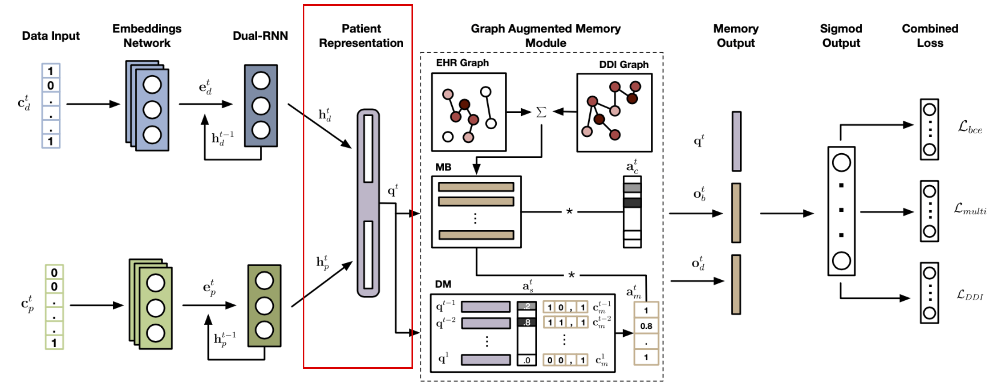

In [35]:
class PatientQuery(nn.Module):
    def __init__(self, vocab_diag, vocab_prod, emb_dim=16):
        super(PatientQuery, self).__init__()
        """
        FUNCTIONALITY:
            1. input the embedding given by RNN
            2. output the patient representation
        """
        
        """
        TODO:
            1. reuse the RNN module for diagnosis code
                - use the vocab_diag
                - assign the emb_dim
            2. reuse the RNN module for procedure code
                - use the vocab_prod
                - assign the emb_dim
            3. build a linear layer using nn.Linear
                - you will concat diag and prod embedding 
                - input size: 2 * emb_dim
                - output size: emb_dim
                - use bias=True option
        """
        self.rnn_diag = None
        self.rnn_prod = None
        self.linear = None
        # your code here
        self.rnn_diag = RNN(vocab_diag, emb_dim)
        self.rnn_prod = RNN(vocab_prod, emb_dim)
        self.linear = nn.Linear(2 * emb_dim, emb_dim, bias=True)
        
#         raise NotImplementedError
        
    def forward(self, codes_diag, codes_prod):
        """
        Input:
            codes_diag: [[diag codes for visit1], [diag codes for visit2], ...]
                - e.g., [[0,1], [1,2]]  
            codes_prod: [[prod codes for visit1], [prod codes for visit2], ...]
                - e.g., [[0,1], [1,2]]  
        output:
            query embedding:
                - size: (#visits, emd_dim)
        """
        
        """
        TODO: get diag and prod embedding by self.rnn_diag, self.rnn_prod
        """
        emb_diag = None
        emb_prod = None
        # your code here
        emb_diag = self.rnn_diag(codes_diag)
        emb_prod = self.rnn_prod(codes_prod)
        
        emb_diag = emb_diag.view(emb_diag.shape[1], emb_diag.shape[2])
        emb_prod = emb_prod.view(emb_prod.shape[1], emb_prod.shape[2])
        
#         raise NotImplementedError
        
        """
        TODO: concat emb_diag and emb_prod, then tranfrom by self.linear
        """
        emb_cat = None
        result = None
        # your code here
        emb_cat = torch.cat([emb_diag, emb_prod], dim=1)
        
        result = self.linear(emb_cat)
        print(result)
#         raise NotImplementedError
        
        return result

In [36]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''

torch.manual_seed(2)
patient = PatientQuery(vocab_diag, vocab_prod)
test_point = patient([[0,1], [1,2]], [[0,1], [1,2]])[-1, 1].data.item()
assert round(test_point, 4) == -0.5250, "PatientQuery is wrong!"



tensor([[[-0.3827,  0.7392, -0.2838,  0.5723, -0.1277, -0.6419, -0.0879,
          -0.0115, -0.5616, -1.3268, -0.4531, -0.5870,  0.2657,  0.3306,
           2.3797, -0.9065],
         [-1.0339,  0.3965, -0.2223,  0.3501, -1.1354, -1.1507,  0.1951,
           0.3210, -0.2531,  0.0619,  0.8034, -0.0701,  0.0682, -0.6641,
           1.1641,  0.7266]]], grad_fn=<UnsqueezeBackward0>)
tensor([[[-0.3105,  1.0748,  0.2924,  0.3799, -0.1273, -0.8999, -0.4424,
          -1.1792,  0.3945,  1.4281,  0.0784,  0.7208,  0.2886,  0.5192,
           0.0219, -0.9008],
         [ 0.2100,  0.7193,  1.3440, -0.2322, -1.1352, -0.7515, -0.0176,
          -1.3340,  0.4156,  0.0548,  0.0155,  0.6589,  1.7531, -0.0624,
          -0.7182,  0.1717]]], grad_fn=<UnsqueezeBackward0>)
tensor([[ 4.9495e-02, -3.9140e-01, -1.2343e-01, -4.0526e-01,  1.3561e-01,
          8.5441e-02, -9.5614e-02, -3.6821e-01, -3.7231e-02, -2.8664e-01,
          1.8701e-01,  2.4094e-01, -9.0351e-02, -3.6709e-04,  1.5843e-01,
         -2.42

## Step4 (G): generate/update MB and DM [30 points]

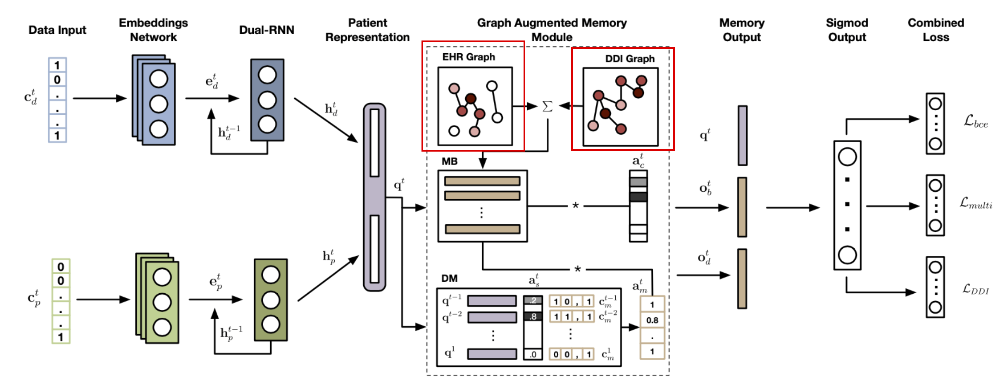

In [37]:
class GraphConvolution(nn.Module):
    """
    Simple GCN layer, similar to https://arxiv.org/abs/1609.02907
    """

    def __init__(self, in_features, out_features, bias=True):
        super(GraphConvolution, self).__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.weight = nn.Parameter(torch.FloatTensor(in_features, out_features))
        if bias:
            self.bias = nn.Parameter(torch.FloatTensor(out_features))
        else:
            self.register_parameter('bias', None)
        self.reset_parameters()

    def reset_parameters(self):
        stdv = 1. / math.sqrt(self.weight.size(1))
        self.weight.data.uniform_(-stdv, stdv)
        if self.bias is not None:
            self.bias.data.uniform_(-stdv, stdv)

    def forward(self, input, adj):
        support = torch.mm(input, self.weight)
        output = torch.mm(adj, support)
        if self.bias is not None:
            return output + self.bias
        else:
            return output

    def __repr__(self):
        return self.__class__.__name__ + ' (' \
               + str(self.in_features) + ' -> ' \
               + str(self.out_features) + ')'
    
class GCN(nn.Module):
    def __init__(self, vocab_med, adj, emb_dim=16):
        super(GCN, self).__init__()
        """
        FUNCTIONALITY: given the adjacency matrix, do graph convolution twice
        """
        
        """
        TODO: 
            1 (already done). normalize the adj using self.normalize, change to torch.FloatTensor()
            2. design one graph convolution layer with GraphConvolution in Line 1
                - input size: vocab_med
                - output size: emb_dim
            3. design another graph convolution layer
                - input size: emb_dim
                - output size: emb_dim
        """
        adj = self.normalize(adj + np.eye(adj.shape[0]))
        self.adj = torch.FloatTensor(adj)
        
        self.gcn1 = None
        self.gcn2 = None
        # your code here
        self.gcn1 = GraphConvolution(vocab_med, emb_dim)
        self.gcn2 = GraphConvolution(emb_dim, emb_dim)
#         raise NotImplementedError
        
        # the initial feature
        self.x = torch.eye(vocab_med)
    
    def forward(self):
        """
        TODO: 
            1 (already done). use self.gcn1 for the first graph convolution
                - remember to use self.adj
            2. use F.relu() as the activation function
            3. use self.gcn2
        """
        x = self.gcn1(self.x, self.adj)
        # your code here
        x = F.relu(x)
        x = self.gcn2(x, self.adj)
#         raise NotImplementedError
        
        return x
    
    def normalize(self, adj):
        adj = adj / (adj @ np.ones(adj.shape) + 1e-8)
        return adj

In [39]:
class MemoryBank(nn.Module):
    def __init__(self, vocab_med, adj_ehr, adj_ddi, emb_dim=16):
        super(MemoryBank, self).__init__()
        """
        FUNCTIONALITY: conbime information from EHR graph and DDI graph
        """
        
        """
        TODO:
            1. use GCN for EHR graph
                - using adj_ehr
                - using emb_dim as the ouput dimension
            2. use GCN for DDI graph
                - using adj_ddi
                - using emb_dim as the ouput dimension
            3 (already done). design a learnable weight between them
        """
        self.gcn_ehr = None
        self.gcn_ddi = None
        # your code here
        self.gcn_ehr = GCN(vocab_med=vocab_med, adj=adj_ehr, emb_dim=emb_dim)
        self.gcn_ddi = GCN(vocab_med=vocab_med, adj=adj_ddi, emb_dim=emb_dim)
#         raise NotImplementedError
        
        self.weight = nn.Parameter(torch.FloatTensor(1))
        self.weight.data.uniform_(-0.1, 0.1)
        
    def forward(self):
        """
        TODO: 
            1. get ehr graph feature
                - using .forward() function
            2. get ddi graph feature
                - using .forward() function
            3 (already done). get weighted information
        """
        
        # TODO
        info_ehr = None
        info_ddi = None
        # your code here
        info_ehr= self.gcn_ehr.forward()
        info_ddi= self.gcn_ddi.forward()
#         raise NotImplementedError
        info_comb = info_ehr - info_ddi * self.weight
        
        return info_comb

In [40]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''

torch.manual_seed(1234)

ehr_adj_path = f'{DATA_PATH}/adj_ehr.pkl'
ddi_adj_path = f'{DATA_PATH}/adj_ddi.pkl'
adj_ehr = dill.load(open(ehr_adj_path, 'rb'))
adj_ddi = dill.load(open(ddi_adj_path, 'rb'))

MB = MemoryBank(vocab_med, adj_ehr, adj_ddi)
test_point = MB()
assert test_point.shape == (131, 16), "MemoryBank is wrong!"
assert round(test_point[0, 2].data.item(), 4) == -0.1531, "MemoryBank is wrong!"



In [47]:
class DynamicMemory(nn.Module):
    def __init__(self, vocab_med):
        super(DynamicMemory, self).__init__()
        """
        FUNCTIONALITY: generate a historical mapping: query embedding -> multi-hot medication vector
        """
        self.vocab_med = vocab_med
    
    def forward(self, queries, codes_med):
        """
        Input:  queries
                    - this is the historical query embedding, given by PatientQuery Module
                    - size: (#visits - 1, emb_dim), delete the current query
                codes_med
                    - this is the historical groud truth med vector
                    - format: a list of length (#visits - 1)
        """
        
        DM_key = queries
        DM_value = np.zeros((queries.shape[0], self.vocab_med))
        print('DM_key.shape =', DM_value.shape)	
        print('DM_value.shape =', DM_value.shape)
        
        """
        TODO: transform codes_med to multi-hot and filling DM_value row by row (visit by visit)
        """
        # your code here
        for i in range(len(codes_med)):
            for j in codes_med[i]:
                DM_value[i][j] = 1
#         raise NotImplementedError
        
        # use torch.FloatTensor for DM_value
        DM_value = torch.FloatTensor(DM_value)
        
        return DM_key, DM_value

In [48]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''

torch.manual_seed(1234)

patientquery = PatientQuery(vocab_diag, vocab_prod)
queries = patientquery([[0,1], [1,2]], [[0,1], [1,2]])

DM = DynamicMemory(vocab_med)
DM_key, DM_value = DM(queries, [[1,2,3,4], [1,2,5,7]])

assert DM_key.shape == (2, 16), "DynamicMemory is wrong!"
assert DM_value[0, 4] == 1, "DynamicMemory is wrong!"
assert DM_value[0, 5] == 0, "DynamicMemory is wrong!"



tensor([[[-1.4303,  0.1725, -0.0384, -0.1058, -0.5431, -0.7006,  0.2906,
           0.4810, -0.9320,  0.4289, -0.1063, -0.0305,  0.0248,  0.3440,
          -0.4710,  0.1386],
         [-0.5277, -0.5866,  0.4311, -0.0049, -0.0272, -1.1932,  0.7079,
          -0.0367, -0.1760, -0.2180,  0.3188,  0.7031, -0.1790,  0.6352,
          -0.6178, -0.3891]]], grad_fn=<UnsqueezeBackward0>)
tensor([[[-0.3547,  0.4718, -0.8189,  0.9084, -0.0324, -0.2852, -0.1417,
          -0.2029, -0.0109,  0.3601, -0.3511,  0.2901, -0.6174, -0.7406,
          -0.8190,  0.4676],
         [-0.6713,  0.6692, -0.4225,  0.0563, -0.0196,  0.1010,  0.3742,
          -0.2718, -0.8772,  0.0337, -0.4635,  0.5225, -0.2506, -0.4284,
          -0.9731,  1.4787]]], grad_fn=<UnsqueezeBackward0>)
tensor([[-0.0123, -0.2742, -0.1677,  0.2024,  0.5281,  0.0293, -0.2368,  0.3236,
         -0.1141, -0.3227,  0.2044, -0.3219,  0.2323,  0.3795, -0.0928, -0.0298],
        [-0.0378, -0.3792, -0.2662,  0.2327,  0.6182, -0.0983, -0.2326,  

## Step5 (O): Output of the Memory Network [10 points]

- fact1: the query
- fact2: the result from querying MB
- fact3: the result from querying DM

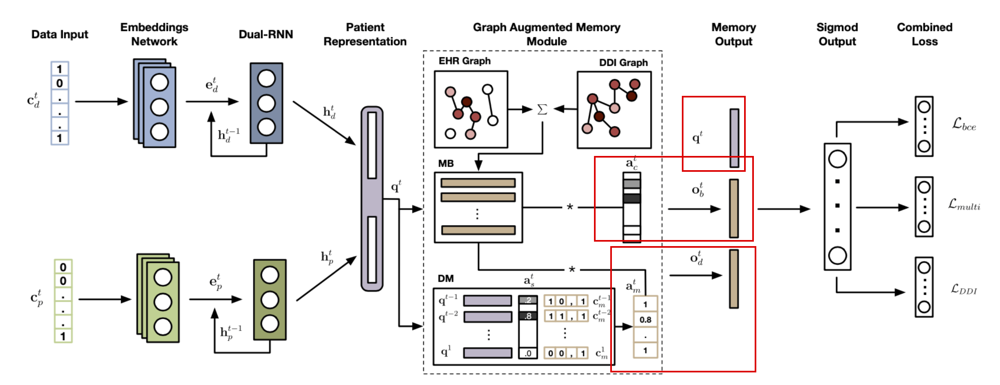

In [83]:
class Fact1(nn.Module):
    def __init__(self, queries):
        super(Fact1, self).__init__()
        """
        FUNCTIONALITY: extract the final embedding from input queries, q^t
        """
        self.queries = queries
    
    def forward(self):
        """
        TODO: assign the last embedding to result
                - final size: (1, emb_dim)
                - make sure the output size is **not** a vector format (emb_dim,)
        """
        result = None
        # your code here
        result = self.queries[-1]
        result = result.view(1, result.shape[0])
        print(result.shape)
#         raise NotImplementedError
        
        return result
    

class Fact2(nn.Module):
    def __init__(self, query, MB):
        super(Fact2, self).__init__()
        """
        FUNCTIONALITY: get attention information from MB, o^t_b
        Input:
            query
                - this is the last embedding
            MB
                - is the memory bank
        """
        self.query = query
        self.MB = MB
    
    def forward(self):
        """
        TODO: 
            1. get the attention weight between query and each row of MB, assing to attn_score
                - use torch.mm()
                - tip: need to transpose MB, using MB.t()
            2. use F.softmax(, dim=1) to compute the attention matrix, attn_matrix
            3. get the final result from attn_matrix and MB
                - use torch.mm(,)
        """
        attn_score = None
        attn_matrix = None
        result = None
        # your code here
        attn_score = torch.matmul(self.query, self.MB.t())
        attn_matrix = F.softmax(attn_score, dim=1)
        result = torch.matmul(attn_matrix,self.MB)
        
#         raise NotImplementedError
        
        return result
    
class Fact3(nn.Module):
    def __init__(self, query, MB, DM_key, DM_value):
        super(Fact3, self).__init__()
        """
        FUNCTIONALITY: similar to Fact2, get information from the DM, o_d^t
        """
        self.query = query
        self.MB = MB
        self.DM_key = DM_key
        self.DM_value = DM_value
    
    def forward(self):
        attn = F.softmax(torch.mm(self.query, self.DM_key.t()), dim=1)
        value = torch.mm(attn, self.DM_value)
        out = torch.mm(value, self.MB)
        return out

In [84]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''
torch.manual_seed(1234)

MB = MemoryBank(vocab_med, adj_ehr, adj_ddi)
fact1 = Fact1(queries).forward()
fact2 = Fact2(fact1, MB()).forward()
fact3 = Fact3(fact2, MB(), DM_key, DM_value).forward()

assert fact1.shape == (1,16), "fact1 is wrong!"
assert fact2.shape == (1,16), "fact2 is wrong!"
assert fact3.shape == (1,16), "fact3 is wrong!"
assert round(fact1[0, 2].data.item(), 4) == -0.2662, "fact1 is wrong!"
assert round(fact2[0, 2].data.item(), 4) == -0.1532, "fact2 is wrong!"
assert round(fact3[0, 2].data.item(), 4) == -0.6122, "fact3 is wrong!"



torch.Size([1, 16])


## Step6 (R): predict the medications [10 points]

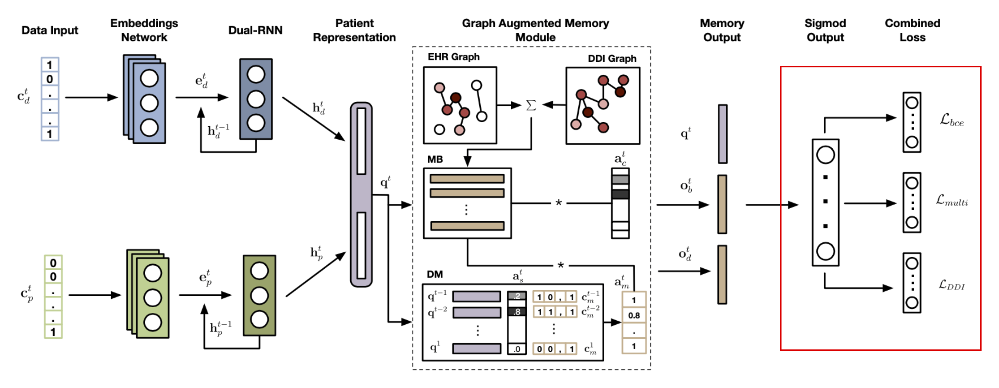

In [91]:
class OutNet(nn.Module):
    def __init__(self, vocab_med, emb_dim=16):
        super(OutNet, self).__init__()
        """
        FUNCTIONALITY: combine fact1, fact2, fact3 to do final prediction
        """
        
        """
        TODO:
            1. build the first linear layer
                - input size: 3 * emb_dim
                - end size: 2 * emb_dim
                - use bias=True option
            2. build the second linear layer
                - input size: 2 * emb_dim
                - end size: vocab_med
                - use bias=True option
        """
        self.fc1 = None
        self.fc2 = None
        # your code here
        self.fc1 = nn.Linear(3 * emb_dim, 2 *emb_dim, bias=True)
        self.fc2 = nn.Linear(2 * emb_dim, vocab_med, bias=True)
#         raise NotImplementedError
        
    def forward(self, fact1, fact2, fact3):
        """
        Input:
            fact1, fact2, fact3:
                - three facts q^t, o^t_b, o^t_d
                - each size: (1, emb_dim)
        """
        
        """
        TODO: 
            1. concat fact1, fact2, fact3, and assign to memory_out
                - size: (1, 3 * emb_dim)
            2. pass through the first linear layer
            3. use F.relu() as the activation
            3. pass through the second linear layer
        """
        memory_out = None
        result = None
        # your code here
        memory_out = torch.cat([fact1, fact2, fact3], dim=1)
        print(memory_out.shape)
        result = self.fc1(memory_out)
        result = F.relu(result)
        result = self.fc2(result)
#         raise NotImplementedError
        
        return result

In [92]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''
torch.manual_seed(1234)

outnet = OutNet(vocab_med)
output = outnet(fact1, fact2, fact3)
assert round(output[0, 2].data.item(), 4) == -0.0463



torch.Size([1, 48])


## Overall GAMENet model [10 points]

In [93]:
# please stack all the modules together

class GAMENet(nn.Module):
    def __init__(self, vocab_diag, vocab_prod, vocab_med, adj_ehr, adj_ddi, emb_dim=128):
        super(GAMENet, self).__init__()
        """
        FUNCTIONALITY: integrate the whole model together
        """
        
        """
        TODO: 
            1. build a patient query network
                - PatientQuery
                - use vocab_diag, vocab_prod, emb_dim
            2. build a memory bank
                - MemoryBank
                - use vocab_med, adj_ehr, adj_ddi, emb_dim
            3. build a dynamic memory
                - DynamicMemory
                - use vocab_med
            4. build a output network
                - OutNet
                - vocab_med, emb_dim
        """
        self.patient = None
        self.memorybank = None
        self.dynamicmemory = None
        self.outnet = None
        # your code here
        self.patient = PatientQuery(vocab_diag, vocab_prod, emb_dim)
        self.memorybank = MemoryBank(vocab_med, adj_ehr, adj_ddi, emb_dim)
        self.dynamicmemory = DynamicMemory(vocab_med)
        self.outnet = OutNet(vocab_med, emb_dim)
#         raise NotImplementedError
        
    def forward(self, codes_diag, codes_prod, codes_med):
        """
        input:
            codes_diag
                - a list of length #visits
                - each element is also itself a list
            codes_prod
                - a list of length #visits
                - each element is also itself a list
            codes_med
                - a list of length #visits - 1
                - each element is also itself a list
        """
        
        # get patient query embedding (#visit, emb_dim*2)
        queries = self.patient(codes_diag, codes_prod)
        
        """
        TODO:
            1. build a memory bank, assign to MB
                - use self.memorybank
            2. build a dynamic memory, assign to DM_key and DM_value
                - use self.dynamicmemory
                - use queries and codes_med as features
        """
        MB = None
        DM_key, DM_value = None, None
        # your code here
        MB = self.memorybank()
        DM_key, DM_value = self.dynamicmemory(queries,codes_med)
#         raise NotImplementedError
        
        # extract three memory outputs, assign to fact1, fact2, fact3
        fact1 = Fact1(queries)()
        fact2 = Fact2(fact1, MB)()
        fact3 = Fact3(fact1, MB, DM_key, DM_value)()

        # get the final output
        result = self.outnet(fact1, fact2, fact3)
        
        return result

In [94]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''
torch.manual_seed(1234)

model = GAMENet(vocab_diag, vocab_prod, vocab_med, adj_ehr, adj_ddi)
output = model([[0,1], [1,2], [4,5]], [[0,1], [1,2], [5,7]], [[0,1], [2,5]])

assert output.shape == (1, vocab_med)
assert round(output[0, 2].data.item(), 4) == -0.0347, "GAMENet is wrong!"



tensor([[[ 3.0764e-01,  4.5351e-01,  5.8181e-01,  2.5612e-01, -3.5925e-01,
           8.8330e-01, -3.3378e-01,  7.0228e-01,  5.1377e-02, -7.6903e-01,
           4.6091e-01, -6.1417e-03,  3.5797e-01, -8.4629e-01, -2.1331e-01,
          -5.1008e-02, -2.2483e-01,  2.7833e-01, -1.4494e-01, -1.1952e-01,
           7.1553e-01,  2.8530e-01,  2.4585e-02,  1.6515e-01, -6.0457e-02,
          -3.3748e-01, -9.1356e-01, -3.6989e-02,  7.1666e-01,  8.8406e-01,
           5.2531e-01, -7.8911e-01,  6.8315e-01,  4.2212e-01,  1.1444e+00,
           4.8377e-01, -5.7031e-01, -9.5786e-01, -2.2841e-01, -3.1010e-02,
          -1.3566e+00,  7.6746e-01,  2.6600e-01,  3.8048e-01, -4.1659e-01,
           6.3073e-01, -9.2924e-01,  4.6707e-01,  4.0368e-01, -1.1179e+00,
           1.3167e-01,  8.0918e-01,  8.3975e-02, -6.5686e-01, -3.3503e-01,
           1.3775e+00, -3.5249e-01,  6.5532e-01,  1.4674e+00, -8.0495e-02,
           7.8352e-01,  6.2782e-01, -9.9217e-01, -2.6199e-02,  2.8362e-01,
          -3.3536e-01,  6

## Training and Inferencing [15 points]

In [95]:
import random
random.seed(seed)

tmp = data.copy()
random.shuffle(tmp)

# 80%: 20% split training and test sets randomly
train_set = tmp[:int(len(data)*0.8)]
test_set = tmp[int(len(data)*0.8):]

In [97]:
%%time

model = GAMENet(vocab_diag, vocab_prod, vocab_med, adj_ehr, adj_ddi)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

def dataFormatter(patient_list):

    diag_list, prod_list, med_list = [], [], []
    for diag, prod, med in patient_list:
        diag_list.append(diag)
        prod_list.append(prod)
        med_list.append(med)
    
    target = np.zeros((1, vocab_med))
    target[0, med_list[-1]] = 1
    return diag_list, prod_list, med_list[:-1], torch.FloatTensor(target)

from sklearn.metrics import accuracy_score

def test(test_set):
    model.eval()
    pred_list, target_list = [], []
    for patient in test_set:
        for idx, visit in enumerate(patient):
            codes_diag, codes_prod, codes_med, target = dataFormatter(patient[:idx+1])
            pred = model(codes_diag, codes_prod, codes_med).detach().cpu().numpy()[0]
            pred[pred >= 0.5] = 1; pred[pred < 0.5] = 0
            pred_list += pred.tolist(); target_list += target.numpy().tolist()[0]
    return pred_list, target_list

def train(train_set):
    for i in range(2):
        model.train()
        for patient in train_set:
            loss = 0
            for idx, visit in enumerate(patient):
                # get the training data and target of bce loss
                codes_diag, codes_prod, codes_med, target = dataFormatter(patient[:idx+1])
                # get the target of multilabel_margin_loss
                multi_target = np.full((1, vocab_med), -1)
                for idx, item in enumerate(visit[2]):
                    multi_target[0][idx] = item
                multi_target = torch.LongTensor(multi_target)
                
                """
                TODO: get the output of the model, assign to pred
                """
                pred = None
                # your code here
                pred = model.forward(codes_diag, codes_prod, codes_med)

#                 raise NotImplementedError
                
                loss += F.binary_cross_entropy_with_logits(pred, target) + \
                                    F.multilabel_margin_loss(F.sigmoid(pred), multi_target)
            
            """ 
            TODO:
                1. set zero grad to the optimizer
                2. backward loss
                3. make one step of the optimizer
            """
            # your code here
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
#             raise NotImplementedError
            
        # use the first 100 test patients to compute intermediate accuracy
        print(accuracy_score(*test(test_set[:100])))
    
# train the model with first 500 patients
# feel free to change the number of training patients
train(train_set[:500])

tensor([[[-0.1872,  0.3272, -0.0830, -0.0051, -0.4189,  0.0581, -0.2173,
           0.5910, -0.2398, -0.1789, -0.1118,  0.4591,  0.3152,  0.1022,
           0.3758, -0.3554, -0.0019, -0.2692,  0.3030,  0.0964, -0.5882,
           0.0682,  0.2530,  0.6635, -0.3953,  0.3613, -0.3555,  0.3546,
          -0.7162, -0.0426,  0.0769, -0.0089, -0.0863, -0.1106, -0.3346,
          -0.1223, -0.1053, -0.0113,  0.1308,  0.0132,  0.0999,  0.0180,
           0.0431,  0.5396,  0.6978,  0.4338, -0.1902,  0.1555, -0.4083,
           0.2636, -0.3946,  0.0936,  0.5298,  0.1375,  0.3420,  0.0972,
          -0.2170,  0.2862,  0.3157,  0.3839,  0.0811, -0.4202,  0.1124,
           0.1374,  0.0181,  0.2464, -0.0027,  0.0316,  0.0556,  0.1872,
          -0.9672, -0.2142,  0.1896, -0.1674,  0.3085, -0.6176,  0.1054,
          -0.3489, -0.5811, -0.4552, -0.4526,  0.2300, -0.4451, -0.2665,
          -0.3634, -0.3059,  0.2415, -0.2096,  0.2580, -0.3762,  0.0335,
          -0.3542, -0.1812, -0.4515, -0.4044,  0.20

tensor([[[ 0.2032,  0.4043,  0.6119,  0.0654, -0.0109, -1.2536, -0.0145,
          -0.3319, -0.2036,  0.0069, -0.1027, -0.3473,  0.5035, -0.1054,
          -1.0821, -0.6400, -0.3999, -0.3747, -0.0237, -0.1004,  0.3023,
           0.4480, -0.2179,  0.5729,  0.7743, -0.4005,  0.6165,  0.3162,
          -0.5049,  0.1564, -0.1534,  0.2129,  0.0194, -0.6890, -0.4159,
           0.0141, -0.6756, -0.0223,  0.4287, -0.5492, -0.2684,  0.2687,
           0.3852,  0.2295, -0.2643, -0.2128, -0.2201, -0.1191,  0.2651,
          -0.4838,  0.1701,  0.3157, -0.6130, -0.1132, -0.2790,  0.6173,
           0.9706,  0.2743,  0.8701, -0.5168, -0.8216, -0.9854,  0.5831,
          -0.8410,  0.1160, -0.0891,  0.0934,  0.7837,  0.0092, -0.5292,
          -0.3289, -0.0189,  0.5773, -0.2099,  0.2197,  0.4437, -0.7387,
           0.4331,  0.8897, -0.6244, -0.5792,  0.2958,  0.5759, -0.1850,
          -0.0060, -0.4707, -0.3799, -0.1819,  0.0884,  0.0303,  0.8903,
           0.8835, -0.3772,  0.5794, -0.8347,  0.36

tensor([[ 8.5635e-01,  8.1328e-02,  2.4986e-05, -4.1825e-01, -3.8577e-01,
         -8.8354e-01, -6.4827e-01,  6.9435e-01,  6.8008e-01, -3.0572e-01,
          7.6342e-01,  3.3768e-01, -4.2736e-02,  1.9045e-01, -3.1082e-01,
          4.3501e-01,  5.0828e-01,  3.4810e-01, -7.0510e-01,  9.9817e-01,
          9.1295e-01, -6.7711e-01, -4.5242e-01,  1.4182e-01,  4.8270e-01,
         -5.1250e-01,  5.4124e-01, -6.6705e-01,  3.9345e-01,  6.2052e-01,
         -2.7851e-01, -6.9781e-01, -3.4353e-01, -4.4847e-01, -5.4759e-01,
         -3.5683e-01,  7.2489e-02, -5.4488e-02, -2.2900e-01, -8.1699e-01,
          3.8305e-01, -4.8183e-01,  9.3860e-01, -8.6107e-01, -2.4626e-01,
          6.1819e-01, -8.9843e-01,  7.1464e-01, -6.1294e-01,  1.4358e-01,
          4.1553e-01, -7.5039e-01, -3.4597e-01, -8.5945e-01, -7.9276e-01,
         -4.8017e-01,  7.3536e-02,  7.0394e-02, -6.4472e-01, -6.0615e-01,
         -2.1296e-01, -2.6811e-01,  1.0727e+00,  6.7212e-01, -6.9517e-01,
         -7.9282e-01,  6.5900e-01, -4.

tensor([[[ 5.1076e-01, -3.4597e-02, -1.3955e+00, -1.2488e-01,  2.5810e-01,
           6.1429e-01,  2.6612e-01,  4.1332e-01,  2.7957e-01,  2.3697e-01,
           3.1926e-01, -1.0668e-01,  2.9909e-01,  3.8258e-01, -4.0719e-01,
           3.1448e-02,  5.3551e-01, -8.1576e-01,  4.0532e-03,  7.1905e-01,
          -6.4192e-01,  5.6117e-01, -9.3113e-01, -4.0909e-01, -1.1421e+00,
           2.9646e-01, -1.5931e-01, -9.2354e-01,  5.4058e-01,  7.7250e-01,
           2.5733e-01, -1.2721e+00, -4.3654e-01,  1.0985e+00, -7.4446e-01,
           3.5091e-01, -4.1309e-01,  3.1664e-01, -4.1883e-01, -4.0921e-01,
           3.6622e-02, -1.2726e+00, -8.7652e-02,  1.1258e+00, -4.4104e-01,
          -1.1912e-01,  9.9683e-01,  6.3319e-01, -3.9984e-01,  7.4377e-01,
           7.0667e-01,  6.6220e-01, -4.3117e-01,  5.0768e-01,  3.3867e-01,
           6.9768e-01, -6.8332e-02, -4.6504e-01,  2.0160e-02,  2.5902e-01,
          -6.1864e-02,  2.5564e-02,  6.0743e-01,  1.4870e-01, -2.9811e-01,
          -8.6999e-01,  2

tensor([[[-6.0114e-01, -2.6720e-01, -5.0705e-01, -1.4258e-01,  3.9083e-01,
           4.6336e-01, -2.5557e-01,  7.5474e-01,  5.6116e-01,  2.8937e-01,
           3.0834e-01,  2.6155e-01, -2.0364e-01,  1.3566e-01, -2.4769e-01,
           5.9325e-01, -7.3403e-02, -7.8910e-02, -7.3356e-01,  2.5409e-01,
          -4.1017e-01, -1.3838e-01,  4.1827e-01, -1.2250e-01, -1.6884e-01,
          -8.5546e-01,  7.8419e-03, -2.3224e-01,  1.1026e-01, -4.5070e-01,
           1.2871e-01,  6.6568e-01,  3.3788e-01,  5.5828e-02, -2.1274e-01,
           4.6553e-02,  1.9042e-01,  4.9628e-02, -3.4242e-01,  4.7682e-01,
           1.0034e+00, -4.6473e-01,  3.7501e-01, -3.2985e-01,  5.3897e-01,
           2.1699e-01, -7.7070e-01, -6.2204e-01, -5.1341e-02, -5.2058e-01,
          -1.7567e-01, -6.1929e-01,  5.8742e-01, -3.4327e-01, -3.7916e-01,
          -4.1162e-02, -1.8276e-01, -3.5753e-01, -3.2810e-01,  7.9069e-02,
           3.1644e-01, -2.4816e-01,  4.0642e-01,  3.9556e-01, -2.1712e-01,
          -1.6349e-02,  3

tensor([[[-0.2817, -0.5590, -0.5849,  1.2710, -0.2789,  0.3166,  0.4852,
           0.1823, -0.3043,  0.0037, -1.0851, -0.6714, -0.1944,  0.0695,
          -0.8107, -0.1952, -0.1094, -0.6832,  0.2614,  0.2391, -0.3192,
           0.2744,  0.1347, -1.1604, -0.1227, -0.0236, -0.3379, -0.5331,
          -0.1844,  0.1012,  0.2417,  0.7762,  0.8330,  0.7804, -0.5849,
           0.3530, -0.5055,  0.2457, -0.0433,  0.3627,  0.7021, -1.0310,
           0.5216, -0.3534, -0.5113,  0.2877, -0.0915, -1.1853,  0.9174,
          -0.3840, -0.5130, -0.9768, -0.1423, -1.2045,  0.1764,  0.4595,
          -0.1136, -0.0773,  0.0804,  0.6624,  0.4377, -0.5709,  0.4806,
          -0.3302, -0.9290, -0.4539, -0.2610, -0.4240, -0.4194,  0.1260,
          -0.6063, -0.5505, -0.2839,  0.0090, -0.2686, -0.6253,  0.4556,
          -0.0984, -0.2131, -1.6951,  0.1246, -0.2332,  1.1204,  1.0122,
           0.4575, -0.4584,  0.8931,  0.4099,  0.0418,  0.6237,  0.0523,
           0.0972, -0.9311, -0.7119,  0.1019,  1.17

tensor([[[ 0.6577, -0.9035, -0.6328,  0.3700,  0.4235,  0.1016,  0.5010,
          -0.4407, -0.0076,  0.5269, -0.2082,  0.0144,  0.4207, -1.2858,
          -0.0634, -0.3594,  1.2982,  0.1097,  1.5867,  0.3054, -0.4291,
          -0.2311,  0.2975, -0.1394,  0.2970, -0.5210, -0.8645, -0.9472,
           0.6740,  0.2065,  0.1148, -0.8062, -0.7341, -0.2563, -0.1530,
          -0.5452,  1.0213,  0.1954, -0.2545, -0.9066,  0.7773, -0.0567,
          -0.2462, -0.1877,  1.6663,  0.4218, -0.2435,  0.8492, -0.5206,
           0.9433, -1.1032, -0.6542,  0.0589, -0.3814,  0.2747,  1.1008,
          -0.4780, -0.6963, -0.2992, -0.0480,  0.1121,  0.6571, -0.2692,
          -1.3318, -1.0282,  0.5332, -0.3140, -0.2213,  0.3077, -0.8494,
           0.5095, -0.4628,  0.2456,  0.1688,  0.3757,  0.1400, -0.1485,
           0.3783, -0.3811, -0.7487,  0.4097,  0.3201, -0.5101, -0.5471,
          -0.0672,  0.5390, -0.4207, -0.3952, -0.0892, -0.4885, -0.1043,
           0.5315,  0.1328, -0.3395, -0.0683,  0.04

tensor([[[-0.3803, -0.1245,  0.2599,  0.2379,  0.4161, -0.9378, -1.3569,
           0.3261,  0.5244,  0.6467, -0.1110,  0.1295, -1.1039,  0.0504,
           0.3872, -0.0894,  0.2210, -0.0889, -0.1120, -0.1655,  0.1351,
           0.2423, -0.3893, -0.1346,  0.3393, -0.1161, -0.7060, -0.9344,
          -0.3153,  0.2243, -0.1667,  0.1432,  0.5167,  0.5033, -0.4277,
          -0.5089,  0.7969,  0.4924,  0.3362, -0.5009,  0.0991,  0.2965,
          -0.4237, -0.2774, -0.5156,  0.2739,  0.3532, -0.3937,  0.7925,
           0.0451, -0.0016,  0.2519, -0.8642,  0.1169,  0.1604, -0.0605,
           0.7059,  0.3625,  0.1266, -0.3542,  0.1163,  0.2984,  0.3956,
           0.2210,  0.4242,  0.1117, -0.0218, -0.3437, -0.2771,  0.3200,
           0.0773,  0.5135,  0.2347,  0.2947, -0.0677,  0.3179, -0.7704,
           0.1235, -0.9098, -0.3122, -0.5102, -0.2135, -0.0429,  0.1829,
           0.3354, -0.2419, -0.8400, -0.0962, -0.6314, -0.6186, -0.0261,
          -0.5277,  0.3559,  0.0175, -0.3401,  0.82

DM_key.shape = (1, 131)
DM_value.shape = (1, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[ 0.0131, -0.1807,  0.1879, -0.1648,  0.2299,  0.0514,  0.1792,
           0.2355, -0.0100,  0.0760,  0.4137,  0.2014, -0.0011, -0.0379,
           0.3924,  0.3921,  0.0065,  0.2911,  0.0324,  0.2480,  0.2650,
           0.2135,  0.0904, -0.0658, -0.2008,  0.0687, -0.0177,  0.0927,
           0.0225,  0.0883, -0.1057, -0.1276,  0.4686, -0.3792, -0.2114,
           0.0661,  0.1552,  0.1414, -0.0987,  0.2778, -0.1036, -0.2784,
          -0.0819, -0.1168,  0.2636, -0.4249, -0.1026, -0.0333, -0.1724,
          -0.0487,  0.0622, -0.1292,  0.0269, -0.2601, -0.2172,  0.0893,
          -0.0088, -0.0695, -0.1855,  0.1334, -0.1928,  0.0019, -0.1937,
          -0.1069,  0.0730,  0.1484,  0.1171,  0.3080, -0.4331, -0.1015,
           0.0825,  0.3314,  0.0617,  0.1803, -0.0456,  0.0317,  0.0467,
          -0.2146, -0.1353, -0.1664, -0.5455, -0.4359,  0.0946, -0.0723,
          -0.1891,  0.0747,  0.1

tensor([[[ 0.3026, -0.3430, -0.0711,  0.3169,  0.3525, -0.1055, -0.3457,
           0.2632, -0.5533,  0.3310,  0.3441,  0.0441,  0.6023, -0.1007,
          -0.8666,  0.3859,  0.5856, -0.5986, -0.8726,  0.0484,  0.4591,
          -0.3635, -0.2435,  0.0665,  0.3285,  0.0606,  0.0530,  0.6562,
          -0.8356,  0.3935,  0.3008,  0.0501, -0.3760, -0.0672, -0.1161,
           0.1533,  0.1779,  0.2498,  1.0406, -0.0271, -0.4030,  0.2869,
           0.0721, -0.1608,  0.2521, -0.3269,  0.0231, -0.6339,  0.9262,
          -0.0963, -0.2577, -0.3459,  0.0443,  0.2647, -0.2229,  0.6315,
           0.1733, -0.6809,  0.4032, -0.9400, -1.5069, -0.4331,  0.6214,
          -0.1148,  0.2988, -0.3903, -0.4459,  1.0954, -0.2828, -0.5785,
          -0.1725, -0.1772, -0.7209, -0.2788, -0.4303, -0.2496, -0.1699,
           1.0578, -0.0809,  0.3250, -0.4993,  0.1990,  0.5812, -0.4377,
           0.5686,  0.2348, -0.0265, -0.2963,  0.7128, -0.1505,  0.9222,
           0.0507,  0.0398,  0.4607, -0.4555,  0.82

tensor([[[-0.1320, -0.3492, -0.2526,  0.0329, -0.0875, -0.3207,  0.4622,
          -0.0795,  0.0588,  0.2949, -0.1168,  0.0375,  0.1755, -0.4210,
          -0.4689,  0.0556, -0.5500, -0.1126, -0.0857,  0.1009,  0.1035,
           0.3030, -0.1925,  0.1393,  0.4886, -0.2625,  0.4294,  0.4402,
           0.1967, -0.1288,  0.2342,  0.1329,  0.3487,  0.3582,  0.3210,
          -0.1572, -0.4721, -0.5153, -0.0593, -0.4344,  0.0984,  0.2276,
           0.0275, -0.3155, -0.2095, -0.0960, -0.8252,  0.4842, -0.0260,
          -0.3747,  0.2365, -0.2247, -0.3100,  0.1034,  0.2985, -0.2742,
           0.0815,  0.0615,  0.1318, -0.1350,  0.0125, -0.2424, -0.2537,
           0.2129,  0.2204,  0.2547,  0.2548,  0.0103, -0.0838, -0.0013,
           0.1332,  0.0952, -0.2669,  0.1508,  0.2003, -0.0844, -0.2454,
           0.1317,  0.1902, -0.0067,  0.1047, -0.3245, -0.0907, -0.2260,
          -0.0237,  0.0293,  0.2693,  0.2715,  0.2101,  0.3134, -0.2770,
          -0.0515, -0.0757,  0.2921,  0.0504,  0.41

DM_key.shape = (5, 131)
DM_value.shape = (5, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.0634,  0.1576, -0.1405,  0.4233,  0.3641,  0.0862, -0.1921,
          -0.4143, -0.0178,  0.3239,  0.0212,  0.2100, -0.0685, -0.4658,
           0.0694,  0.2768,  0.0202, -0.0498, -0.0895,  0.1406, -0.0109,
          -0.1460, -0.2275,  0.0030,  0.2092, -0.0845, -0.1251, -0.0856,
           0.2269, -0.0931, -0.0654, -0.3375,  0.1747, -0.1678,  0.3492,
          -0.1327,  0.3313,  0.1080, -0.0330,  0.2379, -0.0712, -0.2575,
          -0.1155, -0.0029, -0.0870, -0.2046, -0.0994,  0.0037, -0.1502,
          -0.3288, -0.1219, -0.1758,  0.2357, -0.0078, -0.0055,  0.2930,
           0.3669,  0.1631, -0.0195,  0.1838,  0.0095, -0.0342, -0.3103,
           0.2773, -0.4413, -0.0842, -0.0970,  0.4076,  0.0690,  0.0282,
           0.2880, -0.1034,  0.1758, -0.4093,  0.0922,  0.1548,  0.1287,
          -0.1862,  0.4022, -0.0752,  0.2376, -0.0536,  0.1933, -0.0405,
          -0.0876, -0.0821,  0.0

tensor([[[ 0.2881, -0.1896,  0.0045,  0.0080, -0.1566, -0.1003, -0.2631,
           0.1865,  0.0793, -0.3919,  0.1333,  0.1277, -0.1899, -0.1624,
          -0.0552,  0.2289,  0.2982,  0.1640,  0.2490,  0.2140,  0.3648,
          -0.4956, -0.4134,  0.0470,  0.6768, -0.0100, -0.3035,  0.5418,
          -0.2539, -0.0284, -0.4406, -0.3144,  0.3273, -0.2205,  0.0094,
          -0.0426,  0.3264, -0.1163,  0.1838,  0.3713, -0.2557,  0.2630,
           0.6777,  0.3108,  0.2777,  0.6909, -0.1012,  0.1605,  0.1979,
          -0.4289,  0.6706,  0.2531, -0.1594,  0.0977,  0.5644,  0.2451,
          -0.2379,  0.0723,  0.6108, -0.6095,  0.3799,  0.0793, -0.6914,
          -0.1319,  0.3118, -0.2433,  0.3509,  0.3475,  0.0793, -0.2950,
          -0.2597,  0.2780,  0.2119, -0.3269, -0.1682, -0.0285, -0.1354,
          -0.2039,  0.1195,  0.0460,  0.1512,  0.3492, -0.0865,  0.6656,
          -0.4741, -0.2160, -0.0057, -0.0224, -0.3057, -0.4650, -0.0447,
           0.3618, -0.5637,  0.1716,  0.0658, -0.25

torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.1444, -0.0272, -0.0599,  0.1440,  0.1405,  0.0930, -0.0337,
           0.0573, -0.0022,  0.0167, -0.1015, -0.1312,  0.0303,  0.1174,
          -0.0528,  0.0712, -0.1518, -0.1518, -0.0408,  0.1302,  0.1712,
           0.0842, -0.2176, -0.1963, -0.0166, -0.1746,  0.2527,  0.1397,
           0.0191, -0.1474, -0.2111,  0.0986, -0.0286,  0.0821,  0.1057,
          -0.0184,  0.1958,  0.1799,  0.1202, -0.0475, -0.0449,  0.2482,
           0.2051, -0.0182, -0.2341,  0.1093, -0.0405,  0.1478,  0.3495,
          -0.0152,  0.4152, -0.0358, -0.2312,  0.0984,  0.2737,  0.1666,
          -0.2809, -0.1714, -0.0815,  0.0280,  0.4051, -0.2151,  0.0711,
           0.2431,  0.1454, -0.1642, -0.0090, -0.0385, -0.0254,  0.1154,
          -0.1762, -0.1516, -0.0052, -0.0089,  0.0759,  0.1030, -0.0303,
          -0.0921,  0.0813, -0.1229, -0.0621,  0.0697, -0.1953, -0.1126,
          -0.0442, -0.0733, -0.2493, -0.0585, -0.2586, -0.0791,  0.1956,
         

tensor([[ 2.0215,  0.0722, -0.6255, -1.4717, -0.5958, -2.1445, -2.1368,  1.5497,
          1.8592, -0.9863,  1.9726,  1.2371, -0.6892,  0.3759, -1.0532,  1.5369,
          1.4584,  0.7494, -2.0390,  2.1876,  2.0942, -1.6951, -0.5305,  0.3782,
          1.4632, -1.6255,  1.2187, -1.8721,  1.3513,  1.6977, -1.3267, -1.5844,
         -1.1933, -1.4326, -1.7969, -0.6890, -0.3805,  0.2657, -0.8253, -2.1252,
          1.2689, -1.1086,  1.9783, -1.8390, -0.0987,  1.8250, -1.9897,  1.8139,
         -1.7656,  0.9147,  1.4456, -1.7245, -0.8225, -1.8698, -1.9956, -1.5851,
          0.3963, -0.0367, -1.6697, -1.6618, -0.8263, -1.1729,  2.1985,  1.6520,
         -1.8800, -2.0007,  1.5585, -1.5579,  2.1784, -1.4183,  1.9385,  0.7590,
         -2.0114,  0.5621, -1.8422, -0.3776,  1.3542,  1.5645, -1.6857,  1.7746,
          2.4501,  1.7807, -2.0238, -2.0762, -1.1972,  1.3816, -0.4256,  1.6958,
         -1.2678,  1.5041, -1.7500,  1.5519, -1.7704, -1.3666,  1.9176,  1.7220,
         -1.0637,  0.6127, -

tensor([[[-0.3779, -0.1484, -0.0928,  0.1339, -0.3276, -0.0546,  0.0366,
          -0.1463,  0.1890, -0.2861,  0.1067,  0.0687,  0.1149, -0.4561,
          -0.0386,  0.0928,  0.1762,  0.1014,  0.3790, -0.3323, -0.0937,
           0.0357, -0.0822,  0.0844, -0.1932, -0.3057,  0.2258, -0.1320,
           0.2231, -0.4896, -0.2575, -0.0040, -0.1571,  0.1258, -0.2957,
           0.4798,  0.1249,  0.2461, -0.0012,  0.2120,  0.0595,  0.0586,
           0.2381, -0.0172,  0.0557,  0.1835,  0.1142,  0.1875, -0.0171,
          -0.1603,  0.0008,  0.1121,  0.1552,  0.2699, -0.2665,  0.4360,
           0.0822,  0.2500, -0.3994,  0.0360,  0.4090,  0.0024, -0.0245,
           0.0981,  0.2814,  0.2030,  0.5187,  0.0033, -0.2938,  0.2045,
           0.2691,  0.1906, -0.3135,  0.2536, -0.3916,  0.4712,  0.2904,
          -0.0468,  0.2248, -0.3709,  0.1262, -0.1223, -0.2361, -0.5093,
           0.1374, -0.0613,  0.1107,  0.1476,  0.1726,  0.2492,  0.1600,
           0.1255,  0.0291,  0.3977, -0.1959, -0.25

tensor([[[-0.0518, -0.4001,  0.1985,  0.3805, -0.3715,  0.4543, -0.2282,
           0.1056, -0.1408, -0.4316, -0.2916,  0.1761,  0.0387, -0.2420,
          -0.2925, -0.2061,  0.3680,  0.2177, -0.1480, -0.7384, -0.6858,
          -0.5695, -0.0927, -0.3431, -0.2164,  0.1816,  0.0270,  0.1033,
           0.2919, -0.2039,  0.2700,  0.3196,  0.3189,  0.1137, -0.3143,
           0.0678,  0.0999, -0.0784,  0.0606, -0.1712,  0.6371, -0.2641,
          -0.0790, -0.1747, -0.4078, -0.1204,  0.0943,  0.0634, -0.2337,
           0.1921,  0.4931, -0.8177,  0.0089,  0.8257,  0.2361,  0.0796,
           0.4060, -0.1207,  0.2093, -0.0213, -0.2852, -0.1706,  0.0404,
           0.1622, -0.0420,  0.5653,  0.1489, -0.5943,  0.0028,  0.2469,
           0.0031, -0.2713, -0.8494, -0.2656, -0.4102,  0.0020, -0.4241,
          -0.0957,  0.2413, -0.7213, -0.3791,  0.0412, -0.2245, -0.3035,
           0.0971,  0.2564,  0.2452, -0.0122,  0.0835,  0.3161,  0.1664,
           0.6012, -0.1380,  0.4832, -0.1435,  0.12

tensor([[[-0.5120, -0.3123,  0.7150,  0.5106, -0.6541, -0.0647, -0.1948,
          -0.0614,  0.0517, -0.6826,  0.4236,  0.0023, -0.3419,  0.4696,
           0.6331, -0.5355,  0.3087, -0.0477, -0.1949,  0.5515, -0.2834,
          -0.4598, -0.1986, -0.1934, -0.3284, -0.5416,  0.3981,  0.5944,
           0.2210,  0.4075, -0.0791,  0.4871, -0.4211, -0.3606,  0.3355,
          -0.0193,  0.4683,  0.1258,  0.0128,  0.0018, -0.6001,  0.2145,
           0.7256,  0.7060, -0.3259, -0.2403,  0.2039,  0.8079, -0.0437,
           0.0252, -0.1011,  0.1684, -0.7535, -0.3955,  0.5089, -0.2300,
          -0.3794, -0.2899,  0.4707,  0.0409,  0.2303,  0.0566, -0.1942,
          -0.5253, -0.5919, -0.1106,  0.1789,  0.0670, -0.3087, -0.4072,
          -0.5846,  0.4393, -0.4737,  0.0156, -0.7557,  0.5381, -0.2944,
          -0.3212, -0.6041, -0.3349, -0.1780,  0.0675,  0.0602, -0.2082,
           0.1485, -0.0693,  0.3206, -0.4678, -0.3375, -0.2982,  0.2422,
          -0.1587,  0.0395,  0.4055, -0.3750,  0.39

tensor([[[-0.2644, -0.2426,  0.0181, -0.1548,  0.1557,  0.1299, -0.3514,
          -0.0190, -0.1398,  0.1464,  0.4310,  0.4028, -0.3672, -0.1137,
           0.1571,  0.1582,  0.4876,  0.0556,  0.0175,  0.2848, -0.1530,
          -0.0808, -0.2583, -0.0398,  0.3320,  0.5453,  0.4203, -0.0258,
           0.1941, -0.0559, -0.1493,  0.0108,  0.5342,  0.1544, -0.0410,
          -0.1304,  0.0777, -0.1011,  0.0679, -0.0922,  0.0958,  0.1720,
          -0.0438,  0.4343, -0.2014,  0.2056, -0.2467,  0.2429, -0.2082,
           0.1987,  0.2780, -0.0274, -0.2407, -0.1578, -0.1129,  0.4902,
          -0.1302,  0.1093,  0.3068,  0.0631,  0.4436,  0.0342, -0.1283,
          -0.2553, -0.3051,  0.0810,  0.1024, -0.2087, -0.0234, -0.1994,
           0.0948, -0.1563, -0.1742, -0.0344,  0.2414, -0.2943, -0.1368,
          -0.2158,  0.0521, -0.1621,  0.0636, -0.4872,  0.1303, -0.0137,
           0.1202,  0.1904, -0.1925, -0.1033, -0.1255, -0.2882,  0.2324,
          -0.0213,  0.1933, -0.0909, -0.0960,  0.08

tensor([[ 1.9145, -0.3011, -0.5434, -1.4316, -0.6415, -2.1082, -2.0308,  1.4376,
          2.0447, -1.1550,  1.9763,  1.2355, -0.5747,  0.1967, -1.1099,  1.3538,
          1.6210,  0.6852, -1.8996,  2.1707,  2.1328, -1.6228, -0.5702,  0.0892,
          1.5958, -1.6071,  1.2072, -1.8965,  1.4016,  1.7190, -1.3164, -1.7191,
         -1.1989, -1.4904, -1.7239, -0.4952, -0.2729,  0.3100, -0.6878, -2.0860,
          1.2022, -1.2536,  1.9408, -1.8327, -0.1432,  1.8731, -1.9977,  1.6879,
         -1.8256,  0.8069,  1.3996, -1.7872, -0.9589, -1.9007, -1.9720, -1.5983,
          0.1627, -0.3123, -1.6703, -1.4104, -0.6416, -1.0398,  2.1980,  1.7677,
         -1.7335, -1.9011,  1.6148, -1.6320,  2.1985, -1.3410,  1.8184,  0.6076,
         -2.1004,  0.5878, -1.8154, -0.1449,  1.3733,  1.6494, -1.6904,  1.8758,
          2.3759,  1.7733, -2.1768, -2.1519, -1.1623,  1.3158, -0.5144,  1.5490,
         -1.3479,  1.3605, -1.5334,  1.4912, -1.7512, -1.3403,  1.9395,  1.8597,
         -1.0660,  0.7908, -

tensor([[[-1.9174e-01,  2.9082e-01,  1.2788e-01,  3.7975e-02,  1.8625e-02,
           6.2484e-02, -2.9375e-02,  1.5615e-01,  8.3315e-02, -2.8221e-01,
          -1.1385e-01, -2.4736e-01,  3.6242e-01, -1.1007e-01,  3.1657e-01,
           1.5996e-01, -1.0626e-01, -3.7776e-02,  2.0020e-01,  5.8294e-01,
          -1.6647e-02, -4.4115e-02, -3.5397e-01,  4.5695e-02, -4.8702e-02,
          -1.9430e-01, -1.5001e-01, -3.1535e-01,  2.2807e-02,  2.7375e-02,
          -5.0420e-01,  3.7237e-02, -3.1673e-01,  4.1153e-01,  3.1033e-01,
           5.0069e-01,  1.7483e-01, -6.0162e-02,  9.4439e-02, -2.0602e-02,
          -2.0213e-01,  8.7739e-02, -1.7143e-01,  3.5249e-01,  2.1988e-01,
           2.8821e-02,  1.0292e-01, -1.5069e-02,  2.1031e-01, -3.3481e-02,
          -3.6739e-02,  1.2939e-01, -1.8117e-01, -1.7479e-01, -1.5598e-01,
           4.6248e-01,  3.2047e-02, -1.1505e-01, -6.3572e-02,  8.0565e-02,
           2.8579e-02, -1.4114e-01, -1.0415e-01, -1.1320e-01, -1.6605e-04,
           1.3357e-01,  3

tensor([[[-0.3915,  0.0288,  0.8927, -0.0052, -0.2709,  0.7529,  0.5513,
           0.4438,  0.3615, -0.3245,  0.6833,  0.3993, -0.1171, -0.3074,
          -0.2161,  0.0255,  0.2734,  0.4293,  0.0747, -0.2551, -0.1230,
           0.4161, -0.0351,  0.2338, -0.1108,  0.2701,  0.1268, -0.0510,
          -0.0458, -0.1507,  0.1460,  0.2100,  0.9198, -0.4315,  0.3387,
          -0.0665, -0.3750,  0.0837,  0.0480,  0.7897,  0.6759,  0.1542,
          -0.4775, -0.0075,  0.0045,  0.0965,  0.3639,  0.2736, -0.3997,
          -0.1160, -0.3225, -0.0156, -0.5744,  0.1090,  0.0440,  0.2646,
          -0.1072,  0.2531,  0.0991, -0.5865,  0.4808,  0.1723,  0.6947,
          -0.0372, -0.0240,  0.1180, -0.0666,  0.1150,  0.5582,  0.2782,
          -0.4823, -0.0160, -0.1433,  0.5899, -0.3470,  0.2010,  0.2441,
           0.3210,  0.1314,  0.0137, -0.4003, -0.4859,  0.6349, -0.0041,
          -0.3564,  0.0460,  0.3219,  0.3154,  0.6379,  0.4281,  0.0177,
           0.5603, -0.3632, -0.0976, -0.6653, -0.00

tensor([[[-0.2489, -0.0219, -0.2323, -0.2667,  0.0486, -0.0581, -0.1289,
           0.1714,  0.1382, -0.0862,  0.1156, -0.0605,  0.3359,  0.1779,
          -0.3626,  0.2584, -0.0845,  0.0198, -0.0096, -0.1221, -0.0307,
          -0.1357,  0.2530,  0.0839, -0.0651,  0.0768, -0.3492,  0.0172,
           0.1500,  0.1941, -0.1209,  0.0216,  0.6983, -0.0868,  0.2401,
          -0.0245,  0.1332, -0.7661,  0.0880, -0.1349,  0.6067, -0.1471,
           0.0579, -0.1438,  0.0986, -0.2119, -0.1682,  0.1400,  0.1168,
           0.5720,  0.1990,  0.1675,  0.2456, -0.1523,  0.1920, -0.0172,
           0.4652,  0.2742,  0.2581, -0.1312, -0.0824, -0.2798,  0.5714,
          -0.0605, -0.0733, -0.0829,  0.1111,  0.0389, -0.1916, -0.3295,
           0.6481, -0.1887, -0.2629,  0.2295,  0.2353, -0.0307,  0.0638,
           0.2981,  0.3985,  0.0459,  0.3521,  0.0154,  0.1398, -0.1713,
           0.2456, -0.3347, -0.0192, -0.3327, -0.5230,  0.2237, -0.0396,
          -0.1253, -0.5550,  0.3571, -0.0665,  0.24

tensor([[[ 0.0721, -0.0849, -0.4211, -0.0777, -0.3918, -0.2151,  0.4753,
           0.1577, -0.0060,  0.1125,  0.0318,  0.1125,  0.3024,  0.2968,
          -0.1179, -0.1271,  0.0953, -0.3581, -0.4765, -0.1960, -0.1269,
          -0.0278, -0.3224, -0.0083,  0.3333, -0.1444,  0.5892, -0.3142,
           0.1002, -0.2405, -0.2183, -0.4645,  0.3644, -0.1849,  0.7811,
           0.0752, -0.2537,  0.5987,  0.1514,  0.6136,  0.3751,  0.0834,
          -0.2022,  0.0205, -0.0466,  0.0199, -0.8135, -0.1073, -0.0710,
          -0.0782, -0.3061, -0.1463,  0.2400, -0.1682,  0.2529,  0.1491,
          -0.1040,  0.2722,  0.4013,  0.2087,  0.1523,  0.2813, -0.5052,
           0.4509,  0.0124, -0.0825, -0.2997,  0.2753, -0.2217, -0.3961,
          -0.1531, -0.1028,  0.1466, -0.2807, -0.3102,  0.1608,  0.2803,
          -0.0753, -0.0203, -0.3602,  0.0498, -0.5694, -0.1457, -0.2746,
           0.1266, -0.1205, -0.8710,  0.0896,  0.0370, -0.2399,  0.3113,
           0.4461, -0.1557, -0.0887, -0.1156,  0.17

tensor([[[-0.3542,  0.2889, -0.2214, -0.3546, -0.0085, -0.3737,  0.0189,
          -0.1755,  0.1922,  0.4301, -0.0524,  0.0927,  0.2858, -0.3008,
          -0.2969, -0.3675,  0.1846,  0.3816,  0.0179, -0.5658, -0.3348,
           0.0637,  0.7497, -0.3031, -0.0421, -0.0584,  0.4496,  0.6991,
           0.6350,  0.1411,  0.0050,  0.3763, -0.2496,  0.1464, -0.3153,
           0.0267,  0.4650, -0.4403,  0.1250, -0.1899,  0.4587, -0.1281,
          -0.4448,  0.2510,  0.3374,  0.2742, -0.5403,  0.0443,  0.1887,
          -0.3222, -0.0857, -0.0723,  0.3679, -0.1357, -0.2398, -0.1390,
          -0.4800,  0.0374, -0.5014,  0.1473, -0.3802, -0.1997,  0.2282,
          -0.0824,  0.3780, -0.4974, -0.0339,  0.6335, -0.3158,  0.0605,
          -0.0568,  0.4039, -0.5441, -0.2994, -0.4219, -0.2793,  0.0834,
          -0.1487,  0.0481, -0.0577, -0.0484, -0.0579, -0.7604, -0.4537,
           0.1521,  0.1717,  0.3451,  0.3629,  0.3879,  0.5882,  0.2662,
          -0.1446,  0.0579, -0.3819,  0.3073,  0.29

tensor([[[-0.1758,  0.2700, -0.2616,  0.1120, -0.3244,  1.0827, -0.5931,
           0.1784,  0.4337,  0.3576,  0.0044,  0.2238, -0.4486,  0.1285,
           0.3931,  0.5255,  0.7309,  0.0864,  0.6228,  0.3583, -0.2306,
           0.7122,  0.1500,  0.3956,  0.0151, -0.2570, -0.2247, -0.4859,
           0.7121, -0.6755, -0.5454,  0.4225,  0.4137, -0.5010, -0.2934,
           0.2550,  1.0506, -0.7741,  0.3721,  1.5281, -0.4012,  0.5029,
          -0.1578,  0.4019,  0.3178,  0.5930,  0.4221, -0.1705, -0.2439,
           0.0851, -0.0086,  0.3171,  0.2551, -0.4464, -0.0744,  0.8537,
          -0.4206,  0.2423, -0.5135, -0.4308,  0.8039,  0.0137,  0.2936,
          -0.0525, -0.3089, -0.8552, -0.5893, -0.0675, -0.1177, -0.5261,
          -0.9174, -0.4923, -0.2030,  0.1694, -0.9167,  0.6190, -0.0870,
           0.8144,  0.4476,  0.1107,  0.0270,  0.2277, -0.1851, -0.4483,
           0.1230,  0.2594, -0.1453,  0.4063,  1.0227,  0.7828,  0.1879,
          -0.7611, -0.2969,  0.5908,  0.0350,  0.55

tensor([[[ 0.3428,  0.4066,  0.1980,  ..., -0.1371,  0.1487, -0.0589],
         [ 0.1616,  0.0951,  0.3098,  ..., -0.2442, -0.2426, -0.0074],
         [-0.0901,  0.1232,  0.2564,  ..., -0.1650, -0.0639,  0.1904],
         ...,
         [ 0.1574, -0.0055,  0.0669,  ..., -0.0344, -0.2170,  0.4522],
         [-0.1022,  0.2285,  0.4768,  ..., -0.1209, -0.1928,  0.0438],
         [ 0.1850,  0.4691,  0.4535,  ..., -0.2748, -0.0335,  0.0720]]],
       grad_fn=<UnsqueezeBackward0>)
tensor([[[-0.3667, -0.3674, -0.5995,  ...,  0.0565, -0.7894,  0.0716],
         [ 0.7989,  0.7673, -0.6702,  ..., -1.7370, -0.0282,  1.3768],
         [ 0.3600,  0.4686, -1.0713,  ..., -0.3919, -0.3482,  0.7667],
         ...,
         [-0.0789,  0.1699, -1.4724,  ...,  0.9533, -0.6683,  0.1566],
         [-0.0497, -1.9644,  0.4293,  ..., -0.7541, -0.5101,  0.3304],
         [-0.0789,  0.1699, -1.4724,  ...,  0.9533, -0.6683,  0.1566]]],
       grad_fn=<UnsqueezeBackward0>)
tensor([[ 1.9305, -0.2057, -0.5911,  ..., 

tensor([[[ 0.0152,  0.3539,  0.0951, -0.1865,  0.1846,  0.4515, -0.1221,
           0.1196,  0.3663, -0.2725,  0.0096, -0.1603,  0.4139,  0.0077,
           0.3316,  0.4523, -0.1631, -0.0146, -0.2392, -0.5223,  0.1345,
           0.3712,  0.1541,  0.0346,  0.3057, -0.2318,  0.0175, -0.5112,
           0.1172, -0.4249, -0.2674, -0.1644, -0.1817,  0.3671, -0.0508,
           0.0951, -0.1106,  0.3402, -0.4130,  0.3377, -0.2376,  0.1651,
           0.1967, -0.0481,  0.4001, -0.0135,  0.0754,  0.0425, -0.0619,
           0.3820,  0.2172, -0.0785, -0.4092,  0.0565,  0.0124,  0.3144,
           0.0910, -0.2136,  0.4053, -0.0694,  0.4072,  0.4115, -0.4305,
           0.6793, -0.2151, -0.1985,  0.1926,  0.3377, -0.3713, -0.0238,
           0.0148,  0.4098, -0.2415, -0.0732, -0.2765, -0.0252,  0.3334,
           0.0157,  0.4400, -0.2176,  0.3724, -0.0587,  0.3242,  0.0374,
          -0.0161, -0.4380,  0.1382,  0.2744, -0.4399,  0.2238,  0.6462,
          -0.0875, -0.4575, -0.0746,  0.1562, -0.15

tensor([[[-0.1371,  0.3505,  0.1196,  0.5090, -0.2817,  0.1116, -0.8092,
          -0.1408, -0.3465, -0.0604,  0.1692, -0.2797, -0.2442, -0.2408,
           0.2757, -0.4393, -0.2940,  0.0572,  0.1563,  0.4659,  0.1894,
          -0.2643, -0.2340, -0.6933,  0.2716,  0.1492,  0.0932,  0.5378,
          -0.4545, -0.0173,  0.3449, -0.7366, -0.3561, -0.3273, -0.7788,
          -0.3993, -0.0580,  0.1044,  0.1826, -0.0189, -0.2467, -0.1804,
           0.2437, -0.2293,  0.0400,  0.2153,  0.6391, -0.0098,  0.0665,
           0.2278, -0.8652,  0.2657, -0.0237, -0.2821, -0.4834,  0.0132,
           0.3677, -0.2546,  0.6631,  0.0280,  0.1156,  0.4236, -0.6784,
          -0.6542,  0.1590, -0.2424,  0.1549, -0.3762, -0.4296,  0.3768,
           0.0706,  0.7095, -0.0414, -0.1084, -0.0307, -0.0324, -0.3471,
          -0.5574, -0.4135, -0.1249, -0.7932,  0.0110, -0.1479, -0.2056,
           0.1042,  0.1611,  0.0275,  0.3902, -0.1950,  0.3164,  0.2825,
           0.2799, -0.3265,  0.5584, -0.7251,  0.01

tensor([[ 1.7707, -0.1146, -0.6243, -1.2921, -0.2415, -1.9563, -1.8422,  1.1136,
          1.8330, -1.0174,  1.8709,  1.0473, -0.2001,  0.2098, -0.8553,  1.1896,
          1.1289,  0.8662, -1.8500,  1.9373,  2.0132, -1.4583, -0.6895,  0.0741,
          1.3150, -1.4282,  1.0482, -1.9023,  1.1979,  1.4110, -1.0017, -1.1957,
         -0.7309, -1.0097, -1.5321, -0.1238,  0.0524, -0.1505, -0.5471, -1.8772,
          1.2875, -0.8731,  1.7039, -1.6746,  0.1816,  1.4799, -1.7507,  1.5401,
         -1.7749,  0.7610,  1.1425, -1.3473, -0.7997, -2.0345, -1.7938, -1.4801,
          0.1226, -0.1990, -1.6380, -1.2657, -0.5653, -0.9665,  2.0271,  1.4600,
         -1.4492, -1.6001,  1.5315, -1.4103,  2.1429, -1.3694,  1.5864,  0.3889,
         -2.0742,  0.4911, -1.7453,  0.0611,  1.2964,  1.5676, -1.7283,  1.5672,
          2.1710,  1.7818, -1.6930, -1.8271, -1.1269,  1.1347, -0.2912,  1.8412,
         -1.0965,  1.4316, -1.4426,  1.4969, -1.7208, -1.1446,  1.8222,  1.7509,
         -0.9478,  0.4180, -

tensor([[[ 5.6420e-02, -5.6199e-02,  1.6777e-01,  2.7327e-01, -8.6482e-02,
           4.4786e-02, -5.6737e-02, -6.0575e-01, -1.0934e-02, -2.1001e-01,
          -1.3688e-01, -5.8504e-01, -4.1513e-01, -1.5415e-01, -3.0970e-01,
          -2.0899e-01, -2.4599e-01,  1.9991e-01, -1.6262e-02,  4.4211e-01,
          -1.5833e-01, -3.5157e-01, -3.9030e-01,  1.4724e-01,  9.0218e-03,
          -2.2829e-01,  3.1542e-01, -2.8784e-01,  1.6822e-02, -1.2972e-01,
          -1.4287e-01,  1.7234e-01, -6.3350e-02,  4.6801e-02,  5.3762e-01,
          -3.3664e-01, -2.4003e-01,  1.0518e-01,  2.4072e-01,  5.1192e-01,
          -3.3577e-01,  1.2843e-01,  1.0178e-01,  2.0628e-01,  3.8231e-02,
           3.5426e-01, -1.2171e-01,  1.4147e-01, -1.8348e-01,  1.7065e-02,
           5.4252e-02,  9.5910e-02, -3.0875e-04, -3.2757e-01,  5.9960e-02,
           1.0259e-02, -6.8537e-02,  1.8125e-01,  1.5976e-01,  2.1305e-01,
           4.0408e-01,  1.1427e-02,  4.3168e-01,  2.0064e-01, -7.7461e-01,
           1.6591e-01, -3

tensor([[[ 5.2451e-02,  4.1023e-01, -8.4892e-03,  1.6559e-01,  1.9356e-01,
           6.2074e-01, -2.0278e-01, -5.6232e-02,  1.5321e-01, -2.3622e-01,
           2.1453e-01, -4.8035e-02,  2.0491e-01,  3.1311e-02,  5.6115e-02,
          -1.3819e-01,  3.1520e-01,  2.4102e-01,  1.3789e-01,  6.0587e-01,
           3.9620e-03, -1.7863e-02,  1.9596e-01, -2.1128e-01,  1.2606e-01,
          -4.7072e-01,  2.9462e-01, -2.8505e-02,  7.5027e-02,  1.0424e-01,
          -3.5247e-01,  9.3268e-03,  4.4218e-01,  5.1352e-02, -1.8081e-02,
          -2.2211e-01,  4.5834e-01,  3.7624e-01,  5.5677e-02,  5.9656e-01,
          -2.9370e-02,  1.1823e-02, -2.7367e-01,  1.2418e-01,  9.4624e-02,
           4.3332e-01,  4.4907e-01,  2.9274e-01,  8.2859e-02,  2.5866e-01,
           2.1200e-01, -1.5954e-01, -3.2228e-01, -6.0045e-02,  1.6884e-01,
           4.6708e-01, -4.0167e-01,  1.7061e-01,  1.0103e-01, -1.8464e-01,
           5.3837e-01, -2.2448e-01, -1.4253e-01,  4.3753e-01, -1.7350e-01,
          -7.4015e-02,  2

tensor([[[ 0.1614,  2.1208,  0.9990,  0.5974, -0.0791, -0.6436, -0.5089,
          -0.6236,  0.2830,  1.8032, -0.1704,  0.1543, -1.3539, -0.7964,
          -0.3442, -0.2020,  0.4729,  0.6266,  1.2347, -0.2648, -0.5855,
          -0.1914,  0.6365, -0.7492,  0.2798,  0.9861, -0.0767,  0.1541,
           1.4466, -1.2942,  0.9441,  1.6195, -0.6778, -1.7340, -1.2970,
          -0.3692, -0.4949, -0.0294,  0.7911, -0.7989, -0.6308, -0.7503,
           1.9740,  2.1438, -0.2952,  0.1033,  0.0941, -1.2111, -1.6774,
           0.2718, -1.6076,  0.1578, -0.3830,  1.3498, -2.9079, -0.9669,
          -1.5706,  0.6881, -1.4703, -0.6702,  0.1630, -0.6774,  0.1105,
          -0.3265, -0.8817, -0.4247, -1.7279,  0.5650, -0.5008,  0.4137,
          -1.0178, -0.1128, -0.2650,  0.0178,  0.3653,  0.4881, -1.0043,
          -0.2581,  1.1457,  0.5038,  0.8554,  1.7407,  1.4559,  0.2372,
           0.0311,  0.7204,  1.4222,  0.7222, -0.3204, -0.7340,  0.3896,
          -1.0226,  1.3380, -0.0235,  0.6053,  0.14

tensor([[[-3.7625e-02,  1.2768e-01,  4.0122e-01,  3.8774e-01, -1.5642e-01,
          -5.3764e-02, -2.6173e-01, -5.4374e-01, -1.2282e-01, -2.7092e-01,
           2.1813e-01,  6.6438e-01,  1.6170e-02, -1.8957e-01,  2.8724e-01,
          -1.5347e-01,  9.5418e-01, -2.5699e-01,  1.0230e-01, -4.2306e-01,
          -2.9523e-01, -4.1829e-01,  3.0833e-01,  8.4999e-02,  2.3090e-01,
          -1.3655e-01, -4.2562e-01,  1.3202e-01, -1.8344e-01, -2.0769e-01,
          -4.8843e-01,  3.9831e-01,  4.5837e-01,  6.1004e-02, -7.5557e-01,
          -2.3571e-01,  5.5410e-01, -3.5635e-01, -1.9077e-01,  6.6573e-02,
           3.2077e-01,  3.7605e-01, -1.6622e-01,  2.6099e-01, -3.5917e-01,
          -3.2562e-01,  5.4540e-02, -2.4397e-01, -3.1600e-02, -2.3531e-01,
          -1.5747e-01, -2.6008e-01,  2.4871e-01, -3.7595e-02, -2.4510e-01,
           5.8296e-02, -3.5828e-02,  1.1967e-01,  6.2313e-02,  1.9237e-01,
           1.4086e-01, -1.9423e-01, -1.6176e-01, -3.6230e-01,  3.6072e-01,
          -1.6315e-01, -4

tensor([[[ 8.3946e-03,  2.7421e-02,  1.9085e-01, -3.9898e-01,  5.3407e-02,
           1.5748e-01, -6.5221e-01, -7.8311e-02, -3.7160e-01,  3.9981e-01,
          -4.6569e-01,  7.6081e-02, -1.7230e-01, -2.9026e-01,  2.3632e-01,
          -1.0119e-01,  3.7775e-01,  4.5266e-01,  1.9173e-01, -1.5676e-01,
           3.1309e-02, -2.5799e-02, -1.9208e-01,  9.0047e-02,  1.6571e-02,
          -4.4864e-01, -4.2257e-01,  1.8505e-01, -5.7850e-01,  3.0103e-01,
          -1.5732e-01, -1.4994e-01,  3.7060e-01, -4.3007e-01, -5.9678e-01,
           3.2846e-01,  3.6439e-02, -2.0848e-01, -3.7637e-01, -5.7269e-01,
           6.7808e-01,  4.2058e-03, -3.8360e-02, -2.9512e-01,  5.0652e-01,
           3.7532e-01, -2.1659e-02, -2.1839e-02,  3.2352e-01, -8.9068e-02,
          -4.1812e-01, -3.3323e-01,  1.3803e-01,  1.9747e-01, -7.9385e-02,
          -2.4290e-01,  2.6597e-01, -4.3899e-02,  1.6003e-01, -1.7692e-01,
           6.1828e-01,  1.4364e-01, -1.6294e-01, -1.6311e-01,  4.2469e-01,
          -1.0404e-01,  1

tensor([[[ 0.2864, -0.5113,  0.7109, -0.5331, -0.0692, -0.2954, -1.3309,
           0.2023, -0.3697,  0.4337, -0.3175, -0.2234, -0.2051, -0.6502,
          -0.0656,  0.7254,  0.7978,  0.4935, -0.0090, -0.6543,  0.1026,
          -0.5185,  0.4331, -0.5592,  0.4626, -0.4074, -0.3299,  0.0041,
          -0.0552, -0.3532, -0.5720,  0.5202,  1.4523,  0.0522, -0.0296,
          -0.1253,  0.7614,  0.0449,  0.1855, -0.8813,  0.3222,  0.1652,
          -0.4366, -0.2569, -0.1611, -0.0830,  0.8983,  0.0862, -0.4101,
          -0.5074,  0.4924, -0.5211, -0.1486, -0.0282, -0.4002, -0.0742,
           0.3113, -0.6526,  0.1156, -0.1188, -1.2347, -0.2116, -0.1220,
           0.2562,  0.1134,  0.3359,  0.4405,  0.3104, -0.5934,  0.2905,
          -0.1069,  0.4935,  0.7614, -0.1437, -0.2968, -0.7215, -0.1759,
          -0.5875, -0.5896, -0.8395, -0.4740,  0.0794,  0.2337, -0.4238,
           0.9609,  0.3840,  1.0964,  0.1841,  0.2193, -0.4426, -0.1217,
           0.4291,  0.0331,  0.7168,  0.1425, -0.40

tensor([[[-3.9841e-02, -1.3654e-01,  7.5909e-01, -9.0724e-01, -5.4236e-01,
          -1.3834e-01, -8.3535e-02,  1.2686e-01, -9.1559e-02, -9.8428e-02,
           1.2888e-01,  1.8625e-01,  3.8336e-01,  4.3481e-01,  8.7837e-01,
          -2.4978e-01, -1.4253e-01, -1.4294e-01,  2.3958e-01, -5.5086e-01,
           9.3000e-02, -4.0807e-01, -3.9617e-01,  5.8117e-01, -3.0365e-01,
           5.2042e-02,  5.0067e-01, -1.2430e-01,  1.4466e-01, -1.1692e-01,
           7.9056e-02,  2.2785e-02, -3.4004e-01,  1.5460e-01,  3.0217e-02,
          -3.6317e-01, -5.9784e-02,  6.6471e-01,  5.0410e-01,  6.6635e-01,
           8.4637e-02, -3.4651e-02,  4.7479e-01,  4.4795e-01, -2.5248e-01,
          -4.7043e-01, -6.4004e-02, -1.4051e-01,  3.0484e-01,  1.3732e-01,
          -6.5909e-02, -1.9994e-01, -4.0314e-01, -2.0212e-01,  1.6418e-01,
          -4.8362e-01, -7.3476e-02,  1.5748e-01,  7.6134e-01,  1.6236e-01,
           5.7522e-01, -3.1890e-01, -6.6584e-01, -2.0862e-01, -6.5128e-05,
          -1.8982e-01,  1

tensor([[[ 0.7839,  0.7448, -0.6630, -0.4187, -0.4473,  1.1883, -0.7545,
           0.1495, -0.5541,  0.1704, -0.7529, -0.4171, -1.5217,  0.5153,
          -0.1733,  0.9885, -0.1779,  0.3943,  2.0263,  0.7061,  0.1158,
           1.2556,  0.1218, -0.5310,  0.2161, -0.0658, -2.1849, -1.4816,
          -0.9493, -2.8621, -0.0373,  0.0626,  0.0889, -0.5806,  1.1882,
           1.4361, -0.6645, -0.2730, -0.1863, -0.0817, -0.7380, -1.4978,
           0.2438,  0.4170, -0.6628, -0.1828,  1.0247, -2.5725,  0.1575,
           0.3159, -1.6909,  0.6164,  1.2892, -1.4319,  1.9730,  0.3280,
           1.4494, -1.1265,  0.3144,  1.1590,  1.4959,  0.4404, -0.3197,
           0.3381, -0.5032,  0.6016, -0.6306, -1.0006,  0.3977,  1.1934,
          -2.5999,  1.1444, -0.9710,  0.5760, -0.7038, -1.8438, -0.8829,
          -0.6925,  1.3463,  0.6944,  0.6146, -1.2525,  0.3147,  0.8665,
           0.4276, -0.0691,  1.1204, -0.2901, -1.1691, -0.4095, -0.0981,
           1.7092,  1.2891,  0.2530,  0.3713, -0.50

tensor([[[-1.3887e-03,  1.4681e-01, -5.2771e-01, -3.1105e-01, -2.4936e-01,
          -1.2714e+00,  9.9020e-01,  1.1378e+00, -3.6776e-02, -8.8671e-01,
          -7.4629e-01,  1.3378e+00, -7.6366e-02,  4.6601e-01, -1.2036e+00,
           5.6149e-01,  3.9453e-01,  1.6322e-01,  8.2504e-02, -3.9967e-02,
           4.7035e-01,  1.8789e-03,  3.8857e-01, -1.3474e+00, -6.5742e-01,
          -3.8337e-01,  9.7491e-03,  1.4553e+00, -2.8542e-01, -3.4882e-02,
           4.3476e-01,  5.5403e-01,  7.8871e-01, -1.0989e+00, -9.6754e-01,
          -4.9594e-01,  1.8309e-01,  6.5282e-01, -5.4300e-01,  2.3898e-01,
           5.8009e-01,  5.4283e-01,  1.0522e+00, -4.0007e-01,  3.0711e-01,
           2.9406e-01,  8.2273e-01,  1.3018e-01, -1.4013e-02,  1.1388e+00,
          -4.5896e-01, -1.1276e-01, -3.7720e-01, -2.4093e-01,  3.7932e-01,
           4.0138e-01, -5.8223e-02,  9.5594e-01, -4.5043e-01,  4.0711e-02,
          -3.0480e-01,  3.4606e-01,  1.3894e+00, -3.2562e-01, -2.6170e-01,
          -7.4204e-01,  4

tensor([[[ 2.4312e-01,  1.8543e-01,  4.6529e-01,  5.1274e-01,  7.2111e-01,
          -1.2175e+00,  2.5955e-02, -3.6713e-01, -3.3095e-01,  4.8883e-01,
          -7.9892e-01, -5.3193e-01, -4.7575e-01, -4.1684e-01, -4.0739e-01,
          -4.8580e-01,  8.0137e-01,  2.6074e-02,  9.5322e-01,  3.4910e-02,
          -7.5313e-01,  3.5283e-01,  8.9245e-01, -1.6813e-01,  5.7320e-02,
           8.2875e-01, -5.6646e-01, -6.2059e-01, -6.7916e-02,  1.1017e-01,
           4.2983e-01,  1.3828e+00,  2.8427e-01,  3.7587e-01,  1.2761e-01,
           2.2907e-02, -8.7128e-01, -1.1791e-01,  3.8597e-01, -3.1347e-02,
          -5.9863e-01, -1.1635e+00,  3.3061e-01,  1.6736e-01, -8.3732e-01,
           1.1444e-01,  2.5954e-01, -8.4680e-01,  4.0189e-01, -8.0259e-02,
          -8.4585e-01,  3.2735e-01, -5.1308e-01,  1.7167e-01, -4.6648e-01,
          -2.1562e-02, -6.0598e-01, -1.9593e-01, -3.6420e-01, -1.0899e-01,
           3.3674e-02, -4.1101e-01,  6.4368e-01, -1.7549e-01, -1.1061e+00,
           3.7291e-02, -2

tensor([[[ 0.9508,  0.4080, -0.3076, -0.0928,  0.8178,  0.6758, -2.1373,
           0.3597,  0.0151, -1.2571,  1.1919, -1.3411,  0.6279, -0.6074,
          -1.1764,  0.2382,  1.0758, -1.1711, -0.6849, -0.5054,  0.5334,
          -0.9099, -0.8087, -0.1538, -2.4957,  0.2217,  1.2402, -0.6954,
          -2.2480, -0.4598, -0.6252, -0.8567, -1.2026,  0.5139,  0.4441,
          -0.3618, -0.0094, -0.2323, -0.3779,  1.2879,  0.4956, -0.2255,
           0.1493,  2.5952,  1.4448,  0.8135,  0.2494, -0.7308, -0.2329,
          -0.9464,  0.4561, -0.5251, -1.1384,  1.3416,  0.9803,  0.7487,
          -0.8248, -0.0808, -0.2571, -0.5075,  2.1587,  0.5350, -0.8334,
           0.3362, -0.4660, -0.9105,  1.1681,  0.1967,  0.2162, -0.4864,
          -0.3629,  0.2191,  0.8066,  0.0868, -1.1586,  0.6587,  0.2193,
           0.4670, -0.2820,  0.0667,  0.7566, -1.0293, -0.5299, -0.2838,
           0.0353, -1.0237, -0.1546, -0.0465,  0.0513,  0.0490, -0.5280,
          -1.0080,  0.1557, -2.0364, -1.0096, -0.70

tensor([[[ 9.2985e-02,  3.6009e-01, -5.3157e-01,  4.3083e-01, -2.1765e-01,
           9.0448e-02, -1.5103e-01,  3.2733e-01,  3.2932e-02, -5.4428e-01,
           9.6014e-01,  1.9060e-01, -5.4651e-01,  4.9722e-02,  9.5114e-02,
           1.7306e-01, -3.3937e-01, -8.2027e-01, -1.0730e-01, -7.0335e-02,
          -6.0236e-01,  1.2498e-01,  2.5103e-01, -3.1718e-01,  2.5559e-01,
           7.5640e-01,  2.2889e-01,  8.8363e-01,  3.2539e-03, -1.0178e+00,
          -6.3647e-01, -4.5663e-01,  5.8817e-01,  4.3966e-01, -5.7035e-01,
           4.4676e-01,  3.4275e-01,  3.1340e-01,  6.9128e-01, -5.2696e-01,
           2.3521e-01,  3.8161e-01,  3.6592e-01, -5.4374e-01, -9.1055e-02,
          -3.8406e-01,  3.4847e-01,  1.0627e-01, -2.4983e-01,  1.3931e-01,
          -2.4507e-01, -2.1477e-01, -1.7640e-01, -1.3021e-01, -1.5767e-01,
           1.0847e-01, -1.8983e-01, -2.0695e-01,  2.3009e-02, -4.5219e-01,
           3.4382e-01, -6.7975e-02,  5.3580e-01, -1.1659e-01, -5.2611e-01,
           4.9987e-01,  3

tensor([[[ 0.1078,  0.2374,  0.0134,  0.0155, -0.2781, -0.2345,  0.0172,
           0.0251, -0.3710,  0.0999,  0.1670,  0.1426,  0.4787,  0.2456,
           0.0531, -0.2394, -0.2196,  0.0705,  0.0731, -0.5353,  0.1241,
          -0.0569, -0.0257, -0.0109,  0.0343,  0.1100,  0.1144, -0.2177,
           0.4243, -0.0101,  0.0535,  0.0484,  0.1770, -0.3166, -0.1783,
           0.0343,  0.0233,  0.1256,  0.1990,  0.1810,  0.0127, -0.2909,
           0.2958, -0.1404,  0.0887, -0.2528,  0.0794, -0.0952, -0.0660,
          -0.3910, -0.2493,  0.2366,  0.1513,  0.1316, -0.2230,  0.2347,
           0.1707, -0.3433, -0.0590,  0.2367, -0.1901, -0.0536, -0.5213,
           0.0721, -0.3154, -0.1450,  0.2931, -0.2576, -0.1728, -0.1369,
           0.0697,  0.1236, -0.0374, -0.1165,  0.1323,  0.0239,  0.2567,
          -0.2033, -0.1003, -0.1897, -0.0936,  0.1034, -0.2003, -0.0353,
          -0.5650, -0.3160,  0.0597, -0.3033, -0.1309, -0.1972,  0.3848,
           0.2336,  0.0333,  0.0194,  0.0195, -0.17

tensor([[[-0.3841,  0.0160,  0.1806, -0.0141,  0.0074,  0.0470,  0.0395,
           0.1019, -0.0047,  0.0007,  0.0364,  0.3026,  0.1709, -0.2909,
           0.1634, -0.2297,  0.4301,  0.0740,  0.0833, -0.2060,  0.0968,
           0.0377,  0.0150,  0.1861, -0.1508, -0.0717,  0.1657, -0.1579,
          -0.0759, -0.1356, -0.4388,  0.0578, -0.0783,  0.2366, -0.3080,
           0.5233, -0.0071, -0.0875,  0.3892,  0.1707,  0.2105,  0.0514,
           0.3143, -0.0806,  0.1410, -0.2001,  0.3821, -0.1318,  0.1406,
           0.1261,  0.1011,  0.0554,  0.1562,  0.2255, -0.2869,  0.3920,
          -0.0033, -0.0910, -0.3330, -0.0094, -0.0853, -0.2343,  0.1003,
          -0.3113,  0.0559, -0.1562,  0.2545, -0.0344, -0.2205,  0.0196,
          -0.0314, -0.1486, -0.2360, -0.2592, -0.0334, -0.0772,  0.0394,
          -0.1225,  0.1195, -0.2146,  0.0406, -0.2406, -0.3387, -0.1479,
          -0.2451, -0.0926,  0.1245,  0.3223,  0.0213,  0.2133,  0.1648,
          -0.1792,  0.1053,  0.2663,  0.0558,  0.49

tensor([[[ 1.2016e+00, -2.3848e-01,  6.1528e-01,  3.9648e-01,  2.5522e-01,
           5.5598e-01, -2.7091e-01, -8.2303e-01,  6.9495e-02, -1.5820e-01,
           3.9250e-01,  4.3120e-01, -5.4408e-01,  3.0118e-01, -2.1398e-01,
          -4.0965e-01,  3.4095e-01,  5.1330e-01, -1.2722e-04,  2.6935e-01,
          -8.6986e-02, -9.3277e-01, -1.3346e-01, -3.3395e-01, -5.8297e-01,
          -2.1449e-01,  5.2694e-01,  7.4959e-01, -1.6259e-01, -1.1916e-01,
          -1.6062e-02, -1.0782e+00, -4.2952e-01, -9.6953e-01, -2.2967e-02,
           5.8515e-02, -3.9344e-01, -7.3974e-01, -8.3928e-01, -9.9171e-01,
          -7.3355e-01,  1.0029e+00,  5.1967e-01,  3.2284e-01,  4.1435e-02,
           1.8113e-01,  2.3536e-01,  2.2895e-01, -2.0821e-01, -6.2610e-01,
          -6.4392e-01,  6.6459e-01, -8.8841e-01, -8.8240e-01,  7.2610e-01,
          -6.2647e-01, -1.0935e+00, -2.9009e-02, -5.6393e-01,  3.9872e-01,
           1.6989e-01, -3.2332e-01, -6.6940e-01, -5.8259e-01, -5.6550e-01,
           1.1777e-01,  1

tensor([[[-3.3137e-03,  2.4710e-03,  7.4296e-01,  1.4019e-01,  1.1692e-02,
           1.5766e-01, -3.0181e-01, -6.2361e-02,  3.1822e-01, -3.4998e-01,
          -2.8541e-01,  4.4385e-01,  1.4194e-01,  1.6909e-01,  1.8683e-01,
          -1.5759e-01,  9.9263e-02, -4.7602e-01,  2.1402e-01, -2.4918e-01,
          -1.2951e-03,  3.3382e-03, -2.5163e-01,  3.7364e-01,  1.3784e-02,
           3.0838e-01, -1.1758e-01, -3.8184e-02,  2.7592e-02,  1.9086e-01,
           3.3982e-01, -9.6004e-02, -5.9827e-01,  1.2285e-01,  5.0134e-01,
           4.6926e-01,  1.0879e-01,  9.3643e-03, -2.1012e-01, -3.8988e-03,
          -3.1390e-01, -1.8564e-01,  1.6667e-01,  4.5518e-02, -3.8210e-01,
          -1.3037e-01, -1.8476e-01, -3.9206e-02, -1.0424e-01, -3.0824e-01,
          -4.6048e-02,  6.4090e-03, -5.3993e-01,  2.1237e-02,  2.9476e-01,
          -1.2816e-01, -5.8679e-01,  1.0672e-01,  8.6536e-02, -3.3793e-01,
           3.9438e-01, -3.3898e-01,  2.1058e-01, -6.1332e-01, -6.2705e-01,
          -1.9306e-01, -3

tensor([[[-0.1799, -0.3192,  0.4949,  0.2820, -0.2464,  0.2839, -0.4199,
           0.0934,  0.1262, -0.2427,  0.0770, -0.0384,  0.3067,  0.4086,
           0.2130, -0.1548,  0.7010,  0.0560, -0.0642, -0.2365,  0.2332,
           0.0095, -0.0205, -0.0844,  0.0569, -0.4523,  0.2272, -0.1486,
          -0.1651,  0.1513,  0.2125,  0.5102,  0.4704, -0.6915, -0.3334,
          -0.1080,  0.0526,  0.4526,  0.0288,  0.8481, -0.1282,  0.2108,
          -0.2119,  0.5244,  0.1007,  0.2727, -0.1208,  0.4480,  0.1194,
           0.1525,  0.2640,  0.0469, -0.2453,  0.1410,  0.1534,  0.1615,
          -0.7024, -0.2283,  0.2803, -0.4172,  0.4361, -0.4890, -0.0037,
           0.0150, -0.0383, -0.4858,  0.2919, -0.2158,  0.0519, -0.6564,
          -0.1835,  0.2888,  0.1671,  0.3154, -0.1639, -0.0806, -0.3760,
          -0.3099,  0.0069, -0.3603,  0.0921, -0.2786,  0.3079,  0.0682,
          -0.1272, -0.2575,  0.0629,  0.0078, -0.1884,  0.3252, -0.1242,
           0.2415, -0.3520,  0.1226, -0.6574,  0.40

tensor([[[-2.5109e-01, -3.2934e-01,  2.4144e-01, -2.3481e-01, -7.3404e-02,
          -2.4198e-01,  3.4941e-01, -3.3162e-03, -7.7941e-02, -2.9159e-01,
           3.1145e-01, -8.4803e-02, -1.0801e-02, -3.1622e-01, -1.6042e-02,
           1.2949e-01, -2.1034e-01,  3.2530e-01,  1.2250e-01,  9.4066e-02,
          -1.0690e-01, -7.2799e-02,  3.7427e-01, -5.0356e-01, -1.7841e-01,
           4.9865e-01, -2.2911e-01, -5.7077e-01,  2.3851e-01,  1.4115e-01,
           7.1102e-02, -3.5385e-01,  3.3590e-01, -3.1585e-01,  3.1022e-01,
          -3.7026e-01, -4.9547e-01, -3.7343e-01,  3.2593e-01, -4.3465e-02,
           1.0618e-01,  4.5271e-01, -5.6224e-01, -7.2625e-02,  3.8389e-01,
          -3.0404e-03, -2.9232e-01,  1.6544e-01, -2.7933e-01,  1.0121e-01,
           3.4871e-01, -4.6490e-01, -4.8732e-01,  3.1247e-01, -1.9315e-01,
           7.5510e-01,  4.6770e-02,  9.9351e-02, -3.9417e-02,  1.6442e-01,
           7.2173e-02,  3.1004e-01, -6.3025e-01,  5.9975e-01, -1.1890e-01,
           5.4844e-01,  8

tensor([[[ 0.0321,  0.0835, -0.1373, -0.1344, -0.5406,  0.2602, -0.3007,
           0.4627, -0.1099, -0.1537,  0.1445,  0.1669, -0.0996, -0.3834,
           0.0191, -0.4668,  0.1929, -0.0418,  0.5833,  0.4450, -0.2389,
          -0.2706,  0.1457,  0.2816, -0.1350, -0.1085,  0.3575, -0.1706,
           0.0418, -0.0023,  0.1965,  0.1939, -0.4915, -0.2613, -0.1633,
           0.3800,  0.4530,  0.2627,  0.4239,  0.3771, -0.0914,  0.0741,
          -0.0351, -0.1410, -0.2592, -0.3333,  0.0362, -0.0850, -0.0682,
           0.5014, -0.0480,  0.1624,  0.2343,  0.1142, -0.6404,  0.5239,
          -0.1529, -0.2585, -0.4525, -0.0261,  0.3498, -0.1270, -0.2611,
           0.1641, -0.0546, -0.0084,  0.0504,  0.2982,  0.1095, -0.3191,
           0.2034, -0.4455, -0.5410,  0.3545, -0.1972, -0.2030, -0.3066,
          -0.0340,  0.0901, -0.3601, -0.2053, -0.3490, -0.3926, -0.0554,
          -0.0333, -0.0156,  0.0705,  0.2788,  0.3554, -0.1447, -0.0250,
          -0.6103,  0.0988,  0.3367,  0.1171, -0.08

DM_key.shape = (1, 131)
DM_value.shape = (1, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.1065,  0.2536,  0.3523, -0.1211,  0.2818,  0.2347,  0.2542,
           0.2349, -0.1531,  0.1754,  0.2921,  0.6374, -0.3406, -0.3014,
          -0.0208, -0.0152,  0.1976,  0.3462,  0.1728, -0.2810, -0.1608,
          -0.3688, -0.0039,  0.0893,  0.0714, -0.2604,  0.3694, -0.0264,
           0.2391, -0.2002, -0.1672, -0.4711,  0.6195, -0.3232, -0.1610,
           0.5174,  0.5687,  0.4645, -0.4051,  0.4896,  0.3801, -0.0862,
          -0.9006, -0.2219, -0.1830, -0.0460, -0.1801,  0.2677, -0.1138,
           0.3667, -0.0568, -0.4886,  0.1469,  0.3477, -0.4000,  0.2442,
           0.1771,  0.1999,  0.0307, -0.0455, -0.1024,  0.0584,  0.2219,
          -0.1546,  0.4636, -0.0353,  0.1608, -0.2108, -0.3744, -0.0621,
           0.1370,  0.0555, -0.0466,  0.1656, -0.3875,  0.2399, -0.2418,
           0.1171, -0.0052,  0.3369, -0.2944, -0.6671,  0.2921, -0.1681,
          -0.3662,  0.2895,  0.0

tensor([[[-1.2761,  2.7554, -0.4449, -2.3503,  0.6110, -0.8815,  1.2448,
          -0.3041, -0.3780, -1.2633,  0.5044, -0.9765, -1.0157,  2.0314,
           0.4367,  1.6740,  0.8400,  0.2872,  0.3393,  0.7502,  0.7144,
           1.2433,  0.2371, -0.8407, -0.3609, -0.2964, -0.2282, -0.2717,
          -0.6945,  0.3698, -0.7167,  0.3175, -0.8043,  0.0204, -0.1259,
           0.1005,  0.0772, -1.3618, -0.3868, -0.7795,  0.3528, -0.4925,
          -0.0628, -0.5620, -1.3575, -0.1633,  1.9476, -0.5576,  0.4987,
          -0.9599,  0.2377, -1.6126,  0.4391, -1.2235,  0.4086, -0.3595,
          -0.7804,  0.5515, -0.7306, -0.5038,  0.7331,  0.1241, -2.0919,
          -1.1954, -0.8225, -0.1514,  0.7703, -0.3330,  1.1725,  1.3261,
          -0.8509,  1.7875,  0.2558, -1.0846, -0.9038, -0.6905, -1.7563,
          -0.7718, -1.9335, -0.9378, -0.5900, -0.6870, -0.1586, -1.3885,
           0.3881, -0.0665,  0.3090, -0.2161, -0.2815,  0.5985, -0.7376,
           0.0577,  0.7755,  0.3404,  0.6522, -0.22

tensor([[ 2.0633,  0.5183, -0.2184, -1.2302, -0.4506, -2.0191, -1.8417,  0.9669,
          1.7373, -0.6741,  1.8401,  1.0437, -0.3231,  0.4739, -0.7413,  1.0956,
          1.1597,  0.4423, -1.9282,  2.0502,  1.9825, -1.5000, -0.6899,  0.4764,
          1.2550, -1.6824,  1.0503, -1.9355,  1.1956,  1.1779, -0.7772, -1.1352,
         -0.6486, -0.9896, -1.5134, -0.4620,  0.7224,  0.2190, -0.4030, -1.8297,
          0.7896, -0.6297,  1.8552, -1.6366, -0.2544,  1.4136, -1.8045,  1.5523,
         -1.6967,  0.3052,  1.0392, -1.1997, -0.4427, -2.0773, -1.9868, -1.5331,
          0.0291,  0.2868, -1.3063, -0.8199, -0.1463, -0.7432,  2.0485,  1.4688,
         -1.4370, -1.4749,  1.2954, -1.2250,  2.0764, -1.0165,  1.6491,  0.1196,
         -2.3449,  0.1619, -1.4983, -0.3497,  1.3823,  1.6537, -1.4166,  1.7020,
          2.2217,  1.7646, -1.6975, -2.1497, -0.8209,  1.0957, -0.4801,  1.6260,
         -1.1498,  1.2394, -1.2635,  0.9685, -1.4174, -1.1746,  1.8861,  1.7744,
         -0.5531,  0.2339, -

tensor([[[ 0.0631, -0.1140,  0.0919,  0.3321, -0.0883,  0.4839,  0.2344,
          -0.0899, -0.5611, -0.1245,  0.0200,  0.1357,  0.4477,  0.1681,
           0.6403,  0.4876, -0.0051, -0.0895,  0.7032, -0.1235, -0.1187,
           0.2033, -0.3819, -0.3221,  0.3088,  0.6594,  0.0457,  0.1885,
           0.1758, -0.1708,  0.0823, -0.4322, -0.4728,  0.1400, -0.1714,
           0.1070, -0.2002, -0.1772,  0.1157,  0.5388, -0.0314,  0.4083,
          -0.3008,  0.3860,  0.0495,  0.1846,  0.1769, -0.0157,  0.1117,
          -0.2309, -0.0159,  0.3888,  0.5135, -0.2258, -0.3220,  0.1346,
          -0.2050, -0.1169,  0.2381,  0.4598,  0.1380,  0.2326, -0.1678,
           0.0486, -0.2182,  0.1416, -0.4739,  0.3661, -0.0315,  0.1710,
          -0.1227, -0.4632, -0.0250, -0.3722, -0.0924,  0.0928, -0.3435,
           0.0087,  0.2279, -0.6724,  0.2990, -0.3172, -0.1739, -0.2680,
          -0.1804, -0.5482, -0.4468,  0.3495, -0.3595,  0.4809,  0.7685,
          -0.4059, -0.0186,  0.0331, -0.1572,  0.07

tensor([[ 1.9507,  0.4543,  0.0226, -1.2272, -0.4281, -2.0291, -1.8644,  0.8030,
          1.7506, -0.5204,  1.7633,  0.9858, -0.3338,  0.4555, -0.6345,  1.0395,
          1.2994,  0.2144, -1.7832,  2.0430,  1.9635, -1.5192, -0.4626,  0.4421,
          1.0790, -1.4789,  1.0006, -1.8116,  1.0711,  1.0621, -0.7370, -1.2275,
         -0.6921, -0.9067, -1.7459, -0.5720,  0.8658,  0.4626, -0.4720, -1.6053,
          0.9357, -0.7563,  1.8808, -1.7195, -0.3180,  1.3751, -1.7602,  1.3714,
         -1.6254,  0.3979,  1.0325, -1.2674, -0.4162, -1.9775, -1.7106, -1.4896,
         -0.0678,  0.5943, -1.3146, -0.8018,  0.0309, -0.7732,  1.8958,  1.4969,
         -1.3701, -1.3159,  1.3448, -1.0708,  2.0529, -0.9793,  1.5862,  0.3266,
         -2.2143,  0.2170, -1.3622, -0.3389,  1.2236,  1.4745, -1.2480,  1.5429,
          2.1428,  1.6062, -1.8840, -2.0128, -0.9926,  0.8701, -0.3990,  1.3102,
         -1.0331,  0.9629, -1.2440,  1.0838, -1.3726, -1.1317,  1.6509,  1.5108,
         -0.5554,  0.2640, -

tensor([[ 1.8315e+00,  5.8520e-01, -3.4895e-02, -1.2167e+00, -5.1074e-01,
         -1.9458e+00, -1.7960e+00,  9.5477e-01,  1.7859e+00, -5.3455e-01,
          1.8856e+00,  9.8272e-01, -4.6218e-01,  5.0707e-01, -6.6541e-01,
          1.0513e+00,  1.2477e+00,  3.4870e-01, -1.8868e+00,  2.0676e+00,
          1.9597e+00, -1.4451e+00, -6.3459e-01,  5.9520e-01,  1.0979e+00,
         -1.4288e+00,  1.0920e+00, -1.8314e+00,  1.2045e+00,  1.0913e+00,
         -7.8831e-01, -1.2123e+00, -7.4152e-01, -9.1158e-01, -1.6920e+00,
         -5.9117e-01,  7.7080e-01,  4.7340e-01, -3.7298e-01, -1.7150e+00,
          9.4787e-01, -8.2608e-01,  1.8526e+00, -1.7146e+00, -2.5560e-01,
          1.4546e+00, -1.7394e+00,  1.4956e+00, -1.7583e+00,  4.0376e-01,
          1.0662e+00, -1.2981e+00, -5.9866e-01, -2.0011e+00, -1.8063e+00,
         -1.5204e+00, -6.6158e-02,  5.0850e-01, -1.2991e+00, -9.1510e-01,
         -6.6612e-02, -7.3569e-01,  1.9651e+00,  1.5052e+00, -1.4305e+00,
         -1.4207e+00,  1.4022e+00, -1.

tensor([[[-0.0270,  0.5481,  0.1960,  0.6645,  0.5421,  0.1509, -0.0295,
          -0.4524, -0.2914,  0.1019,  0.4407, -0.1600, -0.0274,  0.1269,
          -0.1057,  0.1392,  0.6999, -0.2881,  0.4565, -0.2383,  0.4513,
          -0.3028, -0.2198, -0.2738,  0.5070,  0.1996,  0.0920,  0.4184,
          -0.7985, -0.0027, -0.0767,  0.3401,  0.2561, -0.2469, -0.4038,
           0.3139,  0.2107, -0.5223,  0.1295,  0.2534,  0.4678, -0.2222,
          -0.2825,  0.3082, -0.0959, -0.0195,  0.1762, -0.7480, -0.0463,
          -0.1620, -0.3911,  0.6242,  0.3031, -0.0041, -0.0492,  0.2826,
          -0.3429,  0.0102,  0.1505,  0.1570, -0.1230, -0.4179,  0.0683,
          -0.5374,  0.4317,  0.0415,  0.1716,  0.2043,  0.2909,  0.0569,
           0.0838, -0.1808, -0.0700, -0.2174,  0.5146, -0.3585, -0.0549,
          -0.1095, -0.2436, -0.2613, -0.0902, -0.2873,  0.1492,  0.0424,
          -0.3656,  0.0309, -0.0676,  0.5428,  0.0493, -0.2205,  0.4408,
          -0.2733, -0.0072,  0.1086, -0.1903, -0.25

tensor([[[-0.2641,  0.1641,  0.0315,  0.0653,  0.1306,  0.4251,  0.1156,
          -0.1567,  0.1109,  0.4940,  0.2137, -0.1616,  0.7639, -0.3080,
           0.0483,  0.0326,  0.0547, -0.6419, -0.0344, -0.5541, -0.1259,
          -0.4854,  0.3488, -0.1657,  0.0673,  0.1817,  0.3772,  0.2384,
           0.4163,  0.0322, -0.1878, -0.6387,  0.0601,  0.1598,  0.0519,
           0.6230, -0.1188,  0.2504, -0.0603,  0.2879,  0.5835, -0.3336,
           0.2319, -0.9982, -0.2403, -0.3440,  0.1377,  0.2952,  0.0211,
          -0.1107,  0.5567, -0.3570,  0.1675, -0.2937, -0.6434, -0.0669,
           0.1981, -0.0303,  0.5361,  0.3724,  0.2945, -0.1669,  0.0336,
          -0.1722,  0.2334, -0.0137,  0.4601,  0.0644, -0.2004, -0.1231,
           0.1548, -0.0399, -0.1190, -0.1097,  0.1604, -0.3236,  0.0731,
          -0.1827,  0.0708, -0.1637, -0.0683,  0.1030, -0.1487,  0.1845,
           0.2290,  0.3459, -0.1896,  0.1124, -0.0604,  0.2632, -0.3617,
          -0.3090, -0.2628,  0.2314, -0.0983, -0.10

tensor([[[-0.1775, -0.1421,  0.2470, -0.1203, -0.2260,  0.2941,  0.0329,
           0.1092, -0.5666, -0.1317, -0.1908,  0.1693, -0.1386, -0.1928,
           0.1794,  0.4467,  0.2512, -0.1108,  0.2082, -0.3042,  0.0428,
           0.1509,  0.0426, -0.4967, -0.4788,  0.0116, -0.1119,  0.7089,
           0.1881, -0.3073,  0.0289, -0.0793,  0.2361, -0.2368, -0.7020,
           0.0250,  0.3385, -0.0383,  0.3432, -0.1958,  0.0213,  0.1910,
          -0.3020, -0.3257, -0.2192, -0.5005, -0.0485,  0.4500,  0.4418,
           0.0678,  0.3701, -0.2188,  0.2186, -0.0898, -0.3475,  0.1620,
          -0.1763, -0.0228, -0.2177,  0.4413, -0.3404, -0.0587, -0.6732,
          -0.0110,  0.0067,  0.3926,  0.1911, -0.1393, -0.1936, -0.4600,
           0.3028,  0.3507, -0.2903, -0.4090,  0.0950,  0.2672, -0.3621,
          -0.4557,  0.1271, -0.1532, -0.0493, -0.3910, -0.0176, -0.3071,
          -0.1619,  0.5185,  0.0985, -0.0035, -0.0343, -0.1039,  0.4283,
          -0.6252,  0.5639,  0.2320,  0.1010, -0.26

tensor([[[-0.2732, -0.5785, -0.4708, -0.0292,  0.1559, -0.0971, -0.2109,
          -0.1494, -0.2055,  0.1278,  0.1834, -0.1285, -0.7237,  0.5016,
          -0.3308, -0.1933,  0.5807,  0.3163, -0.1063,  0.5469,  0.2879,
           0.2490,  0.1043,  0.4238, -0.0397,  0.2337,  0.4507,  0.2649,
           0.3515, -0.2851,  0.0972, -0.4612,  0.4620, -0.5080,  0.3507,
           0.0251,  0.2645,  0.3532,  0.5757,  0.7790, -0.1218,  0.2654,
          -0.1544,  0.6344, -0.0056,  0.0470, -0.1645, -0.2356, -0.1792,
          -0.2179,  0.0847, -0.4130,  0.4276, -0.4792, -0.6407,  0.0122,
          -0.0780, -0.0831,  0.3880, -0.1382, -0.0309,  0.2081,  0.2247,
          -0.0389, -0.2525,  0.3810, -0.0491, -0.1684, -0.0941, -0.2172,
          -0.2840, -0.5356,  0.4026, -0.1377,  0.5317, -0.6508, -0.2011,
          -0.8020, -0.1095, -0.2644, -0.2853, -0.4371, -0.2587, -0.6283,
          -0.0553, -0.1589,  0.0874, -0.3576,  0.2167,  0.0535,  0.2594,
           0.0169, -0.0056,  0.2148,  0.2042, -0.07

torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.3739, -0.2972,  0.1087, -0.0732,  0.2635,  0.1540,  0.0523,
          -0.3969,  0.0099, -0.0336,  0.1087,  0.0979, -0.1308,  0.5690,
          -0.0621,  0.1360,  0.3856,  0.3680, -0.0748,  0.0131,  0.3118,
           0.0596,  0.3113, -0.2897,  0.2549,  0.0321, -0.0081,  0.2003,
          -0.1019,  0.0206, -0.4753,  0.0129,  0.2851, -0.1653,  0.0062,
           0.0349, -0.0494, -0.1460,  0.1850,  0.2701, -0.0769, -0.1197,
          -0.1049, -0.2035,  0.1828,  0.2966, -0.3684,  0.1877,  0.2483,
          -0.3124, -0.0126, -0.0324, -0.0382,  0.0717, -0.3581,  0.3092,
           0.2498, -0.2074,  0.0969, -0.2010, -0.0680,  0.3072, -0.2773,
           0.0570, -0.1578, -0.0878, -0.1671,  0.1550,  0.2135, -0.5705,
           0.0972,  0.0926, -0.1749, -0.0631,  0.3582,  0.0581,  0.2251,
          -0.1280,  0.0959,  0.0487,  0.0047, -0.7427,  0.3830, -0.3901,
           0.2209, -0.1685, -0.3113,  0.0070,  0.3283, -0.1828, -0.1219,
         

tensor([[[ 2.3934e-01, -3.0555e-01, -2.0210e-01,  3.2160e-01,  5.4609e-02,
           7.1405e-01,  3.9768e-01, -2.5429e-01, -2.6554e-01,  1.5171e-01,
          -1.9472e-01, -3.3803e-01,  2.3096e-01, -1.7436e-01, -3.4944e-01,
           2.4862e-01,  1.1599e-01, -9.4409e-02,  3.0994e-01, -4.0601e-02,
           5.1678e-01, -5.0047e-01, -7.5832e-01, -1.3276e-01,  2.0515e-01,
          -2.1765e-01,  1.5898e-02, -2.9847e-01, -1.3461e-01,  1.0392e-01,
          -1.9185e-01, -9.3734e-02,  1.7268e-02,  3.5893e-01,  9.4639e-01,
          -2.5575e-02,  2.1135e-01,  1.3820e-02, -8.4856e-03,  2.9232e-01,
          -4.4029e-01,  1.4195e-01, -3.2092e-01,  1.9900e-01,  1.3958e-01,
           5.5357e-01,  5.8089e-02,  6.6197e-01, -2.0340e-01, -3.4303e-01,
           1.2187e-01,  1.2222e-01, -1.2814e-01, -9.8452e-02,  3.2557e-02,
           4.0098e-01,  2.7980e-01,  9.1379e-02, -1.9614e-01, -9.1862e-02,
           3.3657e-01, -2.1147e-01,  9.9003e-02,  3.0815e-01, -3.8448e-01,
           5.1383e-01, -2

tensor([[[-7.3739e-02,  2.5110e-01, -5.2957e-01, -2.2777e-01,  2.1619e-01,
          -5.8480e-01, -3.8481e-01, -3.0720e-01,  2.7024e-01, -8.4033e-02,
          -1.0345e-01,  5.9034e-01,  2.9812e-01, -5.1875e-01, -3.6023e-01,
          -5.0564e-01,  4.7528e-01,  8.2095e-02,  9.3131e-02, -4.8976e-01,
           7.3459e-02,  4.9139e-01,  4.9037e-01,  5.6539e-01,  2.1944e-01,
           1.8792e-01,  4.8893e-01, -3.0061e-02,  2.3594e-01, -3.5089e-01,
          -3.1627e-02,  5.7930e-01,  1.7391e-01, -9.4599e-02, -4.9768e-02,
          -4.1514e-03, -4.1480e-01,  3.5644e-01, -3.6298e-01, -4.9950e-01,
          -6.4360e-02,  1.4423e-01,  4.3525e-01,  5.1946e-01, -1.1115e-01,
           2.5128e-01, -2.5315e-01,  1.4149e-01, -3.4946e-01,  2.7772e-01,
           2.2161e-01,  2.3636e-01,  5.2773e-02, -6.9774e-01, -4.7024e-02,
          -4.8672e-01, -3.8117e-02, -1.4334e-01, -3.0937e-01, -5.1943e-01,
           7.6154e-02,  4.9325e-02,  2.2224e-01,  5.7217e-02, -1.1722e-01,
          -3.0926e-01,  3

DM_key.shape = (2, 131)
DM_value.shape = (2, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[ 2.5720e-01, -3.5801e-01,  1.4770e-01,  1.1089e-01, -4.8576e-02,
           4.1663e-01,  3.0260e-01,  2.8923e-02, -1.0100e-01,  2.1228e-02,
           4.7371e-01, -3.0278e-01, -2.2929e-01, -6.2939e-02, -1.9203e-02,
           3.6421e-01,  5.9418e-03,  3.3247e-02, -5.3535e-02,  1.6970e-01,
           3.1062e-01,  1.5686e-01, -1.2311e-01, -2.6066e-01, -1.9439e-01,
          -2.0162e-01, -2.0749e-01,  2.1172e-02,  3.4330e-01,  7.1345e-03,
           2.2179e-01, -3.9903e-01,  3.4294e-01, -4.2669e-01, -2.6450e-01,
           3.6913e-01,  4.1991e-01,  5.0165e-01,  3.4798e-02,  3.0501e-01,
          -4.6014e-03,  5.1266e-02, -4.7964e-01, -8.9879e-02, -2.6193e-01,
          -3.5278e-01, -3.2729e-01,  7.2724e-02,  8.5502e-02,  6.7132e-03,
          -2.7801e-01, -4.8936e-01,  2.1617e-01, -3.0535e-01, -1.5455e-01,
           9.0852e-02, -5.4726e-01, -3.7370e-01, -2.4203e-02, -1.0046e-01,
        

tensor([[[ 3.5204e-01, -3.7020e-01,  4.4492e-01, -3.6631e-01,  4.0023e-01,
          -2.0798e-01, -2.3989e-01,  3.0091e-01, -3.2374e-01, -1.1945e-01,
          -3.9778e-01,  8.7600e-01, -6.5010e-01,  4.6493e-02, -2.7827e-01,
           8.0289e-01, -1.3030e-01, -2.2557e-01,  6.6685e-01,  3.8927e-01,
          -1.3200e-01,  2.9243e-01,  2.6136e-01, -7.6780e-01,  8.0068e-01,
           1.0555e-01, -1.8223e-02,  1.1002e-01, -4.0474e-01, -8.7784e-01,
           1.4208e-01,  3.5304e-01,  6.5352e-01, -1.5382e-01,  1.2768e-01,
           7.7490e-01,  1.4460e-01, -8.2094e-02,  2.1221e-01,  4.8251e-01,
          -5.0066e-02, -1.8737e-01, -2.6249e-01, -1.8173e-01, -6.0446e-02,
          -7.6453e-01,  5.8779e-01, -6.9621e-01,  8.4368e-01, -2.4794e-01,
          -7.9685e-01,  6.3741e-01,  1.4917e-01, -2.2253e-01,  7.5378e-01,
           8.4347e-03,  3.9020e-01,  1.0858e-01,  2.6167e-01, -2.3919e-01,
          -1.1180e-01, -4.2191e-02,  4.8545e-01,  6.0084e-01, -5.0039e-01,
          -3.3816e-01, -1

tensor([[[ 0.2036, -0.0152, -0.2603,  0.2659,  0.0569,  0.4868,  0.2135,
          -0.0234, -0.1967,  0.0171,  0.1638,  0.3057, -0.5083,  0.3849,
          -0.0493, -0.1937,  0.1027, -0.0499, -0.2868,  0.1531,  0.1677,
           0.0888,  0.2531, -0.5001,  0.3259, -0.3330, -0.3005,  0.0448,
           0.2474,  0.4924,  0.1024,  0.0478,  0.3893, -0.8744,  0.2345,
           0.3560,  0.3339, -0.1796,  0.2776,  0.4747,  0.0116,  0.0064,
           0.2672,  0.1863, -0.0361, -0.4728, -0.1077,  0.3150,  0.3113,
          -0.1006, -0.0674, -0.1736, -0.0048, -0.3520, -0.0393,  0.3135,
          -0.4837, -0.3603, -0.0676, -0.0184,  0.6332, -0.1355,  0.0693,
          -0.0618,  0.0483,  0.1952,  0.0822,  0.2716, -0.1397, -0.4039,
           0.0696, -0.3019, -0.1787,  0.1403, -0.2159,  0.4068,  0.1029,
           0.1787,  0.2727, -0.0614, -0.4648, -0.1830, -0.0619,  0.1108,
          -0.3144, -0.0460, -0.1129, -0.0970, -0.0831, -0.2609,  0.0535,
           0.2445, -0.4988,  0.3172, -0.0555,  0.05

tensor([[[-0.6771, -0.0705, -0.3772, -0.2499,  0.0607, -0.4166, -0.3184,
          -0.0365,  0.1637, -0.5785, -0.6206, -0.2525,  0.6843,  0.3514,
          -0.0123,  0.4941,  0.0993,  0.0743, -0.2481,  0.4385, -0.3034,
           0.4023,  0.1477, -0.1372,  0.2035,  0.4111, -0.7301, -0.2738,
           0.0163,  0.1399,  0.0417,  0.3749,  0.5405,  0.5049,  0.2467,
          -0.0019,  0.0649, -0.6443, -0.0294,  0.3013,  0.6587, -0.1004,
           0.0286, -0.0277,  0.1272, -0.2984,  0.0561, -0.1818, -0.7871,
           0.8835,  0.1339,  0.1420,  0.0415,  0.2240, -0.2447,  0.0332,
          -0.4008, -0.2413,  0.3438,  0.1548,  0.0747,  0.5223,  0.2279,
          -0.1476,  0.2027, -0.5684,  0.0401, -0.4558,  0.1592,  0.0170,
          -0.3113,  0.3097, -0.0652,  0.2246, -0.8241,  0.5647,  0.1252,
           0.4316, -0.0590, -0.1150,  0.2661,  0.4939, -0.2104, -0.5507,
          -0.1757, -0.4238,  0.1868, -0.6268,  0.0595,  0.4598,  0.5373,
          -0.1558,  0.0199, -0.6220, -0.2397, -0.54

tensor([[[ 0.1442,  0.1484,  0.1281,  0.0749,  0.0702,  0.8000, -0.2364,
           0.1238, -0.3821, -0.2273, -0.0212,  0.2338,  0.1045, -0.0457,
          -0.3508, -0.3187,  0.2397, -0.0055,  0.0635,  0.1998, -0.0417,
          -0.1999, -0.0661, -0.3318,  0.4461,  0.3298,  0.4783, -0.0165,
           0.4061, -0.3347, -0.1125,  0.0028,  0.2825,  0.0228,  0.2216,
          -0.6285,  0.1936,  0.1500, -0.1546,  0.5188,  0.2026,  0.2327,
          -0.0898,  0.1395, -0.1789,  0.2659, -0.0660,  0.0714, -0.0024,
          -0.1831, -0.3869, -0.2335, -0.0889,  0.1011, -0.2131,  0.4914,
          -0.0377,  0.0202,  0.3264,  0.0782,  0.4898,  0.0259,  0.0098,
           0.0244, -0.4907, -0.1065, -0.2711,  0.2256,  0.1215, -0.3087,
           0.1523, -0.1770, -0.2095,  0.3728,  0.0272, -0.5257,  0.1489,
           0.2000,  0.2296, -0.3542, -0.2137, -0.1630, -0.0175,  0.0320,
           0.3823, -0.1023, -0.1705, -0.1049, -0.0354, -0.1887, -0.2275,
           0.1773, -0.0432,  0.1494, -0.4286, -0.08

tensor([[ 1.5895,  0.3711,  0.4045, -1.1287, -0.7060, -1.6777, -1.5659,  1.0260,
          1.4749, -0.4450,  1.4984,  0.8193, -0.6655,  0.3597, -0.4707,  0.7748,
          1.0518,  0.4309, -1.7590,  1.7382,  1.5748, -1.1401, -0.4796,  0.6479,
          0.8730, -1.0787,  0.9214, -1.5090,  1.0662,  0.9256, -0.6612, -0.9922,
         -0.7492, -0.8268, -1.4456, -0.7203,  0.7435,  0.6622, -0.4199, -1.5442,
          0.8469, -0.8664,  1.4462, -1.4568, -0.3721,  1.1024, -1.5469,  1.3862,
         -1.4166,  0.6430,  1.0858, -1.1566, -0.9696, -1.6832, -1.7282, -1.1536,
         -0.2628,  0.7761, -1.0413, -0.8884, -0.1660, -0.5400,  1.7978,  1.3960,
         -1.3293, -1.4141,  1.2727, -1.0762,  1.8371, -0.7663,  1.4729,  0.4412,
         -1.8654,  0.3553, -1.5335, -0.3056,  1.1565,  1.2936, -1.3177,  1.4204,
          1.9745,  1.3418, -1.4851, -1.7145, -0.6603,  0.7024, -0.3617,  1.1340,
         -0.9051,  0.9007, -1.0346,  1.0744, -1.3591, -1.0003,  1.4036,  1.3725,
         -0.3143,  0.2518, -

tensor([[[-0.5162, -0.2437,  0.2623, -0.0432,  0.2612,  0.5246,  0.5084,
           0.5558, -0.0829, -0.0608,  0.4889, -0.2776,  0.2443,  0.7017,
          -0.0585,  0.4024, -0.5157,  0.3494,  0.4255, -0.0276, -0.6528,
          -0.1697, -0.8822,  0.7049, -0.3537, -0.2841,  0.4314, -0.6551,
          -0.2684,  0.8891,  0.1421, -0.1051, -1.5311,  0.8750,  0.0631,
           0.2212, -0.1764,  0.3264, -0.5921, -0.0804, -0.0943,  0.4448,
          -0.3656, -0.4387, -0.1064,  0.1972,  0.5544, -0.1387, -0.5981,
           0.2125, -0.0513, -0.6102,  0.5033,  0.6849, -0.6795,  1.1540,
          -0.8335, -0.6249, -0.7057, -0.1154, -0.4838,  0.2132,  0.6936,
           0.1931,  0.8385,  0.0856, -0.5020,  0.4096, -1.0298, -0.1228,
          -0.1361, -0.6994, -0.2533,  0.3501,  0.4979,  0.0031, -0.4726,
           0.8785, -0.4480,  0.4732,  0.0939,  0.4589, -0.0306, -0.6536,
           1.5972,  0.1588,  1.0494,  0.2076,  0.3905, -0.0592,  0.5900,
          -0.7181, -1.0818,  0.0679, -0.2330,  0.06

tensor([[[ 0.0978, -0.0701, -0.0404, -0.0214, -0.0068,  0.3572, -0.2230,
           0.1681,  0.4513, -0.6384, -0.3146,  0.0152,  0.0271,  0.0149,
          -0.1757,  0.0879, -0.1243, -0.4416, -0.7489,  0.1921, -0.3515,
          -0.0158,  0.0979, -0.5988,  0.0157, -0.1219,  0.2137,  0.1417,
           0.3348, -0.2896, -0.4287,  0.0985,  0.6810,  0.0376,  0.0501,
          -0.4350, -0.2984,  0.0802,  0.1159,  0.6331,  0.1603,  0.3917,
           0.0518, -0.3314,  0.4260,  0.0197, -0.0929, -0.2042, -0.1096,
           0.6249,  0.7711, -0.2701, -0.0176,  0.1385, -0.1567,  0.2667,
           0.0471, -0.2217,  0.6486, -0.1571,  0.2159,  0.4648,  0.0781,
           0.4957, -0.1031, -0.0983,  0.2531,  0.0138, -0.5192, -0.2043,
          -0.1178, -0.1222, -0.5594, -0.1385, -0.4799, -0.2800, -0.3438,
          -0.0956,  0.5421, -0.1540,  0.4165,  0.2612, -0.3444, -0.0518,
          -0.0431, -0.1755, -0.0752,  0.0098,  0.2286,  0.2286, -0.2736,
          -0.5091,  0.0787,  0.0338,  0.4161,  0.32

tensor([[ 1.6078,  0.2849,  0.3989, -1.1686, -0.6479, -1.8714, -1.6161,  0.8009,
          1.4687, -0.4781,  1.5942,  0.6946, -0.3302,  0.0139, -0.4608,  0.7002,
          1.0135,  0.1814, -1.7475,  1.9202,  1.9493, -1.3032, -0.3115,  0.3090,
          0.9357, -1.2036,  0.7397, -1.6881,  1.0065,  1.0464, -0.5409, -1.0657,
         -0.6289, -0.9154, -1.5308, -0.3828,  0.1961,  0.3507, -0.3705, -1.6185,
          0.7325, -0.8756,  1.5059, -1.4913, -0.2885,  1.2101, -1.7078,  1.4108,
         -1.5537,  0.4869,  1.0514, -1.1475, -0.5628, -1.6904, -1.6635, -1.1572,
         -0.2864,  0.4792, -1.0877, -0.6569, -0.1274, -0.6124,  1.9418,  1.3759,
         -1.3877, -1.3161,  1.2773, -1.0642,  1.9543, -0.7576,  1.4089,  0.2429,
         -2.1269, -0.0444, -1.5092, -0.1529,  1.1660,  1.4176, -1.3174,  1.4455,
          2.1069,  1.5235, -1.6536, -2.0076, -0.7571,  0.7635, -0.2771,  1.2006,
         -0.9343,  0.9517, -1.0364,  1.0038, -1.3455, -0.9610,  1.4280,  1.4878,
         -0.0675,  0.0897, -

tensor([[[ 0.1016,  0.6312,  0.5612, -0.0142,  0.0024,  0.6987,  0.7135,
           0.4915, -0.0738,  0.2952, -0.0903,  0.3559,  0.4717,  0.0394,
          -0.1061,  0.8770,  0.4644,  0.4633,  0.2032, -0.2988,  0.0490,
           0.1100,  0.0797, -0.2547,  0.1496, -0.8178, -0.4412, -0.0315,
          -0.0584,  0.2929, -0.3575,  0.2118,  0.3824, -0.0759,  0.4927,
          -0.4290, -0.2143,  0.3270,  0.2635,  0.0784,  0.7025, -1.0182,
          -0.1097, -0.1536,  0.3086,  0.6416,  0.0780,  0.4504, -0.2180,
           0.8029,  0.6929, -0.3419, -0.5429,  0.1742, -0.0125, -0.0016,
          -0.1812, -0.6153,  0.4196,  0.4539,  0.3048,  0.1091, -0.0386,
           0.2832,  0.3983,  0.3855,  1.1094,  0.4666, -0.6761, -0.4349,
          -0.3289, -0.2112, -0.5220, -0.0583,  0.5312, -0.0877, -0.9600,
           0.5311, -0.7701, -0.2210, -0.7192,  0.5138,  0.3731,  0.2499,
          -0.2525, -0.2568,  0.0710, -0.0565,  0.0033,  0.4256, -0.2389,
           0.8838,  0.1634, -0.3663,  0.4999, -0.22

tensor([[[-1.4059e+00, -3.6173e-01,  3.4987e-01, -9.7510e-02, -6.2747e-01,
           2.7706e-01, -6.1797e-01, -1.4570e-01, -1.0027e+00, -8.1794e-01,
           1.5265e-01, -1.1783e-01,  5.0999e-02, -5.3752e-01,  1.7876e-01,
           3.8556e-01,  4.9898e-01,  4.6723e-01,  1.2312e+00, -1.0580e+00,
          -1.6055e+00, -1.8537e-01, -2.2245e-03, -2.6838e-01, -1.2379e+00,
           2.7099e-01,  3.2552e-01,  4.4767e-01,  5.8406e-01, -7.7527e-01,
          -1.3756e-01, -7.5899e-01, -1.1671e+00,  2.3586e-01, -7.2985e-01,
          -2.5037e-02,  7.4871e-01,  3.4735e-01,  2.0486e-01, -8.4470e-01,
          -6.8371e-01, -1.2602e+00, -2.2383e-02,  1.8165e-01,  5.2158e-01,
          -1.7355e-01, -2.8455e-01,  2.3778e-01,  6.3137e-01,  7.4275e-02,
          -6.8759e-01,  1.2783e-01,  1.1073e+00,  8.8430e-01,  3.7659e-01,
           7.4892e-01,  9.4380e-01, -2.3481e-01, -4.6804e-01, -1.8549e-01,
           7.9327e-01,  9.2982e-01, -5.7092e-01, -1.5181e+00,  5.2165e-01,
          -7.3226e-01, -1

tensor([[[ 0.0858, -0.2886,  0.2681,  0.1648, -0.0953, -0.0042, -0.4287,
           0.3397, -0.3960, -0.2316, -0.6459, -0.7290, -0.0101, -0.1201,
          -0.1621,  0.2229,  0.4233, -0.3282,  0.4081, -0.1199, -0.0914,
           0.0133, -0.2756,  0.1964, -0.0722, -0.2193, -0.4930,  0.0295,
          -0.0051,  0.4444,  0.2382, -0.3750, -0.5566,  0.2456,  0.0910,
           0.0759, -0.1783,  0.1401,  0.4827, -0.0361, -0.2709,  0.1711,
          -0.0224,  0.1563,  0.1566,  0.4250, -0.2359,  0.2928, -0.2304,
          -0.4651, -0.0159, -0.4168, -0.0612, -0.1072, -0.3322, -0.1132,
           0.6019,  0.2405, -0.5382,  0.3740,  0.5824,  0.5574,  0.0721,
           0.2302,  0.4816, -0.3030, -0.8465, -0.3446,  0.1650,  0.5721,
          -0.3066,  0.0703, -0.1016,  0.3589, -0.0795, -0.2060, -0.1607,
          -0.4053, -0.1456, -0.1249, -0.0744,  0.2335, -0.5001,  0.0457,
           0.6291, -0.4137, -0.2351,  0.3099,  0.2555,  0.0928, -0.1598,
          -0.6015,  0.6126, -0.1930,  0.0592, -0.03

tensor([[[-0.6425,  0.1727,  0.3322, -0.3955,  0.3384,  0.3654, -0.1619,
          -0.0092,  0.4988, -0.4111, -0.1841,  0.6272,  0.1212, -0.0662,
           0.2301,  0.1070,  0.0436,  0.4138,  0.8634, -0.5533,  0.6250,
           0.0539,  0.1613,  0.3297, -0.0859, -0.7636,  0.0064, -0.1380,
          -0.2513,  0.2626, -0.6668,  0.1453,  0.5079, -0.4917, -0.3500,
          -0.3674,  0.0619, -0.1768, -0.0285,  0.4290,  0.0721, -0.1197,
           0.2751,  0.0686, -0.1508,  0.2352,  0.5033, -0.2543, -0.1885,
          -0.5602,  0.5427,  0.4412, -0.9332,  0.0972,  0.0139,  0.0614,
           0.0292, -0.4560,  0.4348, -0.6842,  0.3056,  0.3594, -0.2643,
          -0.0070, -0.6891, -0.4448,  0.6575,  0.3247, -0.3027,  0.2427,
          -0.0376,  0.0902,  0.0109, -0.1418, -0.1648,  0.2663,  0.2331,
          -0.6215, -0.2539, -0.3949,  0.0270, -0.2110,  0.1548, -0.2678,
          -0.0399, -0.4752, -0.1496,  0.2403,  0.3051, -0.3023,  0.2181,
           0.6482, -0.5730, -0.1898, -0.4307,  0.10

tensor([[[ 4.3601e-01,  8.6177e-01,  5.2556e-01,  7.6851e-01,  3.7727e-01,
          -4.8602e-01,  5.0932e-01, -5.8814e-01,  2.7417e+00, -1.3450e-01,
          -4.2734e-03, -1.4706e+00, -3.2539e-01,  1.9516e+00, -7.1222e-01,
           6.8299e-01,  4.7267e-01, -1.8674e+00,  8.6877e-01,  3.4983e-01,
          -2.1181e-01,  1.2465e+00,  3.6054e-01, -4.7031e-01,  1.1595e+00,
          -7.7319e-01, -1.6655e+00, -1.3488e+00,  3.1874e-01, -5.7419e-01,
          -2.1957e-01, -7.0803e-02,  1.8976e+00,  7.8740e-01,  1.4312e+00,
           8.5915e-01, -8.1165e-01, -4.1874e-01, -9.6534e-01,  1.2550e+00,
          -3.7006e-01,  6.2434e-01, -1.1983e+00,  3.1677e+00,  6.3362e-01,
          -1.2862e+00,  1.9253e+00, -1.0284e-01,  7.5790e-01,  1.1327e+00,
          -1.7391e-01, -1.8005e+00, -6.0227e-01,  7.6928e-01,  1.1996e-01,
           1.1023e-01, -8.1021e-01, -2.2422e+00, -8.0301e-01, -9.5758e-01,
           5.6160e-01,  5.1955e-01, -3.2797e+00, -1.1827e+00, -1.3843e+00,
          -1.2379e+00,  1

tensor([[ 1.6089,  0.2983,  0.6146, -1.1598, -0.8690, -1.8112, -1.5897,  0.9513,
          1.5392, -0.3360,  1.5215,  0.6213, -0.4197,  0.1004, -0.5854,  0.9924,
          0.9935,  0.2681, -1.6366,  1.7851,  1.7887, -1.2318, -0.3542,  0.6866,
          0.8134, -1.2080,  0.8218, -1.6898,  0.9299,  0.9936, -0.4118, -0.9508,
         -0.5444, -0.8473, -1.5658, -0.5906,  0.0628,  0.4899, -0.1169, -1.6751,
          0.9577, -0.8850,  1.4685, -1.3935, -0.5460,  1.1631, -1.5214,  1.3787,
         -1.4458,  0.5856,  0.6622, -1.2381, -0.6451, -1.7557, -1.6056, -1.1194,
          0.0535,  0.7483, -1.1734, -0.9729, -0.0756, -0.6690,  1.8726,  1.3315,
         -1.3009, -1.3363,  1.1587, -1.0120,  1.9071, -0.8523,  1.4061,  0.4787,
         -1.7739,  0.3004, -1.5192,  0.0290,  1.0537,  1.3654, -1.3175,  1.3852,
          2.0886,  1.4261, -1.7297, -1.7980, -0.7980,  0.6390, -0.2388,  1.2987,
         -0.8868,  1.2406, -0.9701,  1.2421, -1.3464, -0.8349,  1.5027,  1.5257,
         -0.2981,  0.3632, -

tensor([[[ 0.0221,  0.1287, -0.2198,  0.1087, -0.6302, -0.0910, -0.2207,
          -0.2234,  0.1337, -0.1078,  0.1420,  0.0818,  0.2547, -0.3217,
           0.4496, -0.4843,  0.4890, -0.2363, -0.1504, -0.2292, -0.2329,
          -0.0341,  0.1439,  0.2013, -0.2871,  0.3232, -0.0921, -0.1496,
          -0.4847, -0.2528, -0.1920, -0.0020,  0.2166, -0.1746, -0.1600,
          -0.3561, -0.4503, -0.0554, -0.3618,  0.1643,  0.0082, -0.1196,
           0.0777, -0.3301,  0.0202,  0.2107,  0.2998, -0.4326,  0.2575,
          -0.1611,  0.2799, -0.3144,  0.0173, -0.1071, -0.4687,  0.3879,
           0.4024, -0.3832,  0.1620, -0.0625,  0.4216, -0.0291, -0.1432,
          -0.2752,  0.4518, -0.5004,  0.1899,  0.4029, -0.0336, -0.3934,
           0.1734, -0.4663, -0.0505,  0.1605,  0.1545, -0.1394,  0.1392,
           0.1775,  0.3090, -0.3703,  0.1768, -0.4682,  0.3531, -0.0686,
           0.2921, -0.4352,  0.0468,  0.4621,  0.1100, -0.0204,  0.1544,
          -0.2978, -0.1316, -0.6517, -0.1243, -0.26

tensor([[[ 0.3107,  0.1783, -0.1576,  0.3863,  0.3082,  0.0435,  0.3294,
           0.0058, -0.2141, -0.1015,  0.1655, -0.1992,  0.3480,  0.0193,
          -0.3226,  0.1453,  0.3424,  0.3436, -0.1215,  0.2153, -0.3253,
           0.2640,  0.4485, -0.0623, -0.2000, -0.0961, -0.1418, -0.3343,
           0.0422, -0.0792, -0.0514, -0.0614,  0.1697,  0.1097,  0.2827,
           0.1748, -0.1607, -0.2603, -0.0877,  0.2119,  0.2412, -0.1575,
          -0.3928, -0.3639,  0.0461,  0.2467, -0.3077,  0.1624, -0.2987,
           0.1890,  0.0786, -0.4333, -0.4419, -0.2044,  0.0942,  0.2640,
          -0.2296,  0.3256, -0.0759, -0.0986,  0.4756,  0.2817, -0.1520,
          -0.2568, -0.3192, -0.2672,  0.0747,  0.2318,  0.3785, -0.3237,
          -0.0569,  0.1810,  0.0411, -0.0045, -0.3534, -0.0094,  0.4896,
          -0.0162,  0.3895, -0.0732, -0.3726,  0.5237, -0.0331, -0.2214,
           0.1483,  0.0332,  0.0823, -0.1992, -0.3403, -0.0775,  0.0525,
          -0.0361, -0.4119,  0.1044,  0.1377, -0.01

tensor([[[ 0.2522,  0.5488, -0.3391, -0.0353, -0.2728, -0.0538, -0.1828,
           0.5946, -0.3955,  0.0654, -0.7685,  0.5113,  0.0156,  0.1844,
          -0.0168, -0.3946,  0.3698, -0.2311,  0.7555,  0.2706,  0.3969,
          -0.2941,  0.8203, -0.1576, -0.4294,  0.9238,  0.3115, -0.1863,
          -1.0362, -0.1213, -0.2081, -0.7125,  0.4631,  0.1365,  0.2456,
           0.0404,  0.3865, -0.1059,  0.2584, -0.1238, -0.1980,  0.1607,
          -0.2264,  0.3923,  0.5799, -0.3436,  0.0840,  1.0130,  0.3150,
          -0.1793, -0.2459, -0.3598, -0.0673, -0.4123, -0.3674,  0.9401,
          -0.2966,  0.5586,  0.2053,  0.0185, -0.4823,  0.5423,  0.0618,
           0.0625, -0.1964,  0.1213,  0.5305, -0.0757,  0.2548, -0.5072,
          -0.3987, -0.1783, -0.4049, -0.0578, -0.2435, -0.0957, -0.2002,
          -0.5101,  0.3050, -0.7869, -0.0217,  0.4124, -0.0657, -0.6776,
          -0.1478,  0.3864,  0.2876, -0.1649, -0.2805, -0.4165,  0.2078,
          -0.3625,  0.5306, -0.3582, -0.1341,  0.46

tensor([[ 1.6394,  0.2919,  0.2524, -1.1317, -0.6865, -1.9228, -1.6885,  0.8131,
          1.5251, -0.5081,  1.6906,  0.7684, -0.2908,  0.3440, -0.5290,  0.9408,
          0.9955,  0.2176, -1.8152,  1.8611,  1.9041, -1.5154, -0.3656,  0.6990,
          0.8646, -1.0649,  0.7457, -1.7508,  0.9673,  1.2557, -0.6808, -1.0635,
         -0.5069, -0.9255, -1.6568, -0.5003,  0.4480,  0.4308, -0.2264, -1.6549,
          0.8585, -0.8022,  1.5328, -1.4118, -0.3416,  1.0465, -1.6499,  1.4117,
         -1.5225,  0.6144,  0.8116, -1.2860, -0.6376, -1.7118, -1.7275, -1.1999,
          0.0194,  0.6223, -1.0201, -0.7963, -0.3660, -0.6233,  1.9605,  1.4661,
         -1.3297, -1.2072,  1.3029, -1.0953,  2.0462, -0.8609,  1.4939,  0.5014,
         -2.0288,  0.2087, -1.6013, -0.3668,  1.0601,  1.6683, -1.4407,  1.2786,
          2.0394,  1.5177, -1.6802, -1.9211, -0.7359,  0.7106, -0.3259,  1.3903,
         -1.0136,  1.1659, -1.2107,  1.1873, -1.5392, -0.9018,  1.4211,  1.6944,
         -0.1561,  0.3395, -

tensor([[[ 0.0774, -0.9324, -0.0014, -0.2804,  0.1319,  0.2465, -0.1957,
          -0.1283,  0.2184, -0.1423,  0.1067, -0.1186, -0.0496,  0.0110,
           0.4319,  0.4420,  0.2065,  0.4477,  0.1784,  0.1314, -0.0305,
           0.1103,  0.2471,  0.3402,  0.0963, -0.0595, -0.0190,  0.2061,
          -0.1148,  0.1229, -0.3585,  0.5736,  0.5276, -0.0660, -0.1152,
          -0.0246,  0.4641,  0.0383,  0.4492, -0.9002, -0.2094, -0.1471,
           0.4770, -0.0277,  0.0643, -0.3164, -0.0518, -0.6517,  0.1415,
          -0.1921, -0.3291,  0.1223, -0.3897, -0.5589,  0.5862, -0.5617,
          -0.4831, -0.4179,  0.3413, -0.3338, -0.0919,  0.3837, -0.3078,
           0.7944,  0.3490,  0.1234,  0.1839,  0.0082, -0.1829, -0.2424,
          -0.3692, -0.0481, -0.2306,  0.6145,  0.0971,  0.4780, -0.1085,
           0.0481, -0.1421, -0.2700, -0.1569,  0.5345, -0.3890,  0.3163,
           0.5440,  0.0805,  0.1207, -0.4325, -0.4513, -0.3937, -0.1664,
           0.3224, -0.0545,  0.0885, -0.3090,  0.14

DM_key.shape = (3, 131)
DM_value.shape = (3, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[ 0.1721, -0.1220, -0.2824,  0.0672,  0.0921, -0.0604, -0.2338,
           0.3864, -0.1586, -0.0859, -0.4706,  0.0899,  0.6976, -0.2619,
          -0.0900,  0.6326,  0.3169,  0.2006,  0.2717, -0.1692,  0.2804,
           0.5093,  0.4712,  0.0379, -0.2468, -0.3287,  0.2387, -0.8148,
           0.0357, -0.2052, -0.4737, -0.1887, -0.0070, -0.1412, -0.3550,
          -0.1651,  0.2305, -0.0886, -0.4707, -0.4334,  0.1221,  0.4877,
          -0.6662, -0.2668, -0.5245,  0.2248,  0.0399, -0.1554, -0.6264,
          -0.0722,  0.2472, -0.2115, -0.0276,  0.0683,  0.0412,  0.3899,
          -0.0462, -0.4278, -0.4329, -0.6521, -0.0932, -0.3592, -0.3917,
           0.4760,  0.0417, -0.2714,  0.5695,  0.0702, -0.2548,  0.1502,
           0.1361,  0.2713,  0.8518,  0.1174,  0.0504, -0.2674, -0.0782,
           0.0038, -0.0992,  0.1249, -0.8845, -0.3977,  0.2166, -0.4386,
           0.6373,  0.3528,  0.0

tensor([[[-0.3847, -0.2066,  1.2409,  0.8404,  0.9987, -0.0166,  0.1951,
           0.1123, -0.3775, -1.2615, -0.5802,  0.1619, -0.0742, -0.5848,
          -0.1390, -0.0452,  0.6496, -0.0840,  0.2776, -0.2837, -0.3134,
           0.7353,  0.0742,  0.2323,  0.5259,  0.0484, -0.3294, -0.2063,
           0.1992, -0.2487,  0.4372,  0.2968, -0.2924, -0.4528,  0.2350,
           0.2733, -0.2061,  0.3003,  1.3636, -0.0871, -0.3352, -0.5934,
          -0.2735,  0.0767, -0.4417,  0.4375, -0.0853,  0.0883, -0.6029,
          -0.0699,  0.5352, -0.0187,  0.0047, -1.1468,  0.3926,  0.7557,
           0.0322, -0.5795, -0.7451, -0.3168,  0.5019, -0.3968,  0.3669,
           0.1896,  0.4511,  0.4386,  0.0415, -0.6981, -0.4128, -0.2747,
          -0.3961,  0.8745,  0.0567,  0.0152, -0.7036, -0.1567, -0.2052,
          -0.0748,  0.3200, -0.2720,  0.3612,  0.5872, -0.1585,  0.1500,
          -0.0936,  0.1737, -0.3059, -0.0311, -0.3110,  0.5979, -0.2757,
           0.0800, -0.2775,  0.0253,  0.1421,  0.00

tensor([[ 1.8821,  0.3164,  0.5442, -1.3507, -0.8176, -1.9061, -1.7237,  1.1052,
          1.6847, -0.3797,  1.5730,  0.7213, -0.6412,  0.3766, -0.6513,  0.9135,
          0.9876,  0.4654, -1.8387,  2.0279,  1.8596, -1.3622, -0.4714,  0.6636,
          1.0012, -1.2151,  0.8302, -1.9286,  1.0956,  1.3841, -0.6213, -1.2014,
         -0.5971, -1.1300, -1.5991, -0.8745,  0.4599,  0.7170, -0.2079, -1.8833,
          0.8581, -0.9968,  1.6458, -1.4869, -0.4914,  1.2322, -1.6371,  1.4104,
         -1.7209,  0.6567,  1.0052, -1.3829, -0.8682, -1.7526, -1.8209, -1.2601,
         -0.3384,  0.8885, -1.1766, -1.2387, -0.0831, -0.5277,  2.0049,  1.4230,
         -1.3445, -1.3443,  1.2846, -1.0320,  1.9937, -0.8117,  1.5782,  0.5661,
         -1.9162,  0.2798, -1.6329, -0.4129,  1.0991,  1.5675, -1.6096,  1.4989,
          2.0963,  1.5978, -1.9898, -2.0477, -0.8238,  0.6082, -0.4264,  1.4122,
         -0.9199,  1.0352, -1.2710,  1.4346, -1.6268, -1.0184,  1.6001,  1.5031,
         -0.2262,  0.6614, -

tensor([[ 1.6748,  0.2081,  0.3216, -1.1934, -0.7299, -1.7963, -1.5602,  0.9411,
          1.5620, -0.4837,  1.4884,  0.6309, -0.4352,  0.1126, -0.5873,  0.9623,
          0.9510,  0.2583, -1.7674,  1.8750,  1.8137, -1.4293, -0.4064,  0.4751,
          0.8577, -1.1071,  0.6315, -1.7640,  0.9769,  1.1766, -0.5687, -1.0208,
         -0.5251, -0.9826, -1.5641, -0.5134,  0.3983,  0.3448, -0.1442, -1.6156,
          0.8531, -0.9063,  1.5161, -1.3924, -0.3494,  1.1403, -1.6076,  1.3386,
         -1.5116,  0.5087,  0.8069, -1.2384, -0.6354, -1.7791, -1.7542, -1.1418,
         -0.1018,  0.4700, -1.0963, -0.7533, -0.1671, -0.4551,  1.9136,  1.3931,
         -1.3761, -1.2057,  1.2353, -1.0176,  1.9703, -0.6557,  1.4122,  0.4055,
         -1.9750,  0.1824, -1.5729, -0.2227,  1.0833,  1.5992, -1.4736,  1.3464,
          1.9901,  1.4446, -1.6161, -1.9688, -0.6192,  0.6816, -0.3554,  1.2753,
         -0.9212,  1.0925, -1.1581,  1.1331, -1.4803, -0.9533,  1.4792,  1.6182,
         -0.1975,  0.4148, -

tensor([[[-0.1350,  0.0636,  0.2124, -0.2176,  0.1421, -0.0506, -0.0785,
           0.1729,  0.2755, -0.2818,  0.1034,  0.0396,  0.0495,  0.1730,
          -0.3850, -0.1209,  0.2753, -0.1381, -0.3324,  0.0782, -0.3672,
          -0.3814,  0.2017, -0.4640, -0.0159, -0.1820, -0.0639,  0.0706,
          -0.0183,  0.2018,  0.4473,  0.4516,  0.2668,  0.2187, -0.1072,
          -0.1938, -0.1298, -0.3993, -0.4388,  0.1498,  0.5606, -0.3768,
          -0.0310,  0.2171, -0.0847,  0.0699,  0.0670, -0.5255, -0.2077,
          -0.1151, -0.0555, -0.1515,  0.3396, -0.1769, -0.1481,  0.6397,
           0.1222, -0.3191, -0.0433, -0.3961,  0.1575,  0.1720,  0.3361,
           0.2027,  0.1242,  0.0658,  0.3533, -0.4266,  0.1360,  0.0866,
          -0.0612, -0.1528, -0.0554,  0.1236,  0.0321, -0.3167,  0.3379,
           0.0383,  0.2630, -0.2812,  0.0239, -0.2768,  0.2151, -0.0721,
          -0.1501, -0.2111,  0.1307, -0.1913, -0.0433,  0.2535,  0.0948,
          -0.2069,  0.1534, -0.5389,  0.1862,  0.18

tensor([[[-0.7831, -1.3017,  1.0116, -0.6470, -0.2644, -1.1236,  0.1602,
           0.9833,  0.4349,  0.2136, -0.8053, -0.9666,  0.6433, -0.6041,
           0.1669,  1.2664, -0.4552,  0.0389,  1.5197,  0.1375,  0.0067,
          -0.7305, -0.0950,  0.4256, -0.8384,  0.7234,  0.1059,  1.0489,
           1.3066, -0.1681,  0.0307,  0.3432, -0.5949,  0.9986, -1.0268,
          -0.2208, -0.6861,  0.8385, -0.0091, -0.0439,  0.3880,  1.1109,
          -0.6307,  0.0140, -0.3305,  0.1529, -0.7617, -1.0459, -0.5784,
           0.3103, -1.5043, -0.9070,  0.2242,  0.4080, -0.3212,  0.7149,
           0.7869, -0.0777, -0.4145, -0.0441,  0.3445,  0.8176, -0.8271,
           0.5270, -0.9224,  0.7290, -0.5225, -0.6929,  0.7484, -0.5948,
          -0.2810, -0.0833, -1.2496, -1.0020,  0.5537, -1.0103,  0.3748,
          -0.5970, -0.5256,  1.1898,  2.0439,  0.1045,  0.4523, -0.7349,
          -0.1522, -0.5317,  0.0200, -0.1341,  0.6783,  0.2821, -0.3414,
           0.4765, -0.5138,  0.2251, -0.7743,  1.81

tensor([[ 1.3605,  0.1051,  0.2642, -0.7946, -0.2915, -1.3324, -1.0854,  0.7374,
          1.0265, -0.3579,  1.3558,  0.5380, -0.1715,  0.3101, -0.6386,  0.3014,
          0.7712,  0.0634, -1.3704,  1.4671,  1.3601, -1.1508, -0.1819,  0.3878,
          0.5757, -0.8040,  0.4843, -1.2705,  0.7027,  0.9414, -0.4377, -0.8649,
         -0.4043, -0.6675, -1.2043, -0.3638,  0.6131,  0.4095, -0.0741, -1.2367,
          0.6186, -0.7179,  1.0076, -1.1962, -0.4972,  1.1524, -1.5593,  1.0076,
         -1.0743,  0.3843,  0.7718, -0.7910, -0.5091, -1.4762, -1.3894, -1.0696,
          0.0047,  0.3811, -0.8469, -0.8249, -0.0465, -0.3918,  1.4312,  1.1907,
         -1.0293, -0.6665,  1.0302, -0.7418,  1.5641, -0.6619,  1.1878,  0.5009,
         -1.5720, -0.1854, -1.3756, -0.3294,  0.8067,  1.3167, -1.1692,  1.1610,
          1.5387,  1.0365, -1.3445, -1.3721, -0.5550,  0.4754, -0.1967,  0.9326,
         -0.8339,  0.8441, -0.9731,  0.9449, -1.1547, -0.5368,  1.0663,  1.0863,
         -0.0236,  0.3080, -

tensor([[ 1.8144,  0.2370,  0.3658, -1.2597, -0.7314, -1.8190, -1.6858,  1.0210,
          1.6447, -0.3982,  1.6018,  0.6665, -0.5425,  0.2749, -0.5972,  0.9136,
          1.0088,  0.2754, -1.8114,  1.9847,  1.8971, -1.4760, -0.3098,  0.5415,
          0.8993, -1.1830,  0.7761, -1.7818,  1.0199,  1.2993, -0.6414, -1.1088,
         -0.5921, -1.0389, -1.6792, -0.6447,  0.3868,  0.5628, -0.1258, -1.7669,
          0.8496, -0.9520,  1.6220, -1.4438, -0.4275,  1.2095, -1.6350,  1.3508,
         -1.6520,  0.6254,  0.8656, -1.2901, -0.7209, -1.8123, -1.6926, -1.1923,
         -0.2774,  0.7233, -1.1577, -0.8575, -0.1155, -0.4867,  1.9534,  1.4558,
         -1.3509, -1.2800,  1.2768, -1.0988,  1.9870, -0.7027,  1.4511,  0.4905,
         -2.0096,  0.1462, -1.5922, -0.3518,  1.0694,  1.6078, -1.5086,  1.5028,
          2.0753,  1.4767, -1.7759, -2.0421, -0.7318,  0.6384, -0.4427,  1.3777,
         -0.9463,  1.0681, -1.2493,  1.2034, -1.5684, -1.0052,  1.5259,  1.5917,
         -0.2309,  0.5266, -

tensor([[[ 5.8795e-01, -4.1775e-01, -4.8076e-01, -1.9923e-01,  6.5314e-02,
           8.2670e-02, -7.6752e-02, -1.0501e-01, -2.1570e-01,  9.1939e-02,
           3.3156e-01, -3.2721e-02, -4.3768e-01,  4.3364e-02,  1.5854e-01,
           2.6310e-01, -3.4377e-01, -2.8095e-01,  2.9060e-02, -1.1197e-02,
          -8.0074e-03, -1.8979e-01, -5.9775e-02,  4.0833e-01, -2.7664e-01,
           4.5795e-01, -3.8120e-02,  9.6109e-02, -2.1014e-02, -7.2767e-02,
          -3.2068e-01,  1.7953e-02,  6.5512e-01, -9.2213e-02,  6.2817e-02,
           1.4012e-01,  2.7821e-02,  1.6940e-01,  2.2438e-01,  6.8492e-02,
          -3.3507e-01, -4.3439e-01, -2.8560e-01,  4.6213e-02,  1.1619e-01,
           1.6587e-01, -1.4500e-01, -1.4990e-02,  7.6433e-01,  2.0736e-01,
          -1.4530e-01,  4.4112e-02,  3.0302e-01,  5.5011e-02,  2.1604e-02,
           2.1470e-01, -7.4300e-02,  1.9245e-01,  2.1482e-01,  3.6809e-01,
           4.1817e-01,  5.9371e-01,  1.1811e-01, -2.8321e-01, -2.8949e-01,
           6.7008e-02,  2

tensor([[ 1.9188,  0.1477,  0.2421, -1.4178, -0.7832, -1.9308, -1.8850,  0.9986,
          1.7931, -0.4622,  1.5740,  0.7122, -0.3908,  0.0664, -0.6130,  1.0617,
          1.0303,  0.2462, -1.9591,  2.0926,  2.1800, -1.6382, -0.3861,  0.5083,
          0.9549, -1.2370,  0.6119, -1.9885,  1.0009,  1.3842, -0.6613, -1.2265,
         -0.3872, -1.0126, -1.7173, -0.4922,  0.1837,  0.3445, -0.0653, -1.8997,
          1.0414, -1.0523,  1.7558, -1.5053, -0.3921,  1.2992, -1.7535,  1.5630,
         -1.8081,  0.4981,  0.7963, -1.2616, -0.6491, -2.0042, -2.0015, -1.2809,
         -0.3036,  0.7288, -1.3287, -0.8324, -0.2235, -0.5057,  2.1928,  1.5169,
         -1.5286, -1.2095,  1.3709, -1.2982,  2.1839, -0.6902,  1.4974,  0.4704,
         -2.1083, -0.0620, -1.7102, -0.1946,  1.1345,  1.8121, -1.6274,  1.4704,
          2.1931,  1.6149, -1.8521, -2.2942, -0.7480,  0.8355, -0.3218,  1.4251,
         -1.2676,  1.2655, -1.3216,  1.3995, -1.7273, -1.0381,  1.6635,  1.8991,
         -0.3041,  0.4464, -

tensor([[ 1.5635e+00,  9.1575e-02,  1.6926e-01, -1.3116e+00, -7.5769e-01,
         -2.0706e+00, -1.6984e+00,  7.7236e-01,  1.6085e+00, -5.3552e-01,
          1.6193e+00,  5.8028e-01, -2.3788e-01, -3.6038e-02, -4.7513e-01,
          9.8427e-01,  1.0413e+00,  2.4409e-01, -1.9268e+00,  2.1545e+00,
          2.0615e+00, -1.5428e+00, -3.4354e-01,  2.9802e-01,  8.4491e-01,
         -1.0654e+00,  6.6119e-01, -1.7953e+00,  9.1519e-01,  1.3069e+00,
         -6.0645e-01, -1.1578e+00, -4.4481e-01, -1.0871e+00, -1.5800e+00,
         -2.9552e-01, -2.6210e-03,  6.6500e-02, -1.8131e-01, -1.7762e+00,
          8.6250e-01, -9.3442e-01,  1.5640e+00, -1.6901e+00, -3.3465e-01,
          1.2078e+00, -1.5235e+00,  1.3675e+00, -1.6680e+00,  4.2633e-01,
          6.8079e-01, -1.2764e+00, -4.4824e-01, -1.9088e+00, -1.7912e+00,
         -1.2389e+00, -8.5104e-02,  4.8812e-01, -1.2076e+00, -6.7398e-01,
         -3.8594e-01, -7.1097e-01,  2.1713e+00,  1.4718e+00, -1.4649e+00,
         -1.1611e+00,  1.3274e+00, -1.

torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-1.4311e-02,  6.5962e-01,  7.8771e-01, -2.0826e-01, -2.4448e-01,
          -1.2375e-02, -1.3869e-01, -6.5082e-02, -5.8796e-01,  1.7982e-01,
           4.9360e-01, -2.7132e-01, -6.3148e-01,  3.6930e-01, -4.6841e-02,
          -9.6228e-01,  3.0369e-01, -9.4750e-04,  6.1055e-01, -5.2629e-03,
           7.5031e-01, -9.9334e-02, -6.6908e-03, -2.6230e-01,  1.0527e-01,
           9.9251e-02,  2.5071e-01,  7.2866e-01, -8.0771e-01, -4.9467e-01,
          -1.7435e-01,  1.5543e-01,  2.1486e-01, -4.9665e-01, -4.9897e-01,
          -7.0339e-02,  2.2852e-01,  4.0081e-02,  3.4543e-01,  2.1887e-01,
           2.5731e-01, -6.5185e-02,  3.1735e-01, -1.2158e-01,  1.4842e-01,
           1.1804e-01,  3.9746e-02, -7.2456e-01, -4.5519e-01, -4.0754e-01,
           3.5282e-01, -1.7086e-01, -1.5006e-01,  3.1070e-01,  1.6074e-01,
           3.0421e-01,  3.3780e-01,  2.8309e-01,  4.1578e-01,  1.7174e-01,
          -1.3147e-01, -6.7219e-01, -5.1785e-01, -6.0293e-

tensor([[[-0.0708, -0.1728,  0.0930,  0.0573,  0.0030, -0.4915, -0.1716,
           0.3165, -0.4340, -0.0662,  0.2674, -0.1730,  0.6700, -0.5289,
           0.0167,  0.2972,  0.1455, -0.3584, -0.6666, -0.1994, -0.1277,
          -0.4309, -0.1012,  0.5403, -0.1372, -0.0906,  0.0519,  0.7108,
          -0.1289,  0.5979,  0.1749,  0.2362, -0.2652,  0.0394, -0.3061,
           0.2143, -0.5653, -0.0058,  0.8758, -0.7232, -0.2385,  0.4821,
          -0.1555,  0.0028,  0.3570,  0.3402, -0.7088, -0.4748,  0.4196,
           0.4296, -0.2803, -0.4861, -0.1582,  0.4161,  0.0029,  0.4774,
           0.4372, -0.7358,  0.1322, -0.5682, -0.5706, -0.0924, -0.0150,
          -0.0878, -0.2021, -0.3321, -0.0936,  0.3637,  0.1836, -0.1913,
          -0.2930,  0.0769, -0.0441, -0.0496, -0.5109, -0.5387,  0.1537,
           0.6235, -0.5344,  0.1933,  0.4782, -0.2974,  0.2273, -0.4514,
           0.4080, -0.2443, -0.1572,  0.0430,  0.0273, -0.1374,  0.2052,
           0.3951,  0.1124,  0.0429, -0.0503,  0.83

tensor([[[-0.4319, -0.3647,  0.0037,  0.2714,  0.3075,  0.2944, -0.0589,
           0.0409, -0.1007, -0.0913, -0.1888,  0.0520, -0.1759,  0.2082,
          -0.0355,  0.1228, -0.0858,  0.1448,  0.1108, -0.1719,  0.0641,
           0.0628,  0.1310, -0.3204,  0.0601, -0.0493, -0.1568,  0.3314,
           0.2895, -0.2186, -0.1561, -0.0346, -0.1091,  0.0427,  0.3057,
           0.1995, -0.2604, -0.0368,  0.2978,  0.0439, -0.3535,  0.2586,
          -0.4265,  0.0853, -0.4504,  0.0986,  0.1305, -0.0479, -0.0988,
           0.2201, -0.0522, -0.0799, -0.0400,  0.2464,  0.1082,  0.0473,
          -0.1239, -0.0262, -0.1884, -0.0909,  0.3433, -0.0819,  0.0656,
          -0.0039, -0.1633, -0.3349, -0.1798,  0.0266,  0.0908, -0.1252,
           0.1652, -0.0656,  0.1431,  0.0087,  0.2112, -0.3023,  0.1422,
          -0.3089,  0.6611, -0.4508,  0.1452,  0.0061, -0.1559, -0.3539,
          -0.0050, -0.1422, -0.0657,  0.0494,  0.3269,  0.0943,  0.1454,
           0.5481,  0.2230,  0.0033, -0.0687,  0.25

tensor([[[-7.3420e-02,  1.0680e-01, -2.4709e-01,  2.5093e-01, -1.9692e-01,
           6.2470e-02, -4.1883e-01,  2.6527e-01,  2.5341e-01, -2.1738e-02,
          -2.6699e-02,  3.7738e-01,  7.4353e-02, -1.3664e-01,  2.5092e-01,
           1.6477e-02,  1.6608e-01, -2.5038e-01, -1.1693e-01, -4.3899e-01,
           8.2773e-02,  1.1018e-01, -2.3835e-01,  2.3257e-01,  1.1198e-01,
           7.4164e-02,  2.4458e-01, -3.6458e-01, -2.5008e-01, -1.2925e-01,
          -2.4982e-01, -9.2374e-02, -7.9923e-02, -1.3519e-01, -3.4905e-01,
           6.9187e-02, -2.5057e-01, -1.6690e-02,  3.2629e-01,  3.6679e-01,
          -1.4553e-01, -1.4027e-01,  3.6836e-01,  4.0315e-01,  1.4979e-01,
          -7.4840e-02,  1.6971e-02, -3.9399e-02, -1.0114e-01,  2.0793e-01,
          -1.4800e-02,  6.6836e-02, -3.3357e-01,  6.0509e-01,  2.3809e-01,
           2.3637e-01,  9.1451e-03, -1.3844e-01,  1.5770e-01,  8.0091e-02,
           5.9878e-01,  4.2372e-01, -7.7017e-02, -6.0814e-02, -1.1359e-01,
          -1.3586e-01,  2

tensor([[[-0.1951, -0.6152,  0.3899,  0.1730,  0.3059, -0.3635, -0.0415,
           0.3487, -0.4725,  0.2791, -0.0178,  0.0989, -0.0652,  0.0294,
          -0.1986,  0.1779,  0.0564,  0.2759, -0.3299,  0.0815, -0.0299,
          -0.2508, -0.0631,  0.1308,  0.0892,  0.1641, -0.0083, -0.0785,
           0.0489,  0.2772,  0.3387, -0.1146, -0.0612, -0.5874, -0.0527,
          -0.2251, -0.2941, -0.3362, -0.1437, -0.1451, -0.1624, -0.3536,
          -0.6044, -0.5331, -0.4954, -0.0164, -0.1030,  0.1108,  0.3307,
           0.0272, -0.0800, -0.2458, -0.1018, -0.2742,  0.1937, -0.0971,
          -0.3753, -0.2496, -0.0859,  0.2356,  0.4513, -0.1027,  0.4224,
           0.1044,  0.2229, -0.2023,  0.1602, -0.0586,  0.0191, -0.0868,
          -0.0128,  0.0305,  0.3987, -0.1743,  0.2632, -0.0299,  0.3722,
           0.0592,  0.1679, -0.3974,  0.2548, -0.1610,  0.0072, -0.3212,
          -0.1789, -0.1078,  0.1125,  0.4005,  0.0403,  0.1635,  0.2117,
           0.0212, -0.1277, -0.1664, -0.4835, -0.39

tensor([[[-0.6781,  0.6988,  0.1721, -0.1225,  0.3189,  0.9592, -0.8172,
          -0.7574,  0.1136, -0.0750,  1.1536,  0.4399,  1.0255,  0.1026,
          -0.2709, -0.2966, -0.6256,  0.5395,  1.3205, -0.4532, -2.2410,
          -0.4636, -0.3655,  0.0394,  0.5511, -1.7002,  1.5648, -0.4150,
          -0.7652,  0.1488, -0.3200,  0.4005, -1.6876,  1.3696,  0.7454,
           0.6997, -0.9559,  0.5323, -0.2431,  1.0856, -0.8483,  0.2520,
          -0.2509, -1.3448, -0.4339,  0.0342,  0.8476, -0.9201, -0.0495,
          -0.3404, -0.1744, -0.0939,  0.3148, -0.0874, -0.4727, -0.0178,
          -1.8105, -0.0204,  0.8179, -0.4271, -1.8800, -1.0960,  2.1308,
           1.8912,  1.1788,  0.9167,  0.4951, -0.3918, -0.6157, -0.1991,
          -0.2368, -1.6267,  0.2005, -0.3326, -0.3311, -0.4752,  0.1611,
          -0.1447,  0.5702, -0.5148, -0.5218, -1.4627, -1.0706,  0.0556,
           3.1871, -0.1057,  0.8123,  0.0994,  0.8916, -2.0221,  0.5901,
          -0.4242, -2.1977,  0.3969,  0.5244, -0.25

tensor([[ 1.7753e+00,  5.5267e-01, -4.6243e-01, -1.0288e+00, -5.0573e-01,
         -1.8219e+00, -1.8042e+00,  7.0828e-01,  1.6566e+00, -4.7092e-01,
          1.8581e+00,  1.1305e+00, -5.3432e-01,  8.0075e-01, -1.0649e+00,
          8.9417e-01,  1.0561e+00,  5.0293e-02, -1.7440e+00,  2.1477e+00,
          1.9561e+00, -1.5017e+00,  1.5109e-02,  6.6416e-01,  1.0709e+00,
         -1.0160e+00,  5.6055e-01, -1.9547e+00,  9.0082e-01,  1.5984e+00,
         -1.1705e+00, -1.4710e+00, -8.3482e-01, -1.1448e+00, -1.6705e+00,
         -7.4520e-01,  9.1276e-01,  4.7428e-01,  1.4390e-03, -1.9436e+00,
          5.1723e-01, -1.0344e+00,  1.9371e+00, -1.7152e+00, -6.7831e-01,
          1.4086e+00, -2.0497e+00,  1.1038e+00, -1.5846e+00,  3.4448e-01,
          9.1399e-01, -1.2567e+00, -8.4563e-01, -1.9725e+00, -1.8309e+00,
         -1.3470e+00,  1.1340e-01,  6.1127e-01, -1.2611e+00, -7.7051e-01,
         -5.4469e-01, -2.4842e-01,  2.0376e+00,  1.4873e+00, -1.3956e+00,
         -1.1492e+00,  1.0768e+00, -1.

tensor([[[-0.3859, -0.0858, -0.4506, -0.1404, -0.1050,  0.4555,  0.0349,
           0.0951,  0.3069, -0.2116,  0.3306,  0.5233, -0.0039,  0.1565,
           0.3323,  0.0411,  0.1132,  0.1697,  0.0264,  0.5306, -0.2542,
          -0.5123, -0.1516,  0.3024,  0.3146, -0.0595,  0.7447, -0.4045,
           0.1975, -0.4004, -0.4210,  0.0437,  0.9750, -0.3695,  0.8271,
          -0.1195,  0.1409,  0.3803,  0.1851,  0.5929, -0.0111, -0.3512,
          -0.1557,  0.0614, -0.1499,  0.1025, -0.3998,  0.3602,  0.6186,
           0.3813, -0.1561,  0.1175,  0.6887, -0.1236, -0.5451, -0.1062,
           0.0581,  0.3007,  0.6193, -0.0058,  0.3908,  0.3241, -0.1988,
           0.2933, -0.1420,  0.0511, -0.1459,  0.2932, -0.4835, -0.6003,
           0.1075, -0.5036, -0.0886,  0.1437, -0.2081,  0.0481,  0.0206,
          -0.1093,  0.2834, -0.2511,  0.4938, -0.6842,  0.1769,  0.1684,
           0.0663,  0.2620, -0.6780, -0.2327, -0.3991,  0.1968, -0.0617,
          -0.2528,  0.2988,  0.1658,  0.3020, -0.10

tensor([[[ 2.6276e-01, -3.0038e-01, -2.9679e-02,  6.6002e-01,  7.4859e-01,
          -5.7458e-01,  8.6235e-02, -1.0687e-01,  5.2286e-01,  3.6640e-01,
          -3.2914e-01, -7.7255e-01,  1.5802e-01, -2.4882e-01, -7.1037e-01,
           2.9813e-01,  5.9741e-01, -5.8592e-01,  3.7224e-01,  4.8149e-01,
          -4.9945e-01,  4.7991e-02,  5.8137e-01,  3.4633e-02, -2.5774e-01,
          -1.5955e-01,  6.8717e-02, -9.0494e-01,  4.3386e-01,  7.3670e-01,
           8.9302e-01,  1.4914e+00,  9.2110e-01,  1.2240e+00,  8.2472e-01,
          -3.2505e-01, -5.2785e-01, -5.1293e-02, -4.0752e-02, -1.5663e-01,
          -5.6035e-01, -6.0330e-01, -3.0071e-01, -1.2578e-01, -3.2306e-01,
          -3.6740e-02,  1.2889e+00, -1.6958e-01,  1.4339e-01, -2.1662e-01,
          -3.5579e-01, -5.4005e-02, -1.0080e+00, -4.6763e-01,  7.6163e-01,
           6.2893e-01,  1.4999e-01, -2.4827e-01, -4.9825e-01, -4.9760e-01,
          -2.4116e-01, -1.1934e-02,  3.7845e-01, -1.9373e-01,  3.4326e-01,
           1.0455e-01, -2

tensor([[ 1.4133,  0.5524, -0.4394, -0.7577, -0.3139, -1.7719, -1.6350,  0.5921,
          1.4735, -0.4118,  1.6964,  0.9462, -0.3693,  0.8930, -0.9401,  0.7326,
          1.0228,  0.0366, -1.6569,  2.0999,  1.8590, -1.2265,  0.0544,  0.5429,
          1.0166, -1.0079,  0.3924, -1.7444,  0.6325,  1.3447, -1.1121, -1.4891,
         -0.8442, -1.1103, -1.4185, -0.4102,  0.6530,  0.1985,  0.0695, -1.6751,
          0.4240, -0.7986,  1.7170, -1.6604, -0.5082,  1.3012, -1.8598,  1.0703,
         -1.3463, -0.0559,  0.7949, -0.9344, -0.6571, -1.8903, -1.7055, -1.0780,
          0.1637,  0.4018, -1.0733, -0.6128, -0.4431, -0.2222,  1.8839,  1.4642,
         -1.3218, -0.8963,  0.9775, -0.9431,  1.9389, -0.5326,  1.3331, -0.1412,
         -1.9837, -0.0853, -1.4741,  0.2398,  1.0245,  1.6673, -1.3349,  1.0488,
          1.9359,  1.7312, -1.7399, -1.7366, -0.3977,  0.9504, -0.2510,  0.8917,
         -1.0268,  0.9850, -1.1383,  1.0727, -1.2808, -0.7653,  1.2946,  1.6969,
         -0.3196,  0.3867, -

tensor([[[ 0.2644, -0.8908, -0.0542, -0.4319,  0.4812,  0.4999, -0.3739,
          -0.4068,  0.0262, -0.2909, -0.1018,  0.3143, -0.0785, -0.3262,
          -0.1371, -0.3619,  0.3433,  0.4230,  0.1081,  0.0375, -0.0230,
          -0.2135, -0.4857,  0.2040,  0.0690, -0.3146,  0.3732, -0.1899,
           0.3756, -0.3275, -0.3727,  0.0729, -0.3116, -0.3911, -0.1144,
          -0.0247, -0.5396, -0.1091, -0.0793,  0.0282,  0.0502,  0.1424,
           0.1534, -0.1097,  0.2251, -0.3748,  0.1414, -0.5469, -0.1458,
          -0.0950,  0.2085,  0.1274,  0.2432,  0.2032,  0.1297, -0.1027,
           0.4984, -0.0501, -0.7732, -0.0293, -0.1058, -0.4159, -0.2459,
          -0.0278, -0.1410, -0.3197, -0.4386,  0.2137, -0.1777,  0.2117,
          -0.2192, -0.1546, -0.0832,  0.0271,  0.4199,  0.4442, -0.0795,
          -0.0058,  0.1021, -0.0921,  0.0474,  0.4533,  0.4918,  0.2281,
           0.1628,  0.2079,  0.1132,  0.0669,  0.2219, -0.4104, -0.4250,
          -0.2889, -0.8790,  0.0307,  0.0979, -0.20

tensor([[[ 0.5160,  0.2309,  0.0742,  0.5572,  0.2255,  0.2122, -0.3281,
          -0.0889, -0.0220,  0.4435,  0.1921, -0.3309,  0.3223, -0.0876,
           0.0447, -0.4216, -0.3210,  0.2937,  0.2053, -0.2207, -0.4182,
           0.0420, -0.2786,  0.3276, -0.0117, -0.2259,  0.0723, -0.0545,
           0.3675, -0.1956, -0.0664, -0.4093, -0.1055, -0.2624, -0.5049,
          -0.0149, -0.1511, -0.2822,  0.1820, -0.1237,  0.0222, -0.0082,
           0.0748, -0.1943,  0.2254,  0.0183, -0.4167,  0.2455,  0.2990,
          -0.0354, -0.3722, -0.3071,  0.1120,  0.0771, -0.1141,  0.0892,
          -0.1155, -0.1506, -0.0044,  0.4504,  0.3349,  0.1043, -0.3660,
           0.1381, -0.3078,  0.1708,  0.2687,  0.4786, -0.0677, -0.1450,
           0.5982,  0.1120, -0.0802, -0.4591, -0.1301, -0.0516,  0.3251,
          -0.0061, -0.0567,  0.0988, -0.0710,  0.0383,  0.3448,  0.5972,
          -0.2008, -0.1619, -0.2006, -0.1144,  0.2629,  0.2050,  0.1840,
           0.0184,  0.1155,  0.2830,  0.1122, -0.28

tensor([[[ 0.3318, -0.6090, -0.5106, -0.6515, -0.1606, -0.6264, -0.1087,
          -0.1738, -0.6237,  0.1945,  0.6284, -0.6644,  0.8184,  0.0925,
          -0.3020,  0.4176,  0.4266, -0.5383, -0.6922,  0.0785,  0.5511,
          -0.1523, -0.3750,  0.2424, -0.0082,  0.0026, -0.5169, -0.4062,
          -1.2718,  0.4861,  0.2903, -0.1736, -0.4997, -0.1974, -0.4874,
          -0.1279, -0.2742, -0.1407,  0.5825,  0.0499, -0.3404, -0.0754,
          -0.0221,  0.3713, -0.5240, -0.2015, -0.5612, -0.4254,  0.3284,
          -0.4519, -0.0799, -0.7776,  0.1273,  0.2467, -0.4702,  0.8157,
          -0.1675, -1.2604,  0.5899, -0.4821, -1.2473, -0.1859,  0.6913,
           0.0708,  0.3835, -0.0773, -0.8099,  1.0771,  0.1575, -0.0580,
          -0.5572,  0.0775, -0.1089,  0.4608, -0.2508,  0.0544, -0.2805,
           0.9726,  0.1374,  0.0822, -0.1876,  0.1808,  0.3489,  0.3395,
           0.2909, -0.5443, -0.1419, -0.3712,  0.5467, -0.2312,  1.3334,
           0.3693,  0.0532,  0.3685, -0.2737,  0.45

tensor([[ 1.3756,  0.5379, -0.1189, -0.6047, -0.3764, -1.7180, -1.5803,  0.8003,
          1.4385, -0.3994,  1.7138,  0.8831, -0.5693,  1.1669, -0.8031,  0.7254,
          0.9852,  0.2920, -1.5730,  1.9002,  1.5799, -0.9698, -0.1743,  0.5411,
          1.0799, -1.1655,  0.7043, -1.6374,  0.7526,  1.1392, -0.9518, -1.1111,
         -0.9835, -1.0621, -1.4500, -0.6327,  0.8469,  0.5484, -0.0524, -1.7445,
          0.3199, -0.6095,  1.6512, -1.5724, -0.4750,  1.1856, -1.6609,  1.2055,
         -1.4211,  0.1922,  0.8159, -1.1353, -0.9121, -1.8379, -1.5232, -0.9100,
         -0.1690,  0.8620, -0.9732, -0.7375, -0.4208, -0.2375,  1.7998,  1.2976,
         -1.2698, -1.0812,  1.0302, -0.9436,  1.8214, -0.5488,  1.3681,  0.0216,
         -1.7408,  0.0300, -1.2948, -0.2796,  0.8162,  1.3719, -1.2457,  1.2930,
          1.9536,  1.6695, -1.7714, -1.6892, -0.6175,  0.9301, -0.3854,  0.8948,
         -0.8279,  0.8887, -1.0998,  0.9428, -1.3174, -0.8625,  1.2379,  1.4922,
         -0.3942,  0.5529, -

tensor([[[ 8.7068e-01,  8.3761e-02,  9.5646e-01,  2.8241e-01,  4.3796e-01,
           1.4943e+00,  8.9717e-01, -5.2406e-01, -1.8474e+00, -5.9046e-01,
           2.0012e+00, -3.2545e-01,  4.1857e-01,  6.1525e-01,  1.1229e+00,
          -1.5771e+00,  1.2849e+00, -1.4085e-01, -6.8681e-01,  8.0754e-01,
           2.5390e+00, -2.4586e-01, -3.2883e-01,  5.6475e-01, -5.4512e-03,
          -5.3416e-01, -1.9070e+00,  4.1620e-01, -8.7658e-01,  2.2239e-01,
          -3.9553e-01, -1.9385e+00,  6.8510e-02,  2.5538e-01,  1.2850e+00,
           9.3402e-01,  6.9811e-01, -7.9803e-01,  8.6306e-01, -6.8037e-01,
          -1.7061e-01, -2.4905e-01,  5.2305e-01, -2.5136e+00,  8.9094e-01,
           2.5281e-01, -7.1095e-01,  7.5229e-01,  4.5026e-01, -4.7054e-01,
          -7.2833e-02,  7.2333e-01, -6.6560e-01, -1.3852e+00,  9.7073e-01,
          -3.4776e-01,  1.3756e+00,  6.9703e-01, -1.7410e+00, -2.8291e-01,
           1.4998e-01, -4.9642e-01,  8.4249e-02,  2.8073e-01, -3.2869e-01,
          -5.9062e-01, -3

tensor([[[ 2.8385e-01, -7.0200e-01, -8.0011e-01,  5.0355e-01,  1.6699e-01,
           2.8321e-02, -3.3876e-01,  4.9020e-01,  1.0664e-01,  2.2009e-01,
           2.5257e-01,  5.2458e-01,  4.8605e-01, -6.2136e-02, -4.8740e-01,
           7.8490e-01,  6.8110e-01,  3.3616e-02, -5.1683e-01,  4.3506e-01,
          -3.4340e-01, -5.7236e-01, -5.6080e-01, -2.9476e-01, -4.4225e-02,
          -1.2256e-01, -4.3777e-01, -5.7631e-03, -2.6894e-01,  6.9621e-02,
           2.5999e-01, -6.0149e-01, -7.0179e-01,  6.3470e-02,  9.2190e-02,
           2.2632e-01,  4.1299e-01,  8.9989e-02,  6.5751e-01, -1.8099e-01,
          -2.9660e-01,  4.2595e-01,  1.2344e-01, -5.3705e-01,  2.9428e-01,
          -2.0887e-01,  3.8967e-01,  1.6346e-01,  3.7397e-01, -9.7669e-02,
           6.8106e-01, -8.9944e-01,  3.4656e-01,  3.8842e-01,  5.7894e-02,
           1.7767e-01, -8.9631e-01, -4.7559e-01, -1.3939e-01, -3.4261e-01,
          -7.8301e-01, -2.0847e-01,  4.1282e-02,  4.6168e-01,  5.0561e-01,
          -1.0270e-01, -7

torch.Size([1, 384])
tensor([[[-0.1834,  0.0438, -0.3528, -0.1546, -0.6676,  0.0999, -0.3787,
          -0.1930, -0.2333, -0.3931,  0.3500, -0.6064,  0.0898, -0.1840,
           0.3377, -0.3400,  0.2513, -0.1221, -0.4307,  0.0257, -0.1994,
           0.0147,  0.3754,  0.0332, -0.0935, -0.4041, -0.6341,  0.1407,
          -0.4341,  0.2105,  0.0400,  0.0638, -0.0380, -0.1242, -0.6721,
           0.1227,  0.4100, -0.0393,  0.0791,  0.4347,  0.2215, -0.2166,
          -0.2351, -0.2603,  0.4513,  0.1523, -0.0188,  0.3322, -0.2086,
          -0.0228,  0.0511, -0.6694, -0.4233, -0.2845, -0.6084,  0.3020,
           0.1193, -0.2984,  0.2945, -0.1222, -0.0933,  0.7612,  0.5273,
          -0.0266,  0.2592,  0.0303,  0.2558, -0.2352, -0.2611, -0.2327,
           0.3578, -0.0774,  0.2460, -0.0852,  0.0782,  0.2523, -0.1222,
           0.1880,  0.2287, -0.3866, -0.1048, -0.0046, -0.0111,  0.5274,
           0.3820, -0.7308,  0.4268,  0.0036,  0.3326,  0.1825,  0.2055,
          -0.0050,  0.2275,  0

tensor([[ 1.2195,  0.2381, -0.0745, -0.5552, -0.2951, -1.7303, -1.4403,  0.7163,
          1.3344, -0.5025,  1.6631,  0.7324, -0.3711,  0.9802, -0.7236,  0.5857,
          1.0124,  0.0723, -1.4901,  1.7916,  1.6226, -0.9293, -0.1253,  0.2086,
          0.9108, -0.8386,  0.6320, -1.5013,  0.6280,  1.0088, -0.9284, -0.9398,
         -0.8454, -0.9077, -1.2085, -0.5136,  0.7572,  0.3804,  0.1262, -1.5922,
          0.3910, -0.6345,  1.4659, -1.7080, -0.3679,  1.3582, -1.6730,  0.9671,
         -1.2706, -0.1844,  0.7272, -1.0092, -0.6387, -1.6891, -1.5371, -0.8797,
         -0.0138,  0.5139, -0.8911, -0.4254, -0.4617, -0.0282,  1.8049,  1.4520,
         -1.3817, -0.9221,  1.0058, -1.0013,  1.8865, -0.4013,  1.1705, -0.0667,
         -1.9654, -0.2115, -1.4646, -0.4269,  0.7344,  1.4436, -1.1146,  1.2056,
          1.8722,  1.4815, -1.5093, -1.6214, -0.5257,  1.0370, -0.0776,  0.6697,
         -0.9283,  0.7589, -0.9175,  0.7127, -1.2020, -0.7130,  1.0882,  1.5661,
         -0.2994,  0.2901, -

tensor([[[ 0.2663, -0.5195,  0.1724, -0.2468,  0.0265,  0.1681,  0.2553,
          -0.1755, -0.2530, -0.0546,  0.0485,  0.3589,  0.2441,  0.1519,
           0.2831, -0.0577, -0.1670, -0.2911,  0.0726,  0.0976,  0.0556,
          -0.1861, -0.0751,  0.1115,  0.5086,  0.1643,  0.2823,  0.2541,
          -0.3467,  0.2549,  0.3036, -0.0091,  0.1976, -0.2555, -0.1993,
           0.2086, -0.0087, -0.0545,  0.1872,  0.0397, -0.0243, -0.7306,
          -0.0464,  0.0585,  0.2763,  0.2055, -0.0588, -0.2070,  0.1196,
           0.0203,  0.1950, -0.0433, -0.1775,  0.1361, -0.0248,  0.0298,
          -0.5144, -0.1143, -0.0801,  0.1925,  0.0675, -0.0557, -0.3410,
          -0.2670,  0.0290, -0.0691, -0.1308,  0.3723,  0.1488, -0.2065,
          -0.1458,  0.2298,  0.1131, -0.0861,  0.0530, -0.2673,  0.0552,
          -0.1233, -0.0371, -0.4190, -0.3776, -0.0990, -0.0663, -0.0761,
           0.2189, -0.1783, -0.0490,  0.1415, -0.2165, -0.0640,  0.4897,
           0.0650, -0.2584, -0.0497, -0.1825,  0.09

tensor([[[ 6.2909e-01, -2.9078e-01,  1.4416e-01, -3.7534e-02,  8.7994e-01,
          -4.5600e-01, -2.3236e-01, -5.5346e-03, -4.9312e-01, -6.2010e-01,
          -5.0600e-01, -3.1281e-01, -4.5092e-04, -3.0483e-01, -3.2870e-01,
           2.9841e-01,  5.0951e-02, -8.6421e-01,  9.2659e-01, -3.6037e-02,
          -5.3610e-01,  6.8684e-01,  2.8431e-01, -5.4261e-01, -8.1554e-02,
           7.7549e-01, -3.0371e-01, -7.7828e-01, -5.0488e-01,  1.0010e+00,
           2.4372e-02,  1.0057e-01,  5.3533e-01,  9.0606e-01, -9.8648e-02,
           4.2653e-01, -7.3281e-01, -2.2631e-01,  3.0806e-02, -1.0302e-01,
          -2.2102e-02, -8.0958e-01, -4.2675e-01,  1.3003e-01, -8.2147e-01,
          -5.8829e-02,  3.2036e-01, -4.4258e-01,  9.2720e-01, -1.3894e-01,
          -6.6572e-01, -5.3306e-01, -2.5684e-01,  5.7467e-01,  9.6563e-01,
           1.0312e+00,  4.9231e-02, -6.6204e-01, -7.0914e-03, -8.5812e-03,
           1.3295e-01, -2.7208e-01,  1.0062e+00,  5.2817e-01, -8.2436e-01,
          -3.8913e-01, -2

DM_key.shape = (1, 131)
DM_value.shape = (1, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.2129,  0.1223,  0.3688,  0.3233,  0.1835,  0.6946,  0.0730,
          -0.1112,  0.0548, -0.1279,  0.3428,  0.1045,  0.1102, -0.1164,
           0.3629,  0.3127, -0.1186, -0.1549, -0.1106,  0.0595, -0.0893,
           0.0074, -0.1420, -0.0447,  0.0263, -0.0967,  0.4671, -0.0937,
           0.0454, -0.1661, -0.1369, -0.4204,  0.2214,  0.0474,  0.4673,
           0.0960,  0.3082,  0.4474, -0.1086,  0.4356, -0.1060,  0.1972,
          -0.5348,  0.2761,  0.0407,  0.4845,  0.0528,  0.1013, -0.2653,
          -0.3355,  0.1238, -0.1311,  0.3003,  0.0183, -0.2737,  0.4218,
          -0.2585,  0.3469,  0.2254,  0.2812,  0.4551, -0.0128,  0.1689,
           0.1367, -0.3111,  0.2672, -0.0917,  0.0808, -0.0284, -0.0579,
          -0.1142, -0.5584, -0.1334, -0.8264, -0.0638, -0.0395,  0.3150,
           0.2609,  0.4116, -0.2567,  0.0386, -0.6313,  0.1714, -0.0080,
           0.0030, -0.0714, -0.0

tensor([[[ 0.1930,  0.1750,  0.0490, -0.0937,  0.1277, -0.1485,  0.2804,
           0.2537,  0.0568,  0.0476, -0.2326,  0.2947, -0.1599,  0.0178,
          -0.1754, -0.1342,  0.1241,  0.0839, -0.2176, -0.1712, -0.0704,
          -0.0644,  0.5667,  0.2392,  0.2382,  0.1156,  0.0787,  0.2689,
           0.3089,  0.0723, -0.1146, -0.1336,  0.2032, -0.6718, -0.0073,
          -0.1103,  0.1879, -0.6292, -0.1471, -0.0606,  0.0418,  0.0458,
          -0.5488, -0.3919,  0.5138, -0.0136, -0.3276,  0.2706, -0.0166,
           0.0475,  0.0340, -0.0750, -0.2281,  0.1873,  0.1582, -0.0881,
           0.0580, -0.1981, -0.0676,  0.2786,  0.0871, -0.0520, -0.0364,
          -0.0374,  0.2176,  0.1245, -0.1271, -0.1255, -0.5776, -0.2801,
          -0.0747, -0.1055, -0.0944, -0.5277, -0.1636,  0.0685, -0.3315,
          -0.1074, -0.1078, -0.3546, -0.0410,  0.1844, -0.2737, -0.0294,
          -0.3457, -0.2682,  0.1488, -0.0461, -0.2523,  0.0863,  0.2689,
           0.1320,  0.0134, -0.0015,  0.1229, -0.34

DM_key.shape = (10, 131)
DM_value.shape = (10, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.2942,  0.0618, -0.0746,  ...,  0.2429, -0.1086, -0.1975],
         [-0.0707,  0.0542,  0.2763,  ...,  0.3267,  0.4370, -0.3013],
         [-0.2806, -0.2409, -0.1506,  ..., -0.1347,  0.0762, -0.0838],
         ...,
         [-0.3177, -0.4158, -0.1477,  ..., -0.1189,  0.2720, -0.3092],
         [-0.1993, -0.4572, -0.1522,  ..., -0.1100,  0.3076,  0.2462],
         [-0.0368, -0.3297, -0.1607,  ..., -0.2404,  0.0622, -0.0667]]],
       grad_fn=<UnsqueezeBackward0>)
tensor([[[ 0.4020,  0.2420, -0.0203,  ..., -0.0652,  1.0574,  0.3760],
         [ 0.0208, -0.3886, -0.5126,  ...,  1.0548,  1.2001, -0.2293],
         [ 0.0242, -0.1262, -0.0541,  ...,  0.7898,  0.3849, -0.3667],
         ...,
         [-0.2575, -0.4694,  0.2135,  ...,  1.3677,  0.5705, -0.5181],
         [-0.0035, -0.1383, -0.3455,  ..., -0.0071,  0.2725, -0.1865],
         [ 0.5738, -0.2890, -0.2033,  ..., -0.0208,  0.796

tensor([[ 1.1272,  0.1021, -0.1389, -0.6131, -0.4752, -1.8742, -1.5577,  0.7236,
          1.4437, -0.7298,  1.7573,  0.6994, -0.3146,  0.5679, -0.6806,  0.5855,
          1.1219,  0.3984, -1.6616,  2.0733,  2.0917, -1.1083, -0.3670,  0.4779,
          0.9649, -0.9472,  0.6368, -1.7108,  0.8054,  1.0599, -0.9089, -0.9788,
         -0.4916, -0.9571, -1.2340, -0.2469,  0.2195,  0.3243, -0.0741, -1.6612,
          0.6362, -0.8276,  1.3640, -1.9349, -0.3092,  1.3384, -1.7018,  1.0823,
         -1.4414, -0.0115,  0.5346, -1.1572, -0.5961, -1.9811, -1.4493, -0.8148,
          0.1893,  0.5764, -1.0764, -0.7601, -0.5612, -0.1553,  2.0335,  1.6993,
         -1.5826, -1.0065,  0.9686, -1.0895,  2.0190, -0.4464,  1.3240,  0.1837,
         -2.0492,  0.0769, -1.5631,  0.1102,  0.9280,  1.6759, -1.4617,  1.1474,
          1.9705,  1.5623, -1.4936, -1.7549, -0.6130,  1.2448, -0.1080,  0.9199,
         -1.0706,  1.2707, -1.0646,  0.9861, -1.3553, -0.5968,  1.2231,  1.8785,
         -0.4187,  0.3305, -

torch.Size([1, 384])
tensor([[[ 0.3422,  0.4046,  0.2126,  0.0456, -0.0362, -0.0695, -0.3410,
           0.4244, -0.1458, -0.1154, -0.3363,  0.1736, -0.2304,  0.1283,
           0.0881, -0.1091, -0.1846,  0.1964,  0.1708, -0.0261,  0.0188,
           0.1224,  0.1890,  0.4400,  0.3365,  0.4375, -0.2333,  0.3316,
          -0.2364,  0.0467, -0.0294,  0.0289, -0.1339, -0.2950, -0.3941,
          -0.1441,  0.2621, -0.3831,  0.0710,  0.0855,  0.1684,  0.1358,
          -0.4237, -0.2727,  0.2295, -0.0727,  0.1748,  0.1403, -0.1736,
           0.3309,  0.0657,  0.0319, -0.2238,  0.2410,  0.0530,  0.6952,
          -0.3077, -0.2421,  0.3436,  0.1941,  0.2801,  0.2514, -0.2995,
           0.1450,  0.0247, -0.3780, -0.2036,  0.0408,  0.2624, -0.2947,
          -0.3071, -0.1682, -0.1493, -0.2804, -0.2708, -0.4754, -0.2694,
          -0.0676, -0.2486, -0.0416, -0.3665,  0.1855,  0.2757, -0.0699,
          -0.0927, -0.1433, -0.3153,  0.3024,  0.0303, -0.2145, -0.0753,
          -0.0646, -0.1236, -0

tensor([[[-0.3600, -0.3618, -0.5920,  ...,  0.0597, -0.7922,  0.0725],
         [ 0.8050,  0.7326, -0.6696,  ..., -1.7118, -0.0254,  1.3498],
         [ 0.3597,  0.4531, -1.0729,  ..., -0.3858, -0.3476,  0.7613],
         ...,
         [ 0.4167,  0.5712, -1.7195,  ..., -0.3110, -0.6753,  0.9555],
         [-0.0855,  0.1735, -1.4762,  ...,  0.9402, -0.6698,  0.1728],
         [-1.3082, -0.0859,  0.0608,  ..., -0.0819, -1.1743, -1.4667]]],
       grad_fn=<UnsqueezeBackward0>)
tensor([[ 1.4449,  0.0862, -0.1084,  ..., -1.2271, -0.5672,  0.4191],
        [ 1.3439, -0.2369, -0.6127,  ..., -1.4800, -0.1229,  0.0946],
        [ 1.1993, -0.4462, -0.8081,  ..., -1.6443,  0.1151, -0.1194],
        ...,
        [ 0.7800, -0.7505, -1.3971,  ..., -1.9581,  0.5802, -0.5785],
        [ 0.8113, -0.7145, -1.4511,  ..., -1.9828,  0.6573, -0.6839],
        [ 0.6442, -0.8293, -1.4915,  ..., -1.7288,  0.6138, -0.6128]],
       grad_fn=<AddmmBackward>)
DM_key.shape = (18, 131)
DM_value.shape = (18, 131)
tor

tensor([[[-0.0818, -0.3705,  1.0788,  0.0307, -1.1990,  0.7138, -1.4395,
           0.0077, -0.0973,  0.5049,  0.2975,  0.3393, -0.0533,  0.1883,
           0.0124, -0.3542,  0.7220, -0.2119,  0.0204,  0.0847,  0.3653,
           0.1585,  0.0277, -0.8423, -0.0935, -0.1974,  0.0619, -0.1587,
          -0.1942, -0.2870, -0.4034,  0.3346,  0.3828, -0.2502, -0.2707,
          -0.4351, -0.4596,  0.2628,  0.3230,  0.5619, -0.0513,  0.5975,
          -0.4402,  0.3921,  0.0527,  0.2135,  0.3069, -0.3695, -0.0485,
           0.1530,  0.0883, -0.3245,  0.1559, -0.0260, -0.2715, -0.0504,
          -0.6432, -0.2637, -0.2785, -0.4240, -0.0081, -0.9138, -0.1044,
          -0.3336, -0.2281, -0.4585,  0.0576, -0.7965, -0.3848, -0.0550,
          -0.1548,  0.1733,  0.1918, -0.0097, -0.6436, -0.1643, -0.3652,
          -0.5989,  0.4632,  0.0665, -0.0644, -0.8474, -0.2011, -0.0560,
           0.2981,  0.7125,  0.0647,  0.2144,  0.3848,  0.7987, -0.1913,
           0.0223,  0.1856,  0.3213, -0.0979, -0.33

tensor([[[ 9.6435e-02,  1.1182e-01,  1.1890e-01, -4.3651e-01, -9.5145e-02,
           9.2132e-02, -4.6639e-01,  3.9105e-01, -1.9765e-02, -9.3106e-02,
          -5.5143e-02,  1.4829e-01, -5.9586e-01, -8.1556e-02,  5.6872e-02,
           6.6695e-02,  3.0315e-01,  1.7207e-01,  2.6480e-01,  2.1850e-01,
          -1.6738e-02,  5.7801e-01,  3.0208e-01, -4.5676e-01,  2.0978e-01,
           3.0010e-01,  2.2774e-01,  1.2782e-01, -3.5667e-01, -4.2187e-01,
          -4.6849e-01,  1.8159e-01,  3.4744e-01,  2.3584e-01,  4.7433e-01,
           1.1642e-01,  2.2819e-01,  3.3586e-01,  4.4629e-02, -1.0739e-02,
          -1.6899e-01,  5.6695e-01,  3.2292e-01,  5.6006e-04,  2.6957e-01,
          -3.3708e-02,  4.9771e-01, -4.2981e-01,  6.4769e-03,  1.1392e-01,
          -2.6347e-01, -4.9385e-02, -1.6755e-01, -8.0554e-02, -6.4820e-02,
           3.5327e-01, -2.4099e-01,  2.1568e-01, -4.8051e-02, -5.6588e-01,
           6.5136e-01, -3.5726e-01, -1.3662e-01,  6.9028e-02, -4.5131e-01,
          -1.3409e-01,  1

tensor([[[-2.9844e-01,  1.8874e-01, -1.5006e-02,  4.1352e-02,  1.2488e-01,
           2.6782e-01, -2.8909e-01, -9.4197e-03,  2.9240e-04, -2.1215e-01,
           8.0976e-02, -1.2318e-01,  2.5741e-01, -2.3896e-01, -3.5972e-04,
          -1.2146e-02, -1.7420e-02, -2.4277e-01,  8.5127e-02,  1.2136e-01,
          -2.1907e-01,  2.9683e-01, -5.5756e-02,  2.1988e-03, -7.5270e-02,
           1.7431e-01,  2.0378e-01, -4.0945e-02,  5.6707e-02, -3.2492e-01,
          -2.1649e-01, -1.7347e-01, -2.2749e-02, -4.1928e-02, -4.2415e-01,
           2.9331e-01, -2.6267e-01, -8.5165e-02,  2.0857e-01,  2.1164e-01,
          -3.8994e-02, -5.3040e-01, -9.5036e-02, -2.1360e-01, -2.0621e-01,
          -5.6769e-02, -4.0330e-01, -2.7679e-01,  4.6854e-01,  9.8702e-02,
          -1.5196e-01, -1.0078e-01, -1.3932e-01,  3.9348e-01,  1.7749e-01,
           5.6971e-01, -1.2915e-01, -6.1028e-01, -3.9302e-01, -3.0815e-02,
           1.0254e-01, -3.9763e-01, -1.6750e-01,  1.9446e-01,  2.2997e-01,
          -3.1951e-01,  1

tensor([[[-0.0392, -0.0686,  0.2596,  0.2538, -0.0678,  0.0774, -0.0622,
           0.0060,  0.2346, -0.2710,  0.0484,  0.2415,  0.1206,  0.2423,
          -0.1127,  0.1578,  0.2612, -0.2081,  0.3012,  0.4125,  0.0063,
          -0.0905, -0.1153, -0.0978, -0.0962, -0.1546, -0.2684, -0.0848,
          -0.2124,  0.1458, -0.4780,  0.3149, -0.2514, -0.0509,  0.1795,
          -0.0393,  0.1403, -0.3426,  0.0874,  0.0894,  0.1101,  0.1346,
          -0.0140, -0.1238,  0.1554,  0.1685, -0.1745, -0.0577,  0.1912,
           0.0739, -0.0960, -0.0092,  0.0457, -0.2832, -0.1042,  0.2936,
           0.1284, -0.0139,  0.5598, -0.1503,  0.6381, -0.2964,  0.0239,
          -0.2133, -0.0827, -0.0526, -0.2933, -0.0635,  0.1395,  0.0861,
          -0.0376, -0.0069, -0.3659, -0.2774, -0.0221, -0.2539,  0.0120,
           0.3505,  0.0690, -0.0438,  0.0066, -0.1724,  0.1869,  0.2325,
           0.2609,  0.0070, -0.0808, -0.0009, -0.0129,  0.3264,  0.1378,
          -0.2003, -0.0408,  0.0489, -0.3416, -0.03

tensor([[[-0.1430,  0.0816,  0.1138,  0.1705, -0.2013,  0.5344,  0.1352,
          -0.1612,  0.6315,  0.5078,  0.6469,  0.0138,  0.7361, -0.4559,
          -0.3662,  0.4498, -0.2636, -0.0220, -0.1611, -0.3409, -0.0642,
           0.2373,  0.7739,  0.0995, -0.4759, -0.0497, -0.0946,  0.1263,
          -0.2759, -0.5466, -0.0577, -0.1734,  0.4034,  0.2805, -0.3642,
           0.3964,  0.2727,  0.3694,  0.1002,  0.6023, -0.3898,  0.1241,
           0.2232,  0.1931, -0.3605, -0.0475,  0.4134, -0.0181, -0.2939,
          -0.1545, -0.7462,  0.5221, -0.1716,  0.3032, -0.2778,  0.4267,
          -0.2819,  0.1987,  0.0728, -0.1741,  0.7975, -0.0193,  0.4626,
           0.5404,  0.0373, -0.0509,  0.2548, -0.2919, -0.1535,  0.2686,
           0.2790,  0.1201, -0.3423,  0.5004, -0.1293,  0.1195, -0.1641,
          -0.0115,  0.9364, -0.1648, -0.1772, -0.8759,  0.2323, -0.4418,
           0.1673, -0.4075, -0.5133,  0.7056,  0.4102, -0.5299,  0.6448,
          -0.0060, -0.3596,  0.1047, -0.2192, -0.26

tensor([[[ 0.6439, -0.7725,  0.2628,  0.0261,  0.5616,  0.5753, -0.4367,
          -0.1709,  0.1109,  0.1308, -0.4761, -0.0206,  0.1354, -0.2020,
           0.7819,  0.4283,  0.0983,  0.2690,  0.6897, -1.0522,  0.1911,
          -0.6037, -0.4429,  0.1623, -0.2679, -0.1866,  0.2847,  0.0191,
           0.3753, -0.3926,  0.0658,  0.2227, -0.1608, -0.1329, -0.1562,
           0.2487, -0.5879, -0.4648,  0.1870, -0.5393,  0.5784,  0.0839,
          -0.1814, -0.1628,  0.0421,  0.1818,  0.0721,  0.2547, -0.0155,
          -0.1037,  0.3071,  0.1637,  0.1229,  0.0664,  0.0203, -0.2283,
           0.5181, -0.5580, -0.0613,  0.4299,  0.1554,  0.3205,  0.0924,
           0.4822, -0.1903,  0.0322, -0.6912,  0.1513,  0.2175,  0.2167,
          -0.0560, -0.3486, -0.2685, -0.4292,  0.2117,  0.1867, -0.4310,
           0.1013, -0.1810, -0.1019,  0.0966,  0.0994,  0.4210, -0.1928,
          -0.0338, -0.3917, -0.1457,  0.2969,  0.1076, -0.3641, -0.3180,
           0.3335, -0.1728,  0.3662,  0.1919, -0.09

tensor([[[-4.0665e-02,  1.1829e-01,  4.0550e-01,  3.7596e-01, -1.6415e-01,
          -5.9927e-02, -2.6065e-01, -5.4572e-01, -1.1213e-01, -2.5629e-01,
           2.2474e-01,  6.7622e-01,  1.7799e-02, -1.8058e-01,  2.8300e-01,
          -1.5345e-01,  9.5439e-01, -2.4807e-01,  1.1784e-01, -4.0022e-01,
          -2.8457e-01, -4.0756e-01,  3.2062e-01,  9.4287e-02,  2.1670e-01,
          -1.4980e-01, -4.3816e-01,  1.5453e-01, -1.7470e-01, -2.0755e-01,
          -4.7783e-01,  3.9664e-01,  4.5518e-01,  7.0522e-02, -7.6847e-01,
          -2.4226e-01,  5.4113e-01, -3.3713e-01, -1.9654e-01,  5.9553e-02,
           3.0750e-01,  3.7344e-01, -1.5874e-01,  2.7069e-01, -3.6834e-01,
          -3.2452e-01,  5.0266e-02, -2.5586e-01, -3.6956e-02, -2.4689e-01,
          -1.5132e-01, -2.7401e-01,  2.5862e-01, -3.2541e-02, -2.3071e-01,
           4.3681e-02, -2.6384e-02,  1.1711e-01,  7.4680e-02,  1.9650e-01,
           1.3064e-01, -1.8429e-01, -1.5844e-01, -3.7728e-01,  3.7627e-01,
          -1.7131e-01, -4

tensor([[[-7.3760e-02, -4.7134e-01, -3.7825e-01,  1.6755e-01,  4.0419e-01,
          -1.7771e-01, -2.1307e-01,  8.2841e-02,  2.6767e-01, -5.4030e-01,
           4.9026e-01,  5.1556e-01,  2.2007e-01, -9.8655e-03,  1.7189e-01,
          -4.6420e-01,  2.5522e-01, -3.2761e-01,  3.2661e-01,  1.2425e-01,
          -7.0544e-03, -3.2459e-01, -1.1060e-02,  3.1453e-01,  4.3256e-01,
          -1.2078e-01,  4.8259e-01,  1.5938e-01, -8.0870e-02,  1.4540e-01,
           7.9504e-02,  4.0783e-01,  4.0993e-01, -3.3016e-02,  1.0392e-01,
           1.5664e-01,  5.5440e-01,  8.8222e-01, -4.2091e-02,  1.9626e-01,
           1.4072e-01,  8.5433e-02,  4.9272e-01, -2.2055e-01,  3.6518e-01,
          -2.2393e-01,  9.1875e-02,  2.1565e-01,  4.3801e-01,  2.2484e-01,
          -1.9195e-01,  1.7648e-01,  2.8247e-03,  1.8734e-01,  7.1464e-03,
           3.1246e-01,  6.7389e-03,  5.6478e-02,  3.9951e-01, -2.9450e-01,
           1.5413e-01, -2.9268e-01,  7.2158e-02,  4.4442e-01, -1.7553e-03,
           2.0040e-01,  3

tensor([[ 1.0292,  0.4105,  0.3795, -0.2808, -0.6896, -1.3281, -1.2009,  1.0176,
          1.2312, -0.1617,  1.2797,  0.5814, -0.8059,  0.8270, -0.5038,  0.5779,
          0.5784,  0.2990, -1.3509,  1.4382,  1.3485, -0.6678, -0.3270,  1.2696,
          0.8474, -0.7677,  1.0207, -1.2779,  0.6696,  0.7586, -0.5820, -0.4704,
         -0.5341, -0.6651, -0.9749, -0.6766,  0.8724,  0.7911, -0.4578, -1.1830,
          0.6368, -0.3731,  1.2849, -1.2511, -0.8408,  0.8668, -1.1775,  0.9636,
         -1.1579,  0.5452,  0.7418, -0.7081, -0.9091, -1.4588, -1.1217, -0.7946,
         -0.1718,  1.0488, -0.7652, -0.7766, -0.2690, -0.2338,  1.4618,  0.7415,
         -1.2193, -0.8980,  0.8842, -0.5552,  1.5817, -0.6618,  0.8581,  0.4554,
         -1.3744,  0.4659, -1.0333, -0.2001,  0.5673,  0.9797, -0.9928,  1.0050,
          1.6499,  1.3610, -1.0245, -1.4085, -0.3693,  0.4680, -0.3864,  0.5978,
         -0.5205,  0.7423, -0.5245,  0.6042, -0.9628, -0.6455,  1.1292,  1.2563,
         -0.5336,  0.6115, -

tensor([[[ 0.2767,  0.0975, -0.1366, -0.1788,  0.2511,  0.2225, -0.1995,
          -0.1311, -0.1226,  0.2293, -0.0409, -0.5296,  0.0931, -0.0523,
           0.2941,  0.1886, -0.2413, -0.2928,  0.0715,  0.1882, -0.1733,
           0.1112, -0.1132,  0.1851,  0.4363,  0.1045,  0.3244, -0.4533,
           0.2269, -0.5439, -0.1126, -0.3282,  0.0891, -0.3697,  0.0039,
          -0.4024, -0.0507,  0.0983,  0.3535, -0.0618, -0.2828,  0.2110,
          -0.5065, -0.1668, -0.0662, -0.2902, -0.3492, -0.0943,  0.6986,
          -0.1318,  0.1161,  0.1501,  0.0287, -0.1699,  0.1862,  0.1737,
          -0.3993,  0.5690, -0.0352,  0.9980,  0.4473,  0.0325,  0.1087,
           0.0078, -0.0251,  0.1334, -0.0514,  0.8091,  0.2078,  0.0619,
          -0.3286, -0.3560,  0.0383, -0.5869,  0.3284, -0.2525,  0.1715,
           0.0714,  0.3038, -0.5355, -0.4578, -0.5597, -0.3459, -0.0795,
          -0.4175, -0.1166, -0.1071, -0.1760,  0.2432, -0.4774,  0.1966,
          -0.2929,  0.0898,  0.4237, -0.0015,  0.42

tensor([[ 1.0563,  0.3405,  0.0942, -0.2961, -0.3046, -1.5916, -1.1909,  0.6523,
          1.2988, -0.0833,  1.3555,  0.5904, -0.5074,  0.6923, -0.4875,  0.5335,
          0.5616,  0.1627, -1.3653,  1.5520,  1.5632, -0.8083, -0.1284,  0.8408,
          0.8003, -0.9921,  0.6509, -1.2424,  0.5555,  0.9392, -0.5248, -0.4289,
         -0.5765, -0.6910, -1.0598, -0.3946,  0.4571,  0.5012, -0.2626, -1.2324,
          0.4218, -0.2673,  1.3386, -1.1587, -0.7142,  0.9768, -1.2935,  0.8115,
         -1.2608,  0.2616,  0.7203, -0.6938, -0.5609, -1.5474, -1.1089, -0.6508,
         -0.0395,  0.6209, -0.7879, -0.6106, -0.0836, -0.3654,  1.5768,  0.9228,
         -1.2312, -0.6511,  0.7746, -0.4671,  1.6826, -0.6757,  0.8910,  0.2033,
         -1.5705,  0.5013, -0.8124, -0.0256,  0.6562,  1.1109, -0.9628,  0.9178,
          1.5206,  1.3981, -1.1771, -1.4656, -0.4765,  0.5675, -0.2898,  0.7246,
         -0.4430,  0.8340, -0.5053,  0.5714, -0.8942, -0.4849,  0.9040,  1.2312,
         -0.2913,  0.5092, -

DM_key.shape = (12, 131)
DM_value.shape = (12, 131)
torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.1077, -0.2275, -0.3707,  ...,  0.0539, -0.2538,  0.0057],
         [-0.1127, -0.2387, -0.3427,  ...,  0.1395, -0.1844,  0.0972],
         [ 0.0436,  0.0070,  0.2800,  ...,  0.1918, -0.3216,  0.3842],
         ...,
         [-0.1366, -0.1280,  0.1867,  ..., -0.0244, -0.2978,  0.0550],
         [-0.2552, -0.2032, -0.0114,  ...,  0.0420, -0.2537, -0.2610],
         [-0.2268,  0.0727,  0.0721,  ...,  0.1254, -0.2194, -0.2421]]],
       grad_fn=<UnsqueezeBackward0>)
tensor([[[-1.0881e-03,  1.7349e-01, -5.3724e-01,  ...,  1.7028e-01,
           5.8674e-01, -8.2980e-01],
         [ 3.1600e-01, -2.1523e-01, -1.7681e-01,  ...,  5.0699e-01,
           2.8461e-01,  1.1541e-01],
         [ 1.0139e+00, -7.4864e-01, -2.6174e-01,  ...,  3.0178e-01,
          -2.0038e-01,  5.0667e-01],
         ...,
         [ 3.0349e-01,  7.1463e-01, -1.0136e+00,  ..., -6.2207e-01,
          -1.9321e-01,  1.0909

torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-0.3706,  0.3511, -0.3468,  0.1826,  0.1137,  0.0026, -0.4438,
           0.0828,  0.3307, -0.5483,  0.1755,  0.3265, -0.0616, -0.1317,
           0.3010, -0.0181,  0.3021,  0.1021, -0.5136, -0.4474,  0.1109,
          -0.4715, -0.4346, -0.6352, -0.0401,  0.2717,  0.1297, -0.1872,
           0.4681, -0.1387, -0.0406,  0.2250,  0.0751, -0.4092,  0.1170,
          -0.1231,  0.1545, -0.3187,  0.3699, -0.0513,  0.6719,  0.2569,
          -0.1634, -0.0690, -0.0023,  0.0927, -0.0580, -0.2305, -0.1169,
           0.4866,  0.0847,  0.5190,  0.3523,  0.2676,  0.3883,  0.3703,
          -0.3208,  0.5211, -0.7236, -0.1872,  0.1672,  0.1861, -0.3485,
           0.0124, -0.2892,  0.3210, -0.3669, -0.1665,  0.2279,  0.1622,
           0.1187,  0.0965,  0.4234,  0.3686,  0.2635, -0.1283,  0.4469,
           0.5827, -0.0391,  0.5044, -0.2961, -0.5562,  0.1015,  0.3630,
           0.0777,  0.4372, -0.3682,  0.0300,  0.3243,  0.0825,  0.3279,
         

tensor([[[-0.1916, -0.1744,  0.0798,  0.0134,  0.1060,  0.1712,  0.0868,
          -0.1061,  0.2262, -0.0449, -0.0228,  0.2745, -0.1513,  0.0844,
           0.0309, -0.1255,  0.3121, -0.0163, -0.2237,  0.0230, -0.1867,
          -0.3503, -0.1590, -0.3010,  0.2841,  0.0878, -0.0417, -0.1016,
           0.1426, -0.0114, -0.1317, -0.0506, -0.1510,  0.1830, -0.0659,
           0.0036, -0.2129,  0.2202,  0.4266, -0.0477,  0.2603,  0.1262,
          -0.1325, -0.2093, -0.2210, -0.0181,  0.1230,  0.1221,  0.2820,
          -0.1141, -0.1925,  0.0359,  0.1612,  0.0478, -0.2576,  0.4896,
          -0.2993,  0.2893,  0.3075, -0.0893,  0.3880,  0.3386, -0.0794,
           0.0323, -0.2772,  0.2337, -0.3341,  0.2553, -0.1265,  0.1331,
           0.1794, -0.2056, -0.2009,  0.0270, -0.0261,  0.1911, -0.0625,
           0.2130,  0.3580, -0.3668,  0.0915, -0.3345, -0.1860, -0.0654,
           0.3147,  0.4203, -0.2123, -0.2550,  0.0897, -0.0403,  0.0253,
           0.1480, -0.1755,  0.0281, -0.1004,  0.26

tensor([[ 1.6407,  0.2960, -0.0074, -0.8116, -0.7260, -1.8166, -1.6950,  1.0482,
          1.6349, -0.5837,  1.6580,  0.9532, -0.4750,  0.8430, -0.7426,  0.7790,
          0.9448,  0.3547, -1.9162,  2.0339,  1.9935, -0.9448, -0.3710,  1.0775,
          1.0745, -1.2220,  0.9326, -1.7280,  0.7699,  1.3390, -0.8926, -0.7491,
         -0.5276, -0.8241, -1.2411, -0.9364,  0.3854,  0.3516, -0.4073, -1.9004,
          0.7801, -0.8820,  1.7006, -1.5263, -0.7849,  1.4284, -1.5872,  1.3543,
         -1.5815,  0.4910,  0.8625, -0.9519, -0.6404, -1.9242, -1.3733, -0.9739,
          0.1430,  0.7734, -1.0374, -1.1634, -0.2012, -0.3955,  2.0883,  1.4690,
         -1.4792, -1.1066,  1.1355, -0.7477,  2.0979, -1.0077,  1.3845,  0.5513,
         -1.9139,  0.3037, -1.3155, -0.0603,  0.6364,  1.4826, -1.3101,  1.2713,
          2.0639,  1.6793, -1.6488, -1.7833, -0.7681,  0.8622, -0.4388,  1.3223,
         -0.8158,  0.9868, -1.1240,  1.2091, -1.4698, -0.9020,  1.3805,  1.6620,
         -0.5907,  0.6223, -

tensor([[[ 4.2901e-02,  5.9644e-01,  2.3661e-01, -1.6046e-01, -7.0452e-01,
           5.9367e-01, -8.0223e-01, -2.5538e-01,  1.4109e-01, -5.9837e-03,
          -3.1069e-02,  1.0706e+00,  1.3718e-01,  1.0716e-02, -4.0041e-01,
           6.3024e-02,  9.9561e-01,  8.2503e-01,  7.9106e-01,  3.7505e-01,
           2.2320e-01,  5.3285e-01,  7.8416e-01,  3.6426e-01, -2.3741e-01,
           2.0008e-01, -5.0289e-02,  4.9951e-01, -9.9024e-03, -2.9286e-01,
          -7.9203e-01, -7.3636e-02,  7.4365e-01, -6.6743e-01, -1.0100e+00,
          -3.4652e-01, -4.9487e-02, -6.8128e-01, -2.3485e-01,  1.4598e+00,
           3.4362e-01, -4.6665e-01, -7.3819e-01,  5.4187e-01,  7.4050e-01,
          -4.5204e-02, -1.4378e-01, -8.8171e-01, -2.4171e-01,  7.5919e-03,
           1.3506e-02, -2.5138e-01, -6.5701e-01,  5.4628e-01, -5.3371e-01,
           6.6839e-01, -6.6347e-01, -1.1857e+00, -3.8522e-01, -9.3397e-01,
           6.0391e-01, -7.3391e-01, -6.5952e-01, -5.2847e-01,  3.4286e-01,
          -1.2341e+00,  3

tensor([[[-0.0289,  0.1950, -0.0406,  0.6474,  0.1502,  0.0014,  0.2609,
           0.0076, -0.2363,  0.5398,  0.4155,  0.4208, -0.0544, -0.4667,
           0.0974,  0.8073,  0.2675, -0.2871, -0.3706, -0.2253,  0.1582,
          -0.0429,  0.4248,  0.4968, -0.2786, -0.3027, -0.0653,  0.0954,
           0.4199, -0.3518, -0.7584,  0.7063,  0.1114,  0.0753, -0.1682,
           0.3998,  0.3290, -0.3833,  0.0306,  0.0830,  0.2873, -0.0958,
           0.1239,  0.3602,  0.7099, -0.3518,  0.5465, -0.4263, -0.4446,
           0.0923,  0.2723,  0.6641, -0.1783,  1.1076, -0.1931,  0.3408,
          -0.3240, -0.2692,  0.0582,  0.0861,  0.5278, -0.0349,  0.3430,
          -0.1580, -0.4157, -0.5240,  0.2667, -0.2193,  0.2425, -0.0387,
          -0.3637,  0.0756, -0.6698, -0.2915,  0.0855, -0.5222, -0.5159,
           0.1410, -0.0823,  0.0920,  0.2337, -0.4482,  0.4902, -0.0260,
          -0.2080, -0.3946, -0.3055,  0.7068, -0.3775,  0.0276,  0.3250,
           0.1818, -0.0558,  0.3420, -0.1841,  0.27

tensor([[[-0.2882,  0.0373, -0.2575,  0.4724, -0.1808, -0.2269, -0.2252,
           0.3397, -0.3285, -0.2532, -0.1095, -0.0750, -0.0476,  0.1807,
           0.2319, -0.2665,  0.0688, -0.3678,  0.0391,  0.1200,  0.4238,
           0.3547, -0.0280, -0.1225, -0.2188,  0.1496, -0.0827,  0.1016,
           0.2176,  0.1409, -0.0146,  0.2386, -0.0675, -0.2469, -0.2896,
          -0.1868, -0.1694,  0.0749, -0.0104,  0.4278, -0.4144,  0.3064,
           0.1984, -0.0015,  0.3269,  0.0468, -0.1558,  0.1277,  0.2087,
           0.2873, -0.2775, -0.0830, -0.4179,  0.2194,  0.1516,  0.0071,
          -0.1162, -0.2428, -0.0737, -0.1983,  0.2827, -0.3505, -0.2343,
          -0.0787, -0.0964,  0.1357, -0.0744, -0.3145, -0.1925,  0.0471,
          -0.3092, -0.4057, -0.2311, -0.1620, -0.0639, -0.1765, -0.0514,
           0.0909, -0.1386,  0.3084, -0.3598, -0.0500, -0.3908, -0.2739,
           0.2532, -0.1379, -0.0033,  0.0142, -0.3290,  0.4159,  0.1265,
           0.0865,  0.4205, -0.1305, -0.5291,  0.12

tensor([[[ 2.0656e-01, -6.0899e-01, -5.8832e-02,  3.7923e-01,  3.1954e-02,
          -7.7172e-01,  8.5446e-01,  4.5714e-01, -1.0062e+00, -1.1891e+00,
          -1.1717e+00,  3.1022e-01, -9.2443e-02,  3.2244e-01, -5.6187e-01,
          -6.3868e-01,  6.3642e-01, -7.9228e-01,  1.0803e-01, -2.3165e-01,
          -3.6332e-02,  2.0255e-01,  4.1738e-01, -1.4568e+00,  4.1646e-02,
           1.6971e-01, -4.3915e-01,  6.5929e-01,  1.3319e-01,  7.3404e-01,
           3.3335e-01,  9.3543e-01,  3.6668e-01, -1.5490e-01, -2.3079e-01,
           5.0010e-01, -5.9828e-01, -5.9185e-02, -5.8120e-01,  5.6709e-01,
           4.5045e-01, -5.8627e-01, -1.1738e-01,  1.1117e-01, -8.2022e-01,
          -8.3688e-02,  2.4255e-01, -8.0422e-01,  2.9051e-01,  1.6515e-01,
           1.3147e-01, -5.5898e-01, -2.0167e-01, -7.8636e-01,  3.1984e-01,
           8.0403e-01,  2.8924e-01, -6.3576e-01, -1.2248e-01, -7.2042e-02,
          -7.9498e-02,  5.5291e-01,  4.8981e-01, -6.5110e-02, -9.9642e-01,
          -4.5945e-01,  1

tensor([[ 1.1880, -0.0085, -0.1493, -0.6573, -0.5415, -1.6074, -1.3012,  0.5295,
          1.2025, -0.3111,  1.3063,  0.6653, -0.3249,  0.2311, -0.4346,  0.6998,
          0.6147,  0.1588, -1.6182,  1.6824,  1.7473, -0.9159, -0.0083,  0.5614,
          0.7165, -0.9381,  0.6397, -1.4176,  0.4375,  0.9487, -0.5643, -0.4683,
         -0.3086, -0.5489, -0.8775, -0.3948, -0.1537, -0.0724, -0.3182, -1.4715,
          0.5125, -0.4168,  1.2893, -1.1478, -0.5586,  1.0252, -1.2489,  0.9796,
         -1.2771,  0.4195,  0.3768, -0.5360, -0.1433, -1.6006, -1.2820, -0.5979,
          0.2794,  0.3258, -0.8687, -0.5065, -0.1122, -0.2886,  1.7945,  1.0991,
         -1.1384, -0.7042,  0.8278, -0.4080,  1.7795, -0.6841,  1.0604,  0.3359,
         -1.5428,  0.0230, -1.0486,  0.2936,  0.4950,  1.1849, -0.9504,  0.9426,
          1.5942,  1.5898, -1.1623, -1.6138, -0.4209,  0.6449, -0.1561,  0.9178,
         -0.4249,  0.6997, -0.7384,  0.6918, -1.0365, -0.6350,  1.0404,  1.5772,
         -0.3368,  0.3222, -

tensor([[[-0.0107, -0.3572, -0.3504, -0.1862, -0.0076, -0.1221, -0.1597,
          -0.4649,  0.0082, -0.3467,  0.4675, -0.5524,  0.2529, -0.5210,
           0.1110,  0.1138, -0.1382, -0.1896, -0.4772, -0.1145,  0.0809,
          -0.1936,  0.3861,  0.2592, -0.2190,  0.4027, -0.4526, -0.3100,
           0.2190, -0.8244, -0.4384, -0.3942, -0.3859, -0.1229, -0.1431,
          -0.0845,  0.1002,  0.0530, -0.0208, -0.2676, -0.3005, -0.2418,
          -0.2395, -0.1111,  0.1548, -0.4413, -0.3028, -0.2177,  0.2678,
          -0.6012,  0.0857, -0.5452, -0.1483,  0.7647, -0.2154,  0.0934,
           0.3802,  0.0940, -0.1595,  0.1399, -0.1821,  0.0560, -0.4677,
           0.4585, -0.1813,  0.1350,  0.0080,  0.0150, -0.2764, -0.0127,
           0.0898, -0.1230,  0.0395, -0.1905,  0.3245,  0.1160,  0.1468,
          -0.0774, -0.2162, -0.1951,  0.1778, -0.5955, -0.0853,  0.0947,
           0.3458,  0.2362, -0.1618, -0.4752,  0.1229, -0.3402, -0.1152,
          -0.2577,  0.1242,  0.7715,  0.0932,  0.36

torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[ 0.2681, -0.1736, -0.0844, -0.6312, -0.5422,  0.4687, -0.0403,
           0.2263,  0.4164, -0.4429, -0.3978,  0.6982, -0.5450, -0.1793,
           0.1296,  0.7382,  1.1737, -0.6341, -0.1695,  1.2167,  0.7811,
           0.0520,  0.0929, -0.7619,  0.1154,  0.6484,  0.0895,  0.1038,
          -0.2867, -0.0104, -0.0645,  0.0920,  0.0552, -0.1839, -0.1623,
           1.1957,  0.8811,  0.5970,  0.2523, -0.9865, -0.4631,  0.4662,
          -0.0347, -0.6667, -0.6905,  0.9348, -0.6090, -1.1568, -0.2121,
          -0.4021,  0.1864, -0.3585,  0.0041,  0.1091,  0.5193,  0.1185,
          -0.6493,  0.5040,  0.7159, -0.4279, -0.8979, -0.5835,  0.0211,
           0.0717, -0.5164, -0.5523,  0.6513,  0.4372, -0.2453,  0.9889,
           0.3024,  0.5192, -0.2976, -0.8376,  0.0034,  0.5847,  0.3355,
           0.4945, -0.1747,  0.3127, -0.4593, -0.2568,  0.3807,  0.1132,
          -1.6236, -0.1483, -0.6283,  0.9571, -1.1015, -0.8094, -0.7239,
         

tensor([[ 1.2540,  0.2972,  0.0166, -0.6676, -0.9070, -1.6205, -1.4138,  0.7089,
          1.4481, -0.1793,  1.2549,  0.6825, -0.5872,  0.6033, -0.5355,  0.9280,
          0.6952,  0.1918, -1.6451,  1.7572,  1.6407, -0.9931, -0.2814,  0.9706,
          0.8263, -0.9803,  0.9495, -1.3941,  0.3655,  1.0103, -0.6514, -0.7196,
         -0.4509, -0.5789, -0.9253, -0.6489,  0.0158,  0.2942, -0.3449, -1.5622,
          0.8106, -0.5035,  1.3973, -1.1385, -0.7671,  1.1241, -1.2160,  1.1382,
         -1.3986,  0.6142,  0.3793, -0.5280, -0.5050, -1.4074, -1.2101, -0.6992,
         -0.0561,  0.6978, -0.7273, -0.6002, -0.0673, -0.2602,  1.8215,  1.0468,
         -1.0639, -0.8817,  0.9551, -0.6041,  1.7428, -0.6087,  1.1993,  0.4377,
         -1.3202, -0.0883, -1.1650, -0.0326,  0.5318,  1.2109, -0.9346,  1.0278,
          1.7850,  1.6190, -1.2849, -1.5980, -0.4268,  0.6651, -0.3686,  0.9668,
         -0.6180,  0.6860, -0.8122,  0.6155, -0.9744, -0.8910,  1.2359,  1.5806,
         -0.5277,  0.6402, -

tensor([[[-0.2485,  0.1663,  0.0389, -0.2914,  0.0733,  0.2106,  0.2225,
           0.2193,  0.0897, -0.5885,  0.0233, -0.0044, -0.1315, -0.2964,
           0.2025,  0.3786, -0.3693,  0.4283,  0.2691, -0.0230,  0.0156,
           0.5734, -0.0895, -0.2159,  0.0965, -0.3774,  0.5236, -0.2189,
          -0.2401,  0.0643, -0.0073,  0.3426, -0.2784, -0.2332,  0.6711,
           0.7285,  0.7639,  0.4494,  0.0532,  0.0403, -0.2141, -0.1280,
           0.2886,  0.4538,  0.4041, -0.3077, -0.4928, -0.3154, -0.4100,
           0.2208, -0.2039, -0.2848,  0.0562,  0.1650, -0.0977,  0.2465,
           0.7500, -0.5671, -0.1226, -0.1253,  0.2489, -0.3268,  0.0069,
          -0.2480, -0.1238, -0.3980,  0.1623, -0.4238,  0.5406,  0.1347,
           0.3733,  0.0692,  0.1989,  0.4472, -0.1594,  0.1974,  0.5184,
           0.4227,  0.5413, -0.6576,  0.4338,  0.0841,  0.0332,  0.2207,
          -0.2508, -0.0233, -0.1245,  0.1110, -0.2872, -0.0244, -0.0990,
           0.1502,  0.1047,  0.0786, -0.7428,  0.10

tensor([[[-2.1460e-01, -1.0969e+00, -2.2505e-01, -2.5099e-01,  2.8393e-01,
          -2.5929e-01,  2.9650e-01,  4.3197e-01,  7.4962e-01, -2.6314e-01,
          -2.5082e-01,  8.4001e-02, -2.1262e-01, -1.3465e-01,  5.7629e-02,
           5.8142e-01,  5.3082e-02, -1.1667e-01,  8.9435e-01, -3.8766e-01,
           1.2985e-01,  3.6050e-01, -3.4695e-01,  3.6053e-01,  2.8837e-01,
          -3.2846e-02,  6.0571e-01,  3.5958e-01,  1.7103e-01,  1.0945e+00,
          -2.0867e-01,  1.4422e-02,  2.7102e-01,  4.5795e-01, -5.0640e-01,
          -8.2880e-01,  1.0561e-01,  6.4113e-01,  4.9283e-01,  6.9741e-01,
          -4.3853e-01,  1.0180e-02,  1.2906e-01, -8.8143e-04,  6.1997e-01,
          -2.3637e-01,  5.1910e-01,  4.8091e-01,  6.6213e-01,  4.1871e-01,
          -1.0489e+00,  3.1669e-01, -2.8941e-01,  3.5857e-02,  6.3552e-02,
           9.0345e-01,  1.3650e-02, -4.1535e-01, -5.6109e-01,  2.8854e-01,
           7.0414e-01,  5.8746e-01,  5.4181e-01,  5.0268e-01, -3.8770e-02,
           1.7227e-02, -4

tensor([[[-0.4701,  0.2078,  0.7987, -0.0267,  0.4753,  1.4897, -0.1683,
           0.2558,  0.1747, -0.1488,  0.0327,  0.2560,  0.1682, -0.4590,
           0.0231, -0.2277,  0.0698, -0.4076,  0.1693, -0.3326,  0.1310,
           0.1360,  0.1911, -0.2543, -0.1312, -0.4889,  0.0483,  0.0094,
           0.0664, -0.0869,  0.1351,  0.0531,  0.0079,  0.1794,  0.2009,
          -0.1659,  0.5104,  0.6002, -0.2057,  0.4891,  0.0789, -0.2825,
          -0.1159, -0.0161, -0.1752, -0.0693, -0.2290,  0.8125,  0.3732,
          -0.4376, -0.0718, -0.4902, -0.3575,  0.1842, -0.3686,  0.2803,
          -0.3004, -0.0229,  0.2364, -0.1336,  0.5697,  0.1359,  0.1718,
           0.2899, -0.9373, -0.1372,  0.1194,  0.2503,  0.0165, -0.2051,
           0.0243, -0.0079, -0.3627, -0.4187,  0.4753,  0.4965,  0.0582,
          -0.6082,  0.5587, -0.6471,  0.3546, -0.5863, -0.1039, -0.4967,
          -0.1259, -0.4145, -0.0534,  0.2752,  0.0745,  0.4699,  0.0857,
          -0.0769, -0.4996,  0.0386, -0.1019,  0.21

tensor([[ 1.1073,  0.5931,  0.3749, -0.4308, -0.6205, -1.5682, -1.0325,  0.5911,
          1.2151, -0.0556,  1.2684,  0.6636, -0.6956,  0.5227, -0.4428,  0.6337,
          0.4943, -0.2250, -1.3470,  1.4572,  1.3689, -0.8442,  0.0061,  0.6796,
          0.7928, -0.8960,  0.7310, -1.2563,  0.5061,  0.7789, -0.4063, -0.3395,
         -0.3800, -0.3270, -1.1105, -0.9590,  0.6470,  0.7118, -0.3718, -1.3981,
          0.5360, -0.5220,  1.1937, -1.1622, -1.0307,  0.9948, -1.2119,  0.9349,
         -1.0389,  0.8495,  0.5690, -0.4158, -0.4900, -1.4117, -1.1872, -0.7987,
         -0.1329,  0.7737, -0.5682, -0.7525,  0.1953, -0.3549,  1.4440,  0.8282,
         -0.8442, -0.8045,  0.7743, -0.5662,  1.5869, -0.7091,  1.0259,  0.6584,
         -1.4992,  0.1656, -0.9035, -0.6634,  0.4735,  0.9649, -0.7790,  0.9604,
          1.5388,  1.4301, -1.2612, -1.4686, -0.3922,  0.5010, -0.3347,  0.8519,
         -0.5475,  0.6705, -0.4570,  0.4016, -0.7972, -0.4679,  1.1122,  1.1383,
         -0.2131,  0.1973, -

torch.Size([1, 384])
tensor([[[ 3.1749e-04, -2.7921e-01,  3.2719e-01, -3.6438e-02,  1.8866e-01,
           1.3332e-01, -3.4210e-01,  2.5701e-01, -1.8070e-01, -6.1070e-01,
          -2.6405e-01,  1.6369e-01,  3.4875e-01, -1.5438e-01,  1.5995e-01,
           1.2136e-01, -1.4969e-01,  1.1639e-01,  2.0703e-01, -1.4469e-01,
           6.4929e-02,  2.2286e-01,  1.5016e-01,  3.3561e-01, -9.5907e-02,
           2.4604e-01, -2.2714e-01,  1.6378e-01,  2.9704e-01,  9.6092e-02,
          -2.9046e-02,  5.8858e-02,  3.3043e-01, -1.7347e-01,  7.3674e-03,
           2.5792e-02, -1.3315e-01, -1.8774e-01, -1.9175e-01,  2.9341e-01,
          -2.2581e-01,  4.5469e-02, -1.1611e-01, -1.0113e-01,  6.2277e-02,
          -7.1637e-02, -2.9350e-01,  6.0592e-01, -1.2778e-01, -1.3024e-01,
           1.3514e-01, -5.9726e-01, -1.3834e-01, -1.4279e-01, -1.4241e-01,
          -2.1067e-01, -1.2147e-01,  4.2890e-02,  3.7395e-02, -3.8595e-01,
           5.7879e-01, -1.9790e-01, -2.3632e-01, -1.2527e-01, -1.1013e-01,
    

tensor([[[-0.0328,  0.4342,  0.2581, -0.1273, -0.1741,  0.1642, -0.2078,
           0.0465, -0.3986, -0.0251, -0.2624, -0.0505,  0.1491, -0.2861,
          -0.1882, -0.1094,  0.2853, -0.0417,  0.4153, -0.0032, -0.2735,
          -0.0191,  0.4219,  0.2984, -0.2857,  0.2994,  0.0125, -0.7515,
          -0.3000, -0.5994, -0.3696,  0.0243,  0.2933, -0.3298, -0.7705,
           0.0520,  0.2317, -0.3163, -0.0843,  0.4515,  0.0714,  0.4142,
          -0.2849,  0.0523, -0.0657, -0.2191,  0.0180,  0.2873, -0.3757,
          -0.1643, -0.2763, -0.3143, -0.3986,  0.0691, -0.2005,  0.5574,
          -0.3882,  0.0059,  0.2059, -0.6029,  0.2750,  0.3095,  0.1743,
          -0.0494,  0.1581, -0.1305,  0.6753, -0.0181, -0.1790, -0.1970,
          -0.1039, -0.1174, -0.4444,  0.1678, -0.3010, -0.0968,  0.3676,
          -0.0715,  0.1731,  0.0154, -0.1239,  0.0298, -0.0469, -0.0436,
          -0.0660, -0.3693, -0.0113,  0.3100, -0.3135,  0.1794,  0.1680,
          -0.0401,  0.1703,  0.0018, -0.1185,  0.09

tensor([[[ 0.9751,  0.3522,  0.2664,  0.3365,  0.1704,  0.1369, -0.1506,
           0.4957, -0.0404,  0.8694,  1.1505, -0.5471, -0.1861,  1.1690,
          -0.7676,  0.2480, -0.3083, -0.4661, -0.7418,  0.3113,  0.3805,
          -0.6319,  0.5325,  0.3944,  0.1367, -0.0179,  0.3089,  0.1797,
          -0.2182, -0.3293,  0.4768,  0.4283, -0.0454, -0.2375,  0.1173,
          -0.0837, -0.2619, -0.7820,  0.4952,  0.5282,  0.2711, -0.9925,
           0.3258, -0.5550, -0.6233, -0.2720, -0.7280, -0.3716,  0.4123,
          -0.3054,  0.4194,  0.3386,  0.0826,  0.5644, -0.2909, -0.4116,
           0.3705,  0.4038, -0.0813, -0.1992, -0.9206, -0.6335,  0.1290,
          -0.3647, -0.4584, -0.4194,  0.1562, -0.0086, -0.6106, -0.0921,
           0.5720,  0.6272,  0.5185,  0.1836, -0.7755,  0.2692, -0.6872,
          -0.1645,  0.7628,  0.1761,  0.1021, -0.4927,  0.7600,  0.6426,
          -0.5248, -0.2873,  0.8618,  0.3509,  0.4607, -0.1983,  0.6727,
           0.4664,  0.3518,  0.5026,  0.2765,  0.33

tensor([[[ 5.0268e-01,  4.2554e-01, -9.2372e-01, -5.1852e-01,  8.1661e-01,
          -9.5498e-03,  8.8459e-02,  8.4116e-01,  4.1091e-04, -3.7780e-01,
           5.0194e-01, -1.2139e-01,  1.0692e+00, -3.5300e-01, -1.1707e+00,
           1.8657e+00,  1.7293e-01, -5.4397e-03, -8.1607e-01,  1.7769e-01,
           3.8760e-01,  1.2429e+00, -2.2332e-01, -7.7349e-04, -6.9650e-01,
          -2.0676e-02,  1.4604e-01,  2.7850e-01, -8.7237e-01,  6.0786e-01,
           9.1779e-02, -1.0402e+00, -1.3014e-01,  2.1042e-01, -9.0912e-01,
          -8.2661e-01,  1.6987e-02,  1.4894e+00, -4.9424e-01, -6.5934e-01,
          -1.3712e-01,  9.6671e-01,  1.1363e+00, -1.6016e-01, -4.6958e-02,
           3.7743e-01,  7.2069e-01,  9.1032e-01, -2.8458e-01,  7.9859e-01,
          -2.9959e-01, -1.5940e-01, -2.1532e-03,  1.0972e+00,  7.4219e-01,
           7.4965e-01, -6.7049e-01,  5.5172e-01, -7.7022e-01, -1.9099e-01,
           2.2511e-01, -1.1304e-01,  1.6558e+00,  4.4963e-01,  7.2056e-01,
          -8.9409e-01, -1

tensor([[[-0.0268,  0.0268,  0.2550,  0.0663, -0.1914,  0.5330, -0.3349,
          -0.1637,  0.1617, -0.2190, -0.3282, -0.1917,  0.1788, -0.0395,
           0.1310, -0.0343,  0.0695, -0.0800, -0.3741, -0.2351,  0.2644,
          -0.2746,  0.0979, -0.3956, -0.2071, -0.3333,  0.6723, -0.1894,
           0.3162, -0.0740, -0.3809,  0.3132, -0.1351,  0.3843,  0.2150,
          -0.0890,  0.3188,  0.5267, -0.1048,  0.3116, -0.0465,  0.2296,
          -0.0679, -0.0378, -0.0772,  0.1532, -0.1357,  0.0677,  0.1830,
          -0.2320,  0.0474, -0.0800, -0.1560, -0.1377,  0.1403,  0.2978,
           0.1047,  0.0376,  0.2102,  0.2437,  0.6655,  0.1825, -0.1915,
           0.1511, -0.3946,  0.2933,  0.1682, -0.4608, -0.0716, -0.0495,
          -0.1629, -0.1148, -0.2494, -0.2633, -0.2496,  0.1037, -0.4848,
           0.0726,  0.0780, -0.3003,  0.2157, -0.2285, -0.0214, -0.5343,
           0.6830, -0.1593, -0.1845, -0.0685, -0.4447, -0.3887,  0.2236,
           0.2218, -0.2543,  0.4134, -0.1697, -0.02

tensor([[[ 1.0141e-01,  6.7553e-02,  1.8274e-01,  5.9552e-01, -2.9427e-01,
           1.3512e-01, -3.7574e-02,  3.8120e-01,  1.9157e-01,  7.9702e-01,
           2.9323e-01,  5.0880e-02,  2.8665e-02,  6.1086e-02, -2.1494e-01,
           2.0605e-02,  5.3748e-02, -5.6840e-02,  3.5104e-01, -7.8996e-01,
           1.1125e-01,  3.4019e-01, -3.9657e-01, -1.2505e-03,  5.2510e-01,
           1.5586e-02, -2.8151e-01,  1.0967e-01, -7.4892e-01, -1.5614e-01,
          -6.8991e-01, -5.6395e-01,  2.2638e-01, -2.4070e-01,  2.9087e-01,
           3.0800e-01,  6.3524e-01,  1.0126e-01, -2.0467e-01,  3.5865e-02,
          -1.5314e-01,  3.8099e-01,  3.2019e-01,  3.0207e-02, -6.1311e-01,
          -1.0479e-01,  2.7131e-01,  2.9713e-01, -5.6042e-01, -1.5708e-01,
           2.9833e-02,  2.4082e-01,  3.2389e-01,  5.2208e-01, -1.1107e-01,
          -8.2594e-02, -7.3849e-02,  1.5992e-02,  1.7079e-01, -5.4005e-01,
           4.3274e-01,  9.9962e-02, -4.4500e-01,  2.7401e-01, -1.0630e-01,
          -1.6452e-01,  6

tensor([[[-2.6637e-01,  1.7792e-01,  1.9973e-01, -1.0514e-01, -4.1267e-01,
          -1.0494e-02, -2.3482e-01,  2.4647e-01,  1.6698e-01,  1.3104e-01,
           1.4804e-01,  2.9836e-02,  1.0185e-01, -2.5657e-01,  4.8748e-01,
           1.0317e-01, -1.8640e-01, -1.4122e-01,  2.2429e-01, -3.1726e-03,
           3.9941e-02,  8.0880e-02, -2.5729e-01,  2.9318e-01,  1.5041e-01,
           3.0182e-01,  6.6099e-02, -3.0209e-01,  4.1230e-02,  2.7770e-01,
          -2.5738e-01, -1.7172e-02,  2.2398e-02,  5.2912e-02, -6.5774e-02,
           4.4187e-02,  2.0083e-01,  9.1090e-02, -1.9649e-01,  1.1613e-01,
          -2.3006e-01,  9.2947e-02,  1.6359e-01,  1.6531e-01,  8.5686e-02,
           7.6101e-02,  7.7523e-02, -2.0055e-03,  3.5185e-01,  9.8587e-02,
           6.5467e-01, -4.8447e-01,  3.2476e-01,  1.5593e-01,  8.8978e-02,
          -5.3252e-02, -1.4393e-01, -8.8662e-02,  3.2305e-01, -2.3909e-01,
           3.1800e-01, -1.3814e-01, -1.6028e-01,  3.6908e-01, -1.9716e-01,
          -1.5655e-02,  9

tensor([[[-0.2326, -0.4210,  0.5207,  0.0056, -0.5533,  0.3087, -0.0105,
          -0.0937,  0.3254,  0.1006,  0.4525,  0.0143,  0.2120, -0.6886,
          -0.1748, -0.3153,  0.0623, -0.3332, -0.3739, -0.0917, -0.2477,
          -0.5280, -0.2419,  0.3787,  0.1743, -0.4532,  0.0619,  0.4845,
           0.1590, -0.2787, -0.4606,  0.1372, -0.4167,  0.1143, -0.0147,
           0.3774,  0.3458,  0.0081,  0.1125, -0.0837,  0.0170,  0.0180,
           0.5743, -0.0700,  0.2118, -0.0984,  0.1519,  0.0850, -0.3119,
          -0.0465,  0.3396,  0.0310, -0.2278,  0.6437, -0.0034,  0.2523,
          -0.3394,  0.3174,  0.0685, -0.1697,  0.3992, -0.0937,  0.3146,
           0.0373,  0.1875, -0.2242,  0.0214,  0.2556, -0.2525,  0.2772,
          -0.2788,  0.2801, -0.1274,  0.1711, -0.4509,  0.0966, -0.3929,
          -0.1778,  0.0434, -0.0601, -0.3909, -0.6363,  0.0145, -0.4967,
          -0.2510, -0.1919, -0.0383,  0.3956,  0.1527,  0.3336,  0.3854,
           0.4081, -0.2880, -0.3319,  0.0894,  0.07

tensor([[[ 0.3868,  0.1578,  0.2626, -0.0304, -0.0919,  0.0597, -0.3201,
           0.3337, -0.2069,  0.2659, -0.7637,  0.2613,  0.2715, -0.1406,
          -0.0710, -0.1018, -0.2687,  0.3795,  0.1668,  0.1688, -0.1633,
           0.2268,  0.4378, -0.2957,  0.1148, -0.0600, -0.1015, -0.0665,
          -0.0390,  0.2308, -0.1216,  0.1087, -0.2881,  0.1629,  0.5184,
          -0.0967, -0.1337, -0.0526, -0.0459, -0.2228,  0.0423, -0.3052,
          -0.1203, -0.3539, -0.0338,  0.6185, -0.0343,  0.0270,  0.1604,
           0.0886, -0.1233,  0.4101, -0.2686,  0.3377, -0.1820,  0.1094,
          -0.5043, -0.4837,  0.0901,  0.1419,  0.0288, -0.2375, -0.1420,
           0.2049,  0.1430, -0.1244,  0.2409,  0.3683,  0.2015,  0.2054,
          -0.1505,  0.0860, -0.1974,  0.0209, -0.0726,  0.0116, -0.1319,
          -0.0708,  0.1226,  0.0727, -0.0167,  0.1469,  0.2095,  0.0852,
          -0.1250,  0.1206,  0.0950,  0.0368,  0.1944, -0.0994, -0.0402,
          -0.1484, -0.0158,  0.0433, -0.1458,  0.16

tensor([[[ 1.4474e-01, -4.9925e-01,  9.7304e-01,  1.0210e+00,  1.0614e-01,
           2.3808e-01,  6.8426e-02, -2.0794e-02, -9.6788e-02, -1.7744e-01,
          -8.5061e-01,  6.7916e-01, -2.4574e-01, -1.0094e-01, -2.5215e-01,
           2.3702e-01,  1.5301e-01,  3.0155e-01,  3.2162e-01,  6.4067e-02,
           2.5299e-01,  2.1003e-01,  6.8398e-01,  4.5150e-01,  1.7758e+00,
          -6.9684e-02,  9.4593e-02,  1.1935e+00, -2.6239e-01, -7.5739e-01,
          -3.7035e-01,  5.3570e-01, -2.5314e-01,  3.1914e-01, -2.6183e-01,
           1.0639e-01,  8.7253e-01, -3.0043e-01,  5.6535e-01, -6.6450e-03,
           2.0199e-01,  3.7674e-01,  9.7940e-01,  2.9563e-01, -1.2088e-01,
          -3.1296e-01,  6.5649e-02, -6.0299e-01, -3.6541e-01,  4.6807e-01,
           3.2373e-01,  8.5441e-01,  1.1116e-01, -9.0977e-01,  3.3418e-01,
           2.1371e-01, -6.7783e-01,  9.9302e-02, -6.0812e-02, -3.4675e-01,
          -1.2960e+00, -4.0422e-01,  1.2174e-01, -2.5971e-01, -1.8974e-01,
           1.8267e-01,  2

tensor([[[-0.4777,  0.0589,  0.2158,  0.0263, -0.0684,  0.0291,  0.0718,
           0.3824,  0.0707,  0.0277,  0.1355,  0.1570,  0.2186,  0.5979,
           0.1011, -0.1913, -0.0608, -0.4898, -0.3188, -0.2614,  0.1624,
           0.2450,  0.3122,  0.0528,  0.0550,  0.0948, -0.2385, -0.1061,
          -0.1305,  0.0511, -0.1176, -0.1804,  0.0573, -0.1704,  0.1050,
           0.1028,  0.3695,  0.5101,  0.2085,  0.0505,  0.0056, -0.0698,
          -0.3188,  0.0597, -0.1290,  0.0224,  0.2317, -0.1880,  0.0807,
          -0.1980, -0.0498,  0.1400,  0.0083,  0.0465, -0.1302, -0.0057,
           0.0104,  0.0265,  0.2165, -0.1614,  0.0174,  0.1378,  0.0841,
           0.1853, -0.1840,  0.1492, -0.0898,  0.1983,  0.0323,  0.0021,
          -0.2379, -0.2612,  0.3924, -0.0375, -0.2079, -0.3440, -0.1044,
          -0.2016,  0.2052, -0.1872,  0.1464, -0.0725, -0.1432, -0.3309,
          -0.1867, -0.2533, -0.6541,  0.0554,  0.2926,  0.0727,  0.2587,
           0.0952, -0.0710,  0.0704, -0.0478,  0.29

tensor([[[-1.2943,  0.4796, -0.6339,  0.3819,  0.0806, -0.5859,  0.2737,
          -0.5057, -0.0995, -0.1031,  0.6955,  0.1955,  0.4077, -0.0736,
          -0.3892, -0.0682, -0.5921,  0.3794, -0.4137,  0.1064,  0.1677,
          -0.3229,  0.3343,  0.3967,  0.5243,  0.7485, -0.7813,  0.3687,
           0.6110, -0.2931,  0.3255,  0.3752, -0.2252, -0.4037, -0.0944,
           0.2691, -0.4184, -0.6695,  0.5267,  0.9170,  0.3424,  0.3455,
          -0.4749, -0.1037,  0.4232, -0.0061, -0.0671,  0.6130,  0.0900,
           0.6264, -0.0170,  0.2395, -0.6358, -0.2277,  0.3748, -0.1604,
          -0.0282,  0.8291, -0.0816,  0.0024,  0.4752, -0.5743,  0.2602,
           0.2068,  0.0714,  0.4442,  0.1104,  0.7869,  0.2165,  0.0328,
           0.4644,  0.0305,  0.1520, -0.0826, -0.7214, -0.0864,  0.6748,
           0.2388,  0.6840, -0.1385, -0.3297, -0.2356,  0.0541,  0.9676,
           0.1657, -0.1837,  0.0394,  0.3591,  0.1971,  0.0069,  0.3819,
           0.7228,  0.2634,  0.5570, -0.6373, -0.33

tensor([[[ 0.2525, -0.1829, -0.0528, -0.2517, -0.2490,  0.2927, -0.0148,
           0.3500, -0.1658, -0.4479, -0.6114,  0.1564,  0.2305, -0.1496,
           0.0362, -0.0164,  0.1218, -0.1059,  0.5463,  0.0399,  0.0990,
          -0.1006, -0.0590, -0.1931, -0.2532,  0.1164, -0.2532, -0.0367,
          -0.0713,  0.1049, -0.0084, -0.2306, -0.5882, -0.0173, -0.2419,
          -0.1588, -0.3334,  0.1589, -0.0052, -0.2736,  0.1942,  0.4048,
          -0.0929, -0.3347,  0.5263,  0.0703, -0.4733, -0.2909,  0.0118,
          -0.3413,  0.1473, -0.1983, -0.2179,  0.1844, -0.3379,  0.2063,
          -0.1439, -0.3097, -0.1155,  0.1799,  0.3662, -0.2116, -0.0866,
           0.2162,  0.2429,  0.0419,  0.4074, -0.3092,  0.0656,  0.2356,
          -0.0875, -0.0445, -0.3531, -0.4184, -0.3995,  0.0682,  0.0276,
          -0.1491, -0.0564, -0.2091, -0.0265,  0.0257, -0.7924, -0.4400,
           0.0573, -0.3129,  0.4429, -0.2001, -0.1066,  0.4524, -0.3155,
           0.1793, -0.0524,  0.0150, -0.1213,  0.14

tensor([[[-1.3897e-01,  1.2559e-01,  3.5108e-01, -2.1902e-01, -2.0663e-02,
           3.2754e-01, -5.9763e-01,  6.1451e-01, -1.2282e-01, -3.2032e-01,
           3.6439e-01,  5.8394e-01, -2.3167e-01,  1.3345e+00,  2.1696e-01,
          -1.7071e-01,  1.2544e+00, -2.7697e-01,  8.8378e-01, -7.0317e-01,
           1.1269e-01,  8.9639e-01,  5.8172e-01, -4.6294e-01,  1.0815e+00,
           2.8859e-01, -7.8696e-01,  4.3625e-02,  8.1317e-02,  5.4323e-01,
          -1.0502e+00,  6.0525e-01, -3.3646e-01,  1.3588e-01, -3.7583e-01,
          -3.5610e-01, -3.4031e-01, -5.9625e-01,  5.4740e-01,  2.7227e-01,
          -1.4202e-01,  2.0236e-01, -3.1954e-01, -6.8710e-01,  5.1201e-02,
           3.7942e-01,  7.0835e-01,  9.6513e-02, -6.9138e-01,  2.3896e-01,
           2.7168e-01,  2.8806e-01, -1.9144e-01,  2.3988e-01, -3.2601e-01,
           1.8219e-01, -2.0340e-01, -1.0791e+00, -5.0943e-01, -4.7243e-01,
           3.8624e-01,  1.3078e-01, -1.0970e-01,  5.4474e-01, -1.1297e-01,
          -4.9234e-01,  6

tensor([[[-0.2196, -0.1369,  0.1190, -0.3482,  0.2240,  0.3354, -0.1071,
          -0.1731, -0.0864, -0.1228,  0.1210, -0.1352,  0.2910, -0.4789,
          -0.1580,  0.0729, -0.0041,  0.4712, -0.0352,  0.2108,  0.1378,
          -0.1012,  0.1106, -0.0666, -0.1087,  0.1274,  0.3093, -0.1281,
           0.0619, -0.1915, -0.5342,  0.1102,  0.4852, -0.0553, -0.0568,
          -0.2158, -0.0107, -0.1496,  0.0242,  0.4332, -0.0832, -0.0043,
          -0.1376, -0.1615, -0.0116,  0.1814,  0.2145,  0.4471, -0.0478,
          -0.2253,  0.5177, -0.1797, -0.0273, -0.2124, -0.0367,  0.2760,
           0.0781,  0.0410, -0.0480, -0.2188,  0.4807,  0.2587, -0.2090,
          -0.1609, -0.1564, -0.2686, -0.0435,  0.2192,  0.0243, -0.0042,
          -0.2380,  0.2140,  0.0971,  0.2577, -0.2029, -0.2366, -0.0228,
          -0.1203, -0.0304,  0.0731, -0.1225, -0.4706,  0.1760,  0.0099,
           0.0461,  0.0994,  0.2377, -0.0990, -0.2330, -0.2225,  0.0853,
           0.0216, -0.1050,  0.0284, -0.0321,  0.18

tensor([[[-0.0553, -0.3623, -0.0378, -0.1439,  0.0806,  0.1243, -0.1751,
          -0.2349, -0.1203,  0.1466,  0.0157, -0.1150, -0.0046,  0.0975,
           0.0825, -0.0524,  0.1111,  0.1061,  0.6802,  0.3717,  0.1012,
          -0.5308,  0.0114,  0.0429, -0.3172,  0.0822, -0.0512,  0.0769,
           0.2202,  0.0453, -0.0225, -0.0800,  0.1156, -0.3401,  0.2836,
          -0.1968,  0.3788, -0.0436,  0.3627,  0.4212, -0.2690, -0.2390,
          -0.0026,  0.3026, -0.5475,  0.1183, -0.1386,  0.2627, -0.2040,
          -0.1120, -0.0012, -0.0476,  0.2228,  0.0149, -0.5934,  0.0203,
          -0.1313, -0.1857,  0.4029,  0.2955,  0.0788,  0.1748, -0.0702,
          -0.4144, -0.3418, -0.0564, -0.1976,  0.1703, -0.1727, -0.3681,
          -0.3601, -0.1866,  0.0509, -0.3060,  0.2064,  0.2729, -0.4169,
          -0.1669, -0.3322, -0.6942, -0.2524, -0.7436, -0.0380, -0.1529,
           0.0606,  0.0743, -0.1308, -0.0934, -0.5242, -0.1434, -0.0662,
          -0.0777, -0.2561,  0.1847, -0.2169, -0.11

tensor([[[-2.5537e-01, -7.3504e-03, -2.4774e-01,  1.3472e-01, -1.1717e-01,
           1.7384e-01, -9.3616e-03,  3.7884e-01,  1.2274e-01,  5.0271e-02,
          -3.4921e-01,  2.1724e-01,  2.9050e-01,  1.6159e-01, -3.6156e-02,
           1.0424e-01, -1.4079e-02, -9.8981e-02, -7.6761e-02, -1.1655e-01,
          -1.2093e-01,  1.1394e-01,  4.3719e-02, -2.3777e-01,  8.5252e-02,
           4.7172e-01, -2.3503e-01, -2.2971e-02, -2.0895e-01, -2.8558e-01,
           1.2969e-01,  1.8126e-02,  1.7399e-01, -2.7215e-01, -2.5300e-01,
           1.2424e-02,  2.9998e-02, -1.4271e-01, -6.8126e-02, -2.7117e-01,
           6.7891e-02, -1.1202e-01, -3.3550e-01, -3.2336e-01,  1.6833e-01,
           1.3099e-01, -8.0519e-02,  1.5069e-01,  7.2517e-03,  2.5675e-02,
          -3.1681e-01,  1.8232e-01,  2.8842e-01, -1.5999e-01,  3.6764e-02,
           3.3440e-01, -8.8557e-02, -7.6902e-02,  1.1453e-01, -1.3022e-01,
           4.5612e-02, -2.7081e-01, -3.3488e-01, -2.4392e-01,  4.9782e-01,
          -7.7253e-02,  1

tensor([[[-0.1710, -0.4085, -0.1679,  0.1892,  0.1506,  0.1460, -0.1173,
          -0.0721,  0.0601, -0.2189,  0.1093,  0.1518,  0.2107,  0.0261,
          -0.1805, -0.1867,  0.4002,  0.0477,  0.1051,  0.1176, -0.0934,
          -0.0988, -0.2219,  0.0702, -0.0950,  0.2354,  0.2222,  0.1141,
          -0.0607,  0.0213, -0.3933, -0.0367, -0.4225, -0.1566, -0.0902,
           0.0708, -0.0055, -0.1834,  0.2355,  0.1525,  0.1823,  0.0583,
           0.1490,  0.1627,  0.1619,  0.1396,  0.1554,  0.0733,  0.2057,
           0.0362,  0.1279,  0.0998, -0.2514,  0.1462, -0.1564,  0.4809,
          -0.1604, -0.0089, -0.1444,  0.0525,  0.2122,  0.0568,  0.0561,
           0.1613, -0.1800, -0.1205,  0.2166,  0.1763, -0.2038, -0.1296,
          -0.1010, -0.0446, -0.1506, -0.0581, -0.1467,  0.1351, -0.0942,
          -0.1721,  0.1308, -0.2846, -0.0243, -0.0019,  0.1623, -0.2020,
           0.0257,  0.2232,  0.1249, -0.1338,  0.0594,  0.1603,  0.0433,
          -0.0045,  0.0243,  0.0741, -0.1845,  0.00

tensor([[ 1.5619, -0.4065,  0.6995, -1.0031, -0.7258, -2.0021, -1.4365,  0.7830,
          1.4114, -0.3100,  1.5801,  0.6349, -0.2442,  0.4274, -0.0609,  0.5143,
          0.8216,  0.3952, -1.8520,  1.9672,  2.0434, -1.0998, -0.8142,  0.4044,
          0.5863, -1.1725,  0.7176, -1.5989,  0.8013,  0.8613, -0.2221, -0.5731,
         -0.4455, -0.3668, -1.5961, -0.9047,  0.2116,  0.4538, -0.0963, -1.7150,
          1.1261, -0.4072,  1.1765, -1.3591, -0.0260,  0.8927, -1.5669,  1.2597,
         -1.4035,  0.2071,  0.7551, -0.8876, -0.7841, -1.7714, -1.6644, -0.6684,
         -0.2229,  0.3162, -0.7954, -0.6952, -0.1743, -0.2822,  2.0479,  1.5313,
         -1.2980, -1.1675,  1.2949, -0.8242,  2.3594, -0.7000,  1.7148,  0.5585,
         -1.8457, -0.2194, -1.3737, -0.6063,  1.0350,  1.2205, -1.4466,  1.0563,
          2.0107,  1.5040, -1.4546, -1.9952, -0.5054,  0.5859, -0.2758,  1.0411,
         -0.7036,  0.9634, -0.8925,  0.9700, -1.5403, -0.7326,  1.3564,  1.3382,
          0.1794, -0.0648, -

tensor([[[-0.2099,  0.3166,  0.8103,  0.4895, -0.3961,  0.6757, -0.2394,
          -0.4640,  0.1291, -0.0181, -0.0653,  0.1245, -0.0277,  0.1126,
           0.0606, -0.2139,  0.3177, -0.3396, -0.3363,  0.3819,  0.3308,
          -0.0402,  0.3256, -0.4971, -0.2857, -0.5462,  0.3582, -0.0304,
          -0.2448, -0.4268, -0.4718, -0.3421, -0.4414, -0.3764, -0.1240,
           0.0393,  0.2069, -0.0066,  0.0421, -0.1824, -0.0335,  0.7696,
           0.3181,  0.4673, -0.0998,  0.2538, -0.0450,  0.4657,  0.2787,
          -0.3306, -0.2638,  0.2335, -0.0337, -0.4473, -0.1621,  0.2419,
          -0.3883, -0.4560,  0.2404,  0.0416,  0.6202,  0.1017, -0.2736,
          -0.3089, -0.4233,  0.2571,  0.1024,  0.1249, -0.0017,  0.1847,
           0.0050, -0.1429, -0.4891, -0.4864, -0.1352,  0.4623,  0.1005,
           0.1948,  0.5171, -0.0780,  0.0647, -0.3904, -0.2243, -0.3866,
           0.0077,  0.3186,  0.1877,  0.0123, -0.2851,  0.0041,  0.5075,
           0.1943, -0.1124,  0.4383,  0.2184,  0.57

tensor([[[-2.1623e-01, -1.6049e-01, -1.8581e-01,  2.8987e-02,  1.6333e-01,
           2.0431e-01,  2.4961e-02, -1.3181e-01,  1.8950e-01,  1.0374e-01,
           7.0400e-02,  3.3472e-01, -1.8141e-01, -2.6302e-01, -1.5210e-01,
           1.3585e-01,  2.4962e-01, -1.0263e-02,  7.8321e-02,  2.1382e-01,
           2.2393e-01, -6.4627e-04, -3.0193e-01,  1.3239e-01, -8.1247e-02,
           7.2680e-02,  2.9245e-01,  1.2143e-01,  1.1111e-01, -2.3315e-01,
          -2.1223e-01,  9.1676e-02, -5.2267e-01, -1.1709e-01,  8.0101e-02,
          -7.4639e-02,  5.3698e-01, -6.3944e-02,  3.7360e-01, -4.7012e-03,
          -7.7447e-02, -2.5066e-01, -4.2160e-01, -1.5378e-01, -1.1400e-01,
           1.3749e-01,  1.1461e-01, -3.8601e-01, -7.6431e-02, -2.8427e-02,
          -2.7491e-02, -1.0656e-01,  2.7593e-01,  3.4853e-01, -3.0437e-01,
           2.7105e-01, -2.2211e-02,  2.0262e-01, -3.9142e-02,  2.0887e-01,
          -7.1210e-02, -2.2352e-01,  1.4336e-02,  6.7147e-04, -1.9680e-01,
           6.6806e-02, -1

tensor([[[ 0.1900,  0.4199,  0.5484, -0.3263,  0.6448,  0.0395, -0.1360,
           0.2506,  0.1741,  0.3411,  0.0327,  0.8223,  0.0825,  0.7181,
           0.2560, -0.0819,  0.3306,  0.1834,  0.7094, -0.2167,  0.3632,
           0.4056,  0.3990, -0.3659,  0.6872,  0.8548,  0.2579,  0.4385,
          -0.5260, -0.1563, -0.3079, -0.2401, -0.0713, -0.7604, -0.9537,
           0.3282,  0.5370,  0.0398, -0.2071,  0.4568,  0.1761,  0.0375,
          -0.6615, -0.1794,  0.2466, -0.0186,  0.0348,  0.0846, -0.0870,
          -0.0474, -0.4362,  0.4898,  0.0883,  0.4177,  0.2230, -0.0151,
          -0.4821,  0.0446,  0.2571, -0.1159, -0.1492, -0.3511, -0.2451,
          -0.4067, -0.0804,  0.0119,  0.3401,  0.1408,  0.4138,  0.5854,
           0.1568, -0.2179,  0.1227,  0.2045,  0.1317, -0.1547, -0.5775,
           0.6324, -0.2069, -0.5780, -0.1982,  0.4224,  0.0745,  0.1754,
           0.1514, -0.0886, -0.2488, -0.3448,  0.1264, -0.6667,  0.5618,
          -0.1198, -0.2067,  0.3354, -0.5536,  0.22

tensor([[[-3.2750e-01,  1.7214e-01,  6.3481e-02,  4.1458e-01,  1.2550e-01,
           2.8829e-01, -6.8194e-02, -1.9902e-02,  2.5502e-01, -6.5837e-04,
          -3.9324e-01,  1.0683e-01,  2.9840e-01, -7.4872e-02,  7.6329e-02,
           3.5492e-01,  1.2387e-01,  2.8308e-01, -7.3372e-02, -8.2451e-02,
           7.7138e-03, -1.6651e-01,  1.0962e-01, -7.7853e-02,  5.2594e-02,
          -1.4160e-01, -1.1489e-01, -3.5077e-03,  5.2043e-02, -1.4871e-01,
          -5.7476e-01, -1.1279e-01,  1.7515e-01,  5.0804e-02,  7.9424e-03,
           1.1850e-01, -4.5197e-02,  2.8307e-01, -4.8726e-01,  2.0176e-01,
          -1.1567e-01, -2.0050e-01, -6.5060e-02,  7.1938e-02, -9.2588e-03,
           1.9131e-01,  2.2656e-01, -5.2830e-02,  7.4120e-02, -6.0055e-02,
           1.2373e-01,  1.6718e-01, -2.5949e-01,  1.5818e-02, -1.2399e-01,
           4.5839e-01,  1.4850e-01, -1.8438e-01,  9.1051e-02, -9.5961e-02,
           4.2369e-01,  1.3773e-01, -2.2437e-01,  1.0637e-01, -2.0400e-02,
          -2.0411e-01,  2

tensor([[[-0.3272, -0.1558, -0.0171,  0.1534,  0.0741,  0.0212,  0.0435,
           0.2707,  0.0944, -0.2957,  0.3240,  0.0519,  0.0126,  0.0091,
           0.3764,  0.4817,  0.0195,  0.2958,  0.0100,  0.0313,  0.2814,
           0.2110, -0.4410,  0.1381,  0.0697, -0.0317,  0.3216, -0.4268,
           0.0091, -0.0140, -0.6485, -0.0639,  0.0775,  0.1190,  0.3076,
           0.0976, -0.1924,  0.1297,  0.2100,  0.3967, -0.0132, -0.0610,
          -0.1955, -0.0476,  0.0364,  0.0533,  0.1261, -0.2202,  0.2455,
           0.4673,  0.1733,  0.2599, -0.0636,  0.2129, -0.0738,  0.2891,
          -0.1681,  0.1210,  0.0253, -0.2139,  0.7050,  0.0232, -0.0357,
           0.1384, -0.2614, -0.2358,  0.4702, -0.0895,  0.2999,  0.1343,
          -0.4318,  0.0311,  0.0839, -0.2094, -0.4523, -0.1557, -0.0542,
          -0.0654, -0.1159,  0.1970,  0.0174, -0.2834,  0.1066,  0.0862,
          -0.1738,  0.0539, -0.2824, -0.1429, -0.0088, -0.0725,  0.4493,
           0.0521, -0.1986,  0.2157, -0.2081,  0.30

tensor([[[ 1.5293e-01,  8.6493e-02, -2.6336e-01,  7.3623e-02, -4.0850e-02,
          -4.3446e-01, -8.7233e-01, -4.9166e-01, -2.0244e-01,  6.6774e-02,
           3.0714e-01, -4.2836e-01,  5.0171e-01,  2.5438e-01, -7.0130e-01,
           8.4403e-02,  3.5266e-01, -4.7594e-01,  9.0516e-02,  4.8669e-02,
           2.9165e-02, -1.8291e-02, -1.5571e-01,  1.5155e-01,  2.5966e-01,
          -2.3561e-01,  2.3036e-01, -2.4476e-01, -5.9147e-01,  8.2484e-01,
           1.2153e-01,  3.9878e-01, -2.7005e-01,  2.5618e-01, -2.2772e-02,
           1.5379e-01, -9.2924e-01, -5.2218e-02,  2.5478e-01,  1.0831e-01,
          -2.2476e-01, -1.5872e-01, -3.7066e-01, -5.8863e-02, -1.4302e-01,
          -2.9133e-01, -1.0287e-01, -5.8980e-01,  4.6630e-01,  2.1294e-01,
          -3.6325e-01, -4.1900e-01, -2.6709e-01,  1.6918e-01,  1.6822e-01,
           6.8561e-01,  1.0740e-01, -7.1284e-01, -7.4600e-02, -2.9170e-01,
          -6.4451e-01, -4.8634e-01,  9.6447e-01, -1.0623e-01,  1.2570e-01,
           1.7473e-01, -5

tensor([[[ 0.0563,  0.6635, -0.7141,  0.1911, -0.0151, -0.3262,  0.1885,
           0.2302,  0.4361, -0.5699,  0.1353, -0.0356,  0.3112,  0.0163,
          -0.2840, -0.2726,  0.0807,  0.3099,  0.0783, -0.1708,  0.5402,
          -0.0206, -0.1928,  0.5903,  0.1804, -0.0635, -0.5811, -0.2851,
          -0.0710,  0.1692, -0.5310, -0.1993, -0.2146, -0.2741, -0.2185,
           0.1419,  0.3279,  0.0914,  0.1685,  0.4240,  0.4647,  0.2827,
          -0.3486, -0.2101,  0.4742,  0.3157,  0.1845,  0.2473, -0.1047,
           0.1186, -0.1905,  0.1067,  0.0284,  0.1941, -0.0188, -0.4970,
           0.0831, -0.0585, -0.2123,  0.0732,  0.0144,  0.2674, -0.7198,
           0.0693,  0.3242, -0.2508, -0.1063,  0.0456,  0.0972,  0.0541,
          -0.0593, -0.1775, -0.1412, -0.0046, -0.1400,  0.2146,  0.4243,
          -0.0772,  0.0594,  0.2862,  0.1519, -0.1698,  0.1815,  0.4021,
          -0.4486,  0.1634,  0.0930, -0.3243,  0.2876,  0.3268,  0.2560,
           0.6357, -0.1925,  0.3356, -0.0566, -0.01

tensor([[[ 7.2870e-02, -2.0366e-01,  2.5055e-01,  4.5244e-01, -5.0736e-01,
           2.0204e-01, -7.5062e-01, -6.7924e-02,  5.2592e-01, -4.5249e-01,
           3.7533e-02,  1.8598e-01, -1.4120e-01,  8.1563e-02, -1.9609e-02,
          -1.5672e-01,  3.3330e-01, -1.6073e-01, -3.2766e-01,  4.8972e-01,
           2.6544e-01,  3.5725e-02, -7.2295e-02, -1.3812e-01,  3.0282e-01,
           5.0678e-02,  2.0857e-01,  1.5353e-01,  1.5365e-01, -1.6225e-01,
          -2.0049e-01,  2.4097e-01,  4.2687e-01, -6.1646e-02, -5.9406e-01,
          -1.6130e-02,  1.6558e-01,  1.3093e-01,  2.6264e-01,  2.1859e-01,
          -3.5807e-01,  2.4305e-02,  4.6401e-01,  1.7506e-01,  2.5942e-01,
           5.6414e-02,  2.8442e-01,  1.4965e-01, -8.5527e-02,  1.4370e-01,
           1.3032e-01, -3.0448e-01, -2.5169e-01,  4.4495e-01,  1.3756e-01,
           8.5910e-02, -1.9974e-01, -5.8195e-01,  5.3741e-01, -5.1884e-02,
          -5.3616e-02, -1.2889e-02, -3.8753e-01,  4.5527e-02,  3.4874e-01,
          -1.3310e-01,  4

tensor([[ 1.2072,  0.1966,  0.3864, -0.8159, -0.2642, -2.1060, -1.1355,  0.3335,
          1.2733,  0.0607,  1.3912,  0.6865, -0.1454, -0.0267, -0.0335,  0.4371,
          0.6897,  0.2764, -1.7039,  2.0041,  1.8433, -1.0510, -0.3111,  0.2736,
          0.4029, -0.9795,  0.3662, -1.2776,  0.7538,  0.5963,  0.0177, -0.2210,
         -0.0043, -0.2886, -1.4265, -0.4485,  0.1564,  0.2414,  0.0186, -1.5155,
          0.6309, -0.1125,  1.0023, -1.2978, -0.3076,  0.5093, -1.3234,  1.1491,
         -1.1457,  0.4848,  0.4483, -0.5408, -0.5273, -1.7827, -1.6020, -0.4154,
         -0.0835,  0.1734, -0.6620, -0.3292, -0.2347, -0.5356,  1.8650,  1.6838,
         -1.0229, -0.6546,  1.3584, -0.9658,  2.2660, -0.4790,  1.5012,  0.4732,
         -1.7597,  0.6409, -1.1143, -0.6562,  1.0720,  1.1934, -1.3473,  0.9037,
          1.7731,  1.4171, -1.2989, -1.8653, -0.2216,  0.4713, -0.0119,  0.9361,
         -0.4927,  0.9081, -0.5473,  0.6581, -1.3727, -0.3381,  0.8948,  1.4566,
          0.3415, -0.0053, -

torch.Size([1, 128])
torch.Size([1, 384])
tensor([[[-1.8694e-01,  1.2931e-01,  1.9954e-01,  1.7887e-01, -2.8772e-01,
           5.4607e-02, -4.6482e-02,  5.9676e-01,  1.0884e-01, -7.2180e-03,
          -1.2162e-01,  1.2612e-01,  2.2321e-03, -1.8598e-02, -1.6947e-01,
           7.7586e-02,  3.4471e-02,  3.5070e-01,  7.1028e-02, -7.5748e-02,
           2.4895e-01,  7.6721e-02, -6.7225e-03,  1.8325e-02, -1.0767e-01,
           3.9973e-01, -6.6262e-02,  1.5288e-02, -3.2336e-02,  2.3607e-01,
          -2.8798e-01,  2.4324e-02,  3.1616e-02, -1.2273e-01,  3.0969e-02,
          -3.6820e-02,  4.9862e-01,  2.7892e-01, -7.1231e-02,  1.7824e-01,
           1.4738e-01, -2.2999e-01, -1.4074e-01,  1.6400e-02, -3.1330e-02,
          -3.4852e-01, -1.9342e-01, -1.5010e-01, -3.0179e-02, -1.2178e-01,
          -7.9643e-04, -1.1268e-02,  2.3581e-01,  1.2786e-01,  1.5805e-01,
          -2.6385e-01, -2.2546e-01,  1.2075e-01, -3.3492e-01, -6.4261e-02,
          -4.4501e-01, -2.9454e-01, -2.7201e-01,  8.8836e-

tensor([[[-4.7903e-02,  1.4382e-01, -3.0461e-01, -3.2818e-01, -2.7138e-01,
          -2.8220e-01, -6.3709e-02, -4.6459e-01, -6.9488e-02,  6.8379e-01,
           2.2045e-01,  2.7716e-01, -3.3168e-01, -1.7573e-01,  1.4065e-02,
           3.4352e-01,  1.0660e-01, -9.6725e-02, -9.5094e-02, -3.2829e-02,
          -3.7094e-01,  1.0206e-01, -5.5159e-01, -3.0771e-01,  2.2435e-01,
          -2.0051e-01, -1.7826e-01, -1.8624e-01,  8.3806e-02,  4.1813e-02,
          -3.4080e-01, -1.2373e-01,  2.7141e-01, -1.8502e-01,  5.5239e-01,
          -3.6775e-01,  1.0850e-01,  1.4540e-01,  7.9615e-01, -2.1206e-02,
           6.7302e-02, -1.0042e-01, -1.0649e-02,  4.7199e-01,  2.4257e-02,
           2.7544e-01,  1.3359e-01, -2.3679e-01, -2.5517e-01, -1.8228e-01,
          -1.7285e-01,  1.9092e-01,  2.4176e-01,  8.0187e-02, -3.9680e-01,
           2.4841e-01,  1.8374e-01, -2.8964e-01, -1.1284e-01,  6.2901e-01,
          -1.0624e-01,  2.0001e-01,  3.2832e-01, -2.7050e-01, -6.3569e-01,
           1.3505e-01, -5

tensor([[[ 0.8138,  0.7638, -0.7100, -0.4356, -0.3912,  1.1716, -0.7087,
           0.1504, -0.5328,  0.1561, -0.7585, -0.3783, -1.4782,  0.4791,
          -0.1978,  1.0043, -0.1793,  0.3785,  2.0094,  0.7391,  0.1791,
           1.2256,  0.1364, -0.5483,  0.1693, -0.0780, -2.1301, -1.4944,
          -0.9549, -2.8277, -0.0696,  0.0302,  0.0579, -0.5925,  1.0912,
           1.3911, -0.6279, -0.2948, -0.1693, -0.0912, -0.7560, -1.4807,
           0.2733,  0.3697, -0.6600, -0.1331,  0.9950, -2.5143,  0.1655,
           0.3141, -1.6411,  0.5744,  1.2590, -1.3957,  1.9953,  0.2565,
           1.4128, -1.1407,  0.2744,  1.1186,  1.4777,  0.4270, -0.2771,
           0.3394, -0.4731,  0.5789, -0.6555, -0.9842,  0.3943,  1.2138,
          -2.6091,  1.1745, -0.9765,  0.5938, -0.6912, -1.8566, -0.8813,
          -0.7138,  1.3530,  0.6520,  0.6358, -1.2019,  0.3070,  0.8573,
           0.4629, -0.0544,  1.1157, -0.3013, -1.1501, -0.3990, -0.0737,
           1.6943,  1.2636,  0.2350,  0.4109, -0.47

tensor([[[ 5.0232e-01,  2.3326e-01, -1.8024e-02, -6.1071e-02,  2.1326e-01,
          -6.0653e-01, -8.6083e-01,  5.8252e-02, -7.1621e-01, -4.6320e-01,
           1.0003e+00, -8.9991e-01,  5.7971e-01, -3.3493e-02, -1.1057e+00,
          -1.5133e-01,  3.9454e-01, -8.8620e-01, -9.7245e-01, -3.4537e-01,
           4.8467e-01, -1.0322e+00, -6.3009e-01,  4.3992e-01, -7.3522e-01,
          -4.5737e-02,  4.0315e-01,  1.4020e-01, -1.4672e+00,  1.5519e-01,
           1.3040e-01, -3.6166e-02, -4.4542e-01, -7.4833e-01,  1.7403e-01,
          -5.0833e-02, -2.2547e-01, -2.4744e-01,  7.2929e-01,  6.0452e-02,
          -5.2596e-01,  3.1867e-01, -9.9823e-02,  7.5071e-01,  5.7511e-01,
          -2.0498e-01, -7.0057e-01, -7.4715e-01,  1.0646e+00, -1.0897e+00,
          -1.8452e-01, -6.1843e-01, -8.9699e-01,  5.5239e-01, -2.2499e-01,
           5.8408e-01,  2.3943e-01, -5.4039e-01,  5.5629e-01, -8.1827e-01,
          -4.8606e-01, -3.4689e-01, -2.9045e-01, -5.1435e-01, -3.2919e-01,
          -4.7410e-01,  2

tensor([[[-0.1254,  0.5057,  0.6028,  0.0609,  0.0505,  0.3915,  0.4080,
           0.2024, -0.3351, -0.0708, -0.3027,  0.1597, -0.2786,  0.0823,
           0.1863, -0.2641, -0.0450, -0.2390, -0.3006, -0.7019,  0.3144,
          -0.1311,  0.3029, -0.0450, -0.2143,  0.6557,  0.0076, -0.0072,
          -0.7265,  0.4029,  0.2454,  0.1871,  0.2827, -0.6139, -0.7865,
           0.0563,  0.0842, -0.4576,  0.3035,  0.6056, -0.2776,  0.0790,
          -0.2831,  0.0977,  1.0550,  0.0585, -0.4013, -0.2135, -0.0710,
          -0.0868, -0.4487,  0.0577,  0.0661, -0.1430,  0.7295,  0.3214,
           0.0632, -0.2260,  0.0272,  0.3593, -0.1943, -0.4783, -0.2557,
          -0.7826,  0.6584,  0.2472,  0.1464,  0.2884,  0.1890, -0.0111,
           0.1364,  0.3368, -0.0669,  0.1797,  0.0461, -0.1865,  0.1007,
          -0.4627, -0.0838, -0.3125, -0.1207,  0.3267, -0.0694, -0.6907,
          -0.2468, -0.4021,  0.1562, -0.1711,  0.2913,  0.9381,  0.6098,
          -0.3443,  0.2018,  0.3586,  0.0304,  0.01

tensor([[[ 4.0706e-01, -3.5554e-01,  3.8751e-01,  5.5933e-01,  1.5649e-01,
          -2.7466e-02, -3.0440e-01, -3.2946e-01, -9.3020e-01, -1.6765e-03,
           8.0990e-02, -4.0537e-01,  5.8227e-01, -1.2957e-01, -9.2464e-01,
          -3.1804e-01,  5.0733e-01, -4.0378e-01, -8.1944e-04,  9.7401e-02,
          -2.3782e-01, -4.3046e-01, -2.2715e-01, -3.7552e-01,  5.4446e-01,
          -3.6859e-01,  5.0996e-02,  3.2120e-01, -6.0956e-01,  2.8511e-01,
           2.9418e-01,  7.7315e-01, -3.2957e-01,  3.6773e-01,  1.6893e-01,
           3.5278e-01, -2.7583e-01, -9.4228e-02,  1.0405e+00,  1.9752e-01,
          -7.7836e-01, -2.1315e-02,  8.0267e-02, -6.5730e-01, -4.8388e-02,
          -3.3977e-01, -9.3073e-02, -1.1250e+00,  1.0628e+00, -4.3183e-01,
          -1.0815e-01, -3.4897e-01, -1.5996e-01, -3.4795e-01,  7.0854e-02,
           3.5033e-01, -3.7218e-01, -5.6328e-01,  7.0193e-01, -8.5636e-01,
          -1.4861e+00, -6.4398e-01,  6.1368e-01,  1.8693e-01,  2.0073e-01,
          -1.3789e-01, -2

tensor([[ 1.0580,  1.0355,  0.9311, -0.3594, -0.7284, -1.6080, -1.0074,  0.6270,
          1.1202,  0.1918,  1.0911,  0.4688, -0.8370,  0.7253, -0.1696,  0.4794,
          0.4143, -0.0103, -1.4294,  1.5101,  1.1721, -0.6563, -0.1711,  0.7087,
          0.4352, -0.8947,  0.4016, -1.1624,  0.5300,  0.4595,  0.1850, -0.2470,
         -0.2747, -0.3812, -1.2682, -1.1576,  0.9739,  1.0774, -0.3581, -1.3468,
          0.5954, -0.5895,  1.0629, -0.9204, -0.8744,  0.5467, -1.2262,  0.9048,
         -0.9324,  0.7107,  0.6290, -0.5146, -0.8876, -1.3465, -1.2230, -0.5771,
         -0.8887,  0.9913, -0.5545, -0.6117,  0.3353, -0.2320,  1.5455,  1.0844,
         -0.8235, -0.7044,  0.9618, -0.8846,  1.7877, -0.3971,  1.1886,  0.4362,
         -1.4474,  0.9132, -0.9401, -1.0710,  0.7524,  1.0429, -0.9808,  1.0050,
          1.4043,  0.9653, -1.1593, -1.5426, -0.2231, -0.1268, -0.6447,  0.6147,
         -0.3503,  0.5676, -0.5195,  0.3894, -1.1447, -0.5707,  0.8750,  0.9657,
          0.1743,  0.6641, -

tensor([[ 1.0076e+00,  8.6793e-01,  7.8673e-01, -3.0147e-01, -5.2340e-01,
         -1.5350e+00, -8.7822e-01,  3.8820e-01,  1.2096e+00,  3.1184e-01,
          1.0004e+00,  4.2196e-01, -9.6420e-01,  6.7493e-01, -1.3159e-01,
          2.5638e-01,  4.9011e-01, -6.2806e-02, -1.1534e+00,  1.4441e+00,
          1.1396e+00, -6.9444e-01, -1.8132e-01,  4.5240e-01,  4.8012e-01,
         -8.9710e-01,  1.3201e-01, -9.0286e-01,  7.9783e-01,  7.4110e-01,
          2.3420e-01, -1.4434e-01, -4.3266e-01, -3.0789e-01, -1.1147e+00,
         -9.1658e-01,  7.2170e-01,  1.0216e+00, -2.2022e-01, -1.2543e+00,
          2.3844e-01, -4.6998e-01,  9.0912e-01, -8.6763e-01, -8.0546e-01,
          6.9193e-01, -1.2690e+00,  6.6639e-01, -9.6894e-01,  9.1258e-01,
          4.5353e-01, -4.2567e-01, -7.2430e-01, -1.3016e+00, -9.0409e-01,
         -4.2348e-01, -1.0439e+00,  8.8810e-01, -5.1368e-01, -3.1630e-01,
          4.6118e-01, -1.8036e-01,  1.3405e+00,  9.8393e-01, -6.5082e-01,
         -7.3595e-01,  8.1792e-01, -7.

tensor([[[-0.0763,  0.0742,  0.0899,  0.0863, -0.3234, -0.0315,  0.5367,
           0.1647, -0.2501, -0.0853, -0.5295,  0.0516,  0.0640,  0.2682,
          -0.1396, -0.1052, -0.2720, -0.0434, -0.6180,  0.0009, -0.1688,
           0.0170, -0.1498, -0.1425,  0.2889, -0.0177,  0.1075,  0.0543,
          -0.1246, -0.4173,  0.2517,  0.1397,  0.1683, -0.1790, -0.1869,
           0.1664, -0.2907, -0.1445, -0.0642,  0.0463,  0.1908,  0.0066,
          -0.0601, -0.2196,  0.1428, -0.2632, -0.4658, -0.6160,  0.2334,
           0.1640,  0.5182,  0.4808, -0.5460,  0.1374,  0.3527,  0.1914,
           0.5103, -0.5279, -0.0598, -0.0319, -0.0180, -0.2457, -0.1517,
          -0.2521,  0.1074,  0.0373,  0.3774,  0.1010, -0.8542, -0.4518,
          -0.7246, -0.2236, -0.1791, -0.1308, -0.2249, -0.0236, -0.0037,
          -0.1811, -0.0263, -0.0934,  0.1001,  0.3184, -0.3160, -0.1233,
           0.0425, -0.6533, -0.2949, -0.1180, -0.3223,  0.0668, -0.4032,
           0.7892,  0.0032, -0.1672, -0.0314, -0.22

tensor([[[-9.9511e-02, -7.5764e-01, -8.6127e-01,  4.0166e-01,  2.4127e-01,
           1.0791e+00, -9.6109e-01,  4.8865e-01,  1.2681e+00,  1.2192e+00,
           7.2834e-01,  1.2138e+00,  1.2789e-01,  1.3887e+00,  2.4775e-01,
           4.1591e-01,  2.1157e+00, -4.4197e-01,  3.8993e-01,  3.0647e-01,
          -2.4120e+00, -9.5588e-01, -8.4788e-03, -1.6082e+00,  1.0373e-01,
           1.2266e+00, -1.8034e+00, -4.1878e-02, -1.0702e+00,  1.5324e-01,
          -2.4472e-01, -2.6042e+00, -5.0693e-01,  1.5804e-01,  4.8241e-02,
           9.2163e-01,  6.2800e-01, -1.1508e+00,  7.0499e-01, -2.7312e-01,
          -9.9148e-01,  4.9239e-01,  7.9375e-01, -1.8068e-01, -6.4001e-01,
           2.5435e-01,  6.6474e-01,  8.9356e-01,  4.0340e-01, -7.0908e-01,
           2.6948e+00, -5.0923e-01, -1.1354e+00,  8.3536e-01,  1.0589e+00,
          -1.5984e+00, -1.4228e+00,  1.4072e-01,  5.3517e-01, -5.3318e-01,
          -2.2020e+00, -1.5932e+00,  9.2789e-01,  1.1048e+00,  3.1242e-02,
          -6.0151e-01, -1

tensor([[[ 0.2580,  0.1495,  0.1231, -0.0492, -0.1012, -1.2311, -0.2202,
          -0.1023, -1.0837, -0.0779,  0.9166, -0.6792,  0.5750,  0.2624,
          -1.0668, -0.3414,  0.0498, -0.7293, -1.1077, -0.2721,  0.4402,
          -1.0809, -0.5468,  0.7352,  0.1604, -0.1869, -0.0040,  0.5752,
          -1.0663,  0.4664,  0.5158,  0.3628, -0.0574, -1.3750,  0.0420,
           0.1104, -0.3335, -0.2514,  1.2725, -0.5618, -1.0383,  0.6006,
          -0.2304, -0.1635,  0.1537, -0.7164, -1.1668, -0.7332,  1.6990,
          -1.1479, -0.5129, -0.6448, -0.7593,  0.1425, -0.8144,  0.4952,
           0.7742, -0.7473,  0.9818, -0.9636, -1.7973, -0.7671, -0.0150,
          -0.9305, -0.2651, -0.2477, -0.1504,  1.2023,  0.2344,  0.2257,
          -0.4061, -0.0554,  0.1276,  0.0214, -0.1556, -0.1004, -0.6841,
           0.8989,  0.6808, -0.3885, -0.8263, -0.1623,  0.5156,  0.0956,
           0.0570, -0.2357, -0.7008, -0.6154,  0.6469, -0.6800,  1.9861,
           1.3327,  0.3153,  0.7164, -0.4646,  0.51

tensor([[[ 4.8499e-02, -4.6778e-01, -1.2336e-01,  2.1197e-01, -4.1858e-01,
           1.2746e-01,  3.5142e-01, -1.9523e-01, -9.1068e-04, -3.5463e-01,
           3.5476e-01,  7.1100e-02,  2.3523e-01, -3.8979e-01, -1.5523e-01,
          -2.8554e-01,  2.0395e-02, -2.5874e-01, -2.1367e-01,  1.1421e-01,
           4.6785e-03, -7.2477e-02, -2.9623e-01, -1.5718e-01,  2.1740e-01,
          -4.7606e-02,  7.1320e-01,  3.7353e-01, -1.3963e-01, -3.2530e-01,
          -2.1603e-01,  2.1558e-01,  4.1917e-02,  2.0617e-01, -2.5214e-01,
           9.6486e-02,  4.7881e-02,  4.7084e-02, -2.1433e-01, -1.5255e-01,
           1.7395e-01, -1.1838e-01, -9.8315e-02, -9.2153e-02,  3.3001e-02,
           3.0110e-01,  7.1855e-02,  2.3013e-01,  4.6869e-03, -3.6564e-01,
           2.2339e-01, -4.6763e-01, -2.9801e-01,  5.3894e-02,  1.3192e-01,
          -2.9757e-02, -2.4246e-01, -1.5573e-01,  2.6454e-01, -1.8701e-02,
           2.6896e-01,  6.7405e-04, -1.5102e-01,  1.2425e-02, -1.2070e-01,
           1.0804e-01, -1

In [98]:
'''
AUTOGRADER CELL. DO NOT MODIFY THIS.
'''



'\nAUTOGRADER CELL. DO NOT MODIFY THIS.\n'